<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Functions" data-toc-modified-id="Functions-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Functions</a></span></li><li><span><a href="#Unsupervised-Learning-Challenge" data-toc-modified-id="Unsupervised-Learning-Challenge-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Unsupervised Learning Challenge</a></span><ul class="toc-item"><li><span><a href="#Imputation" data-toc-modified-id="Imputation-2.1"><span class="toc-item-num">2.1&nbsp;&nbsp;</span>Imputation</a></span></li><li><span><a href="#Plotting-variables" data-toc-modified-id="Plotting-variables-2.2"><span class="toc-item-num">2.2&nbsp;&nbsp;</span>Plotting variables</a></span></li><li><span><a href="#Scaling" data-toc-modified-id="Scaling-2.3"><span class="toc-item-num">2.3&nbsp;&nbsp;</span>Scaling</a></span><ul class="toc-item"><li><span><a href="#Standard-Scaling" data-toc-modified-id="Standard-Scaling-2.3.1"><span class="toc-item-num">2.3.1&nbsp;&nbsp;</span>Standard Scaling</a></span></li><li><span><a href="#MinMax-Scaler" data-toc-modified-id="MinMax-Scaler-2.3.2"><span class="toc-item-num">2.3.2&nbsp;&nbsp;</span>MinMax Scaler</a></span></li></ul></li><li><span><a href="#K-means" data-toc-modified-id="K-means-2.4"><span class="toc-item-num">2.4&nbsp;&nbsp;</span>K-means</a></span><ul class="toc-item"><li><span><a href="#Silhouette" data-toc-modified-id="Silhouette-2.4.1"><span class="toc-item-num">2.4.1&nbsp;&nbsp;</span>Silhouette</a></span></li><li><span><a href="#Clusterer-4" data-toc-modified-id="Clusterer-4-2.4.2"><span class="toc-item-num">2.4.2&nbsp;&nbsp;</span>Clusterer 4</a></span></li><li><span><a href="#Silhouette-Standard-Scaler" data-toc-modified-id="Silhouette-Standard-Scaler-2.4.3"><span class="toc-item-num">2.4.3&nbsp;&nbsp;</span>Silhouette Standard Scaler</a></span></li><li><span><a href="#Clusterer-3-Standard-Scaler" data-toc-modified-id="Clusterer-3-Standard-Scaler-2.4.4"><span class="toc-item-num">2.4.4&nbsp;&nbsp;</span>Clusterer 3 Standard Scaler</a></span></li><li><span><a href="#Clusterer-4-Standard-Scaler" data-toc-modified-id="Clusterer-4-Standard-Scaler-2.4.5"><span class="toc-item-num">2.4.5&nbsp;&nbsp;</span>Clusterer 4 Standard Scaler</a></span></li></ul></li><li><span><a href="#Hiearchy" data-toc-modified-id="Hiearchy-2.5"><span class="toc-item-num">2.5&nbsp;&nbsp;</span>Hiearchy</a></span></li><li><span><a href="#DBSCAN" data-toc-modified-id="DBSCAN-2.6"><span class="toc-item-num">2.6&nbsp;&nbsp;</span>DBSCAN</a></span></li><li><span><a href="#PCA" data-toc-modified-id="PCA-2.7"><span class="toc-item-num">2.7&nbsp;&nbsp;</span>PCA</a></span></li><li><span><a href="#K-means-PCA-first-4" data-toc-modified-id="K-means-PCA-first-4-2.8"><span class="toc-item-num">2.8&nbsp;&nbsp;</span>K-means PCA first 4</a></span><ul class="toc-item"><li><span><a href="#4-clusters" data-toc-modified-id="4-clusters-2.8.1"><span class="toc-item-num">2.8.1&nbsp;&nbsp;</span>4 clusters</a></span></li><li><span><a href="#3-clusters" data-toc-modified-id="3-clusters-2.8.2"><span class="toc-item-num">2.8.2&nbsp;&nbsp;</span>3 clusters</a></span></li></ul></li></ul></li></ul></div>

In [512]:
%load_ext autoreload
%autoreload 2

import time
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import datetime as dt
from sklearn.preprocessing import StandardScaler, OneHotEncoder, PolynomialFeatures, MinMaxScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score
import matplotlib.cm as cm
from mpl_toolkits.mplot3d import Axes3D
from sklearn.manifold import TSNE
from scipy.cluster import hierarchy
import scipy.cluster.hierarchy as sch

from matplotlib import style
style.use('fivethirtyeight')

import os
import sys
sys.path.insert(0, os.path.abspath('Data-Science-Bootcamp-Challenges/utils/'))
import functions


#plt.rcParams["figure.figsize"] = (16, 10)  # Change matplotlib Box Size
#plt.rcParams["font.size"] = 20  # Change matplotlib Font Size

sns.set(font_scale=2)

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# Functions

In [513]:
def plot_distrib(data, ncols, nrows, figsize):
    vars_ = data.columns
    c = 0
    plt.figure(figsize=figsize)
    for v in vars_:
        ax = plt.subplot(nrows, ncols, c + 1)
        _, nbins, _ = plt.hist(data[v], 20, color='r', edgecolor='k', alpha=0.6, label=v)
        #sns.distplot(data[v], label=v)
        plt.xlabel(v)
        plt.yscale('log')
        plt.legend(loc='best')
        c = c + 1
    plt.show()
    
def plot_numeric_distrib_sns(data, variables, outcome, figsize, filename):
    c = 0
    binsize = np.arange(0,1,0.05)
    for v in variables:
        plt.figure(figsize=figsize)
        for cls in data[outcome].unique():
            df = data[data[outcome]==cls]
            g = sns.distplot(df[v], bins=binsize, label=cls, kde_kws={'bw': 0.05, 'shade':True}, hist_kws={"histtype": "step", "linewidth": 0.5, "alpha": 1})
            plt.xlabel(v)
            plt.legend(loc='best')
        c = c + 1
        plt.savefig(f'./figures/distribution_{v}_{filename}.png', bbox_inches="tight")
        plt.show()  
        
def plot_box_sns(data, variables, outcome, figsize, filename):
    for v in variables:
        plt.figure(figsize=figsize)
        sns.boxplot(x=outcome, y=v, data=data)
        plt.xlabel(outcome)
        plt.ylabel(v)
        plt.legend(loc='best')
        plt.savefig(f'./figures/boxplot_{v}_{filename}.png', bbox_inches="tight")
        plt.show()  
    
def plot_numeric_distrib(data, target, target_labels, colors, ncols, nrows, figsize, filename):
    vars_ = data.columns
    c = 0
    plt.figure(figsize=figsize)
    for v in vars_:
        ax = plt.subplot(nrows, ncols, c + 1)
        df = data[data[target] == target_labels[0]]
        _, nbins, _ = plt.hist(df[v], 40, color=colors[0], alpha=0.6, label=target_labels[0])
        cc = 0
        for lbl in target_labels[1:]:
            df = data[data[target] == lbl]
            plt.hist(df[v], bins=nbins, color=colors[cc+1], alpha=0.4, label=lbl)
            cc = cc+1
        plt.xlabel(v)
        plt.yscale('log')
        plt.legend(loc='best')
        c = c + 1
    plt.savefig(f'./figures/{filename}.png', bbox_inches="tight")
    plt.show()

def plot_single_numeric_distrib(data, target, target_labels, colors, ncols, nrows, figsize, filename):
    vars_ = data.columns
    c = 0
    for v in vars_:
        plt.figure(figsize=figsize)
        #ax = plt.subplot(nrows, ncols, c + 1)
        df = data[data[target] == target_labels[0]]
        _, nbins, _ = plt.hist(df[v], 20, color=colors[0], alpha=0.6, label=target_labels[0])
        cc = 0
        for lbl in target_labels[1:]:
            df = data[data[target] == lbl]
            plt.hist(df[v], bins=nbins, color=colors[cc+1], alpha=0.4, label=lbl)
            cc = cc+1
        plt.xlabel(v)
        plt.yscale('log')
        plt.legend(loc='best')
        c = c + 1
        plt.savefig(f'./figures/{filename}_{v}.png', bbox_inches="tight")
        plt.show()

def plot_2d(df, cols, figsize):
    ncr = len(cols)
    counter_x = 0
    plt.figure(figsize=figsize)
    for colx in cols:
        counter_y = 0
        for coly in cols[counter_x+1:]:
            ax = plt.subplot(ncr-1, ncr-1, counter_x*(ncr-1) + counter_y + 1)
            ax.scatter(
                x=df[colx], 
                y=df[coly], 
                cmap='tab10',
                alpha=0.2
                )
            plt.xlabel(colx)
            plt.ylabel(coly)
            counter_y = counter_y+1
        counter_x = counter_x +1
    plt.show()

def plot_2d_corr_features(df, pcas=['PCA_0', 'PCA_1', 'PCA_2', 'PCA_3']):
    ncr = len(pcas)
    counter_x = 0
    for pcax in pcas:
        counter_y = 0
        for pcay in pcas[counter_x+1:]:
            ax = plt.subplot(ncr-1, ncr-1, counter_x*(ncr-1) + counter_y + 1)
            ax.scatter(
                x=df[pcax], 
                y=df[pcay], 
                c=df['cluster'], 
                cmap='tab10',
                alpha=0.2
                )
            plt.xlabel(pcax)
            plt.ylabel(pcay)
            counter_y = counter_y+1
        counter_x = counter_x +1
    plt.show()
    
def make_silhouette_plot(range_n_clusters, data, filename):
    X = data.copy()
    X = X.astype('float32')
    cluster_errors = []
    
    for n_cls in range_n_clusters:
        fig, ax = plt.subplots(1,1)
        fig.set_size_inches(9, 4)
        ax.set_xlim([-0.2, 1.])
        ax.set_ylim([0, len(X) + (n_cls + 1) * 10])
        
        clusterer = KMeans(n_clusters=n_cls, init='k-means++', random_state=10)
        cluster_labels = clusterer.fit_predict(X)
        cluster_errors.append(clusterer.inertia_)
        
        # The silhouette_score gives the average value for all the samples.
        # This gives a perspective into the density and separation of the formed
        # clusters
        silhouette_avg = silhouette_score(X, cluster_labels)
        print(f'For n_clusters = {n_cls} the average silhouette_score is : {silhouette_avg}')
        
        # Compute the silhouette scores for each sample
        sample_silhouette_values = silhouette_samples(X, cluster_labels)
        
        y_lower = 10
        for i in range(n_cls):
            # Aggregate the silhouette scores for samples belonging to
            # cluster i, and sort them
            ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]

            ith_cluster_silhouette_values.sort()

            size_cluster_i = ith_cluster_silhouette_values.shape[0]
            y_upper = y_lower + size_cluster_i

            color = cm.nipy_spectral(float(i) / n_cls)
            ax.fill_betweenx(np.arange(y_lower, y_upper), 0, ith_cluster_silhouette_values, facecolor=color, edgecolor=color, alpha=0.7)

            # Label the silhouette plots with their cluster numbers at the middle
            ax.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

            # Compute the new y_lower for next plot
            y_lower = y_upper + 10  # 10 for the 0 samples
        
        ax.set_title("The silhouette plot for the various clusters.")
        ax.set_xlabel("The silhouette coefficient values")
        ax.set_ylabel("Cluster label")

        # The vertical line for average silhouette score of all the values
        ax.axvline(x=silhouette_avg, color="red", linestyle="--")

        ax.set_yticks([])  # Clear the yaxis labels / ticks
        ax.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])
        plt.savefig(f'./figures/silhouette_{filename}_ncls{n_cls}.png', bbox_inches="tight")
    plt.show()
    
    clusters_df = pd.DataFrame( { "num_clusters":range_n_clusters, "cluster_errors": cluster_errors } )
    #sns.set(style="white")
    plt.figure(figsize=(9,6))
    plt.plot( clusters_df.num_clusters, clusters_df.cluster_errors, marker = "o" )
    plt.tick_params(labelsize=15)
    plt.xlabel("Clusters", fontsize=20)
    plt.ylabel("Sum of squared errors", fontsize=20)
    plt.savefig(f'./figures/elbow_{filename}.png', bbox_inches="tight")
    plt.show()
    
def plot_map_clusters(data, cluster_labels, filename):
    data_w_cls = data.copy()
    data_w_cls['cluster'] = cluster_labels
    p=sns.heatmap(data_w_cls.sort_values(by = 'cluster').drop(columns = ['cluster']), cmap=sns.diverging_palette(220, 10, as_cmap=True))
    p.get_figure().savefig(f'./figures/{filename}.png', bbox_inches="tight")
    return data_w_cls

def plot_map_clusters2(data, cluster_labels, filename):
    data_w_cls = data.copy()
    data_w_cls['cluster'] = cluster_labels
    p=sns.heatmap(data_w_cls.sort_values(by = 'cluster'), cmap=sns.diverging_palette(220, 10, as_cmap=True))
    p.get_figure().savefig(f'./figures/{filename}.png', bbox_inches="tight")
    return data_w_cls

# Unsupervised Learning Challenge

You are given a dataset of credit card transactions. The dataset contains 8500 customers and their activity over a 6-month period.   
Each transaction is characterized by 18 features described below.

Your task is to find the most useful customer segmentation to improve the marketing campaigns of the company.

In [514]:
data = pd.read_csv('data/card_transactions.csv')

In [515]:
data.head()

,customer_id,balance_account,purchases_amount,paid_advance,full_purchases,balance_frequency_update,installments,purchases_frequency,full_purchases_frequency,purchases_installments_frequency,cash_advance_frequency,nr_cash_advances,nr_purchases,credit_limit,fixed_rate_period,payments,min_payments,full_payment_prc
0,tGEg8fT2eCgVxdwS,9.298409,107.60,0.000000,0.00,0.909091,107.6,0.909091,0.000000,0.818182,0.000000,0,10,1000.0,11,89.868853,89.711672,0.428571
1,stEDu20sSKOXomjg,52.666422,150.30,0.000000,0.00,1.000000,150.3,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,6,54.722514,82.955180,0.000000
2,CEB2blrN3b88GsRe,1360.795674,0.00,462.861443,0.00,1.000000,0.0,0.000000,0.000000,0.000000,0.272727,6,0,1500.0,11,303.031979,443.781316,0.000000
3,0N0eBl8ySaZThxKE,2021.641161,363.18,0.000000,363.18,1.000000,0.0,1.000000,1.000000,0.000000,0.000000,0,13,2000.0,12,704.240770,795.859808,0.000000
4,6NLauoHUwtwOv4Wy,22.322374,95.00,1162.045833,95.00,0.363636,0.0,0.083333,0.083333,0.000000,0.166667,3,1,2500.0,12,4094.261427,40.142262,0.000000


In [516]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8500 entries, 0 to 8499
Data columns (total 18 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   customer_id                       8500 non-null   object 
 1   balance_account                   8500 non-null   float64
 2   purchases_amount                  8500 non-null   float64
 3   paid_advance                      8500 non-null   float64
 4   full_purchases                    8500 non-null   float64
 5   balance_frequency_update          8500 non-null   float64
 6   installments                      8500 non-null   float64
 7   purchases_frequency               8500 non-null   float64
 8   full_purchases_frequency          8500 non-null   float64
 9   purchases_installments_frequency  8500 non-null   float64
 10  cash_advance_frequency            8500 non-null   float64
 11  nr_cash_advances                  8500 non-null   int64  
 12  nr_pur

In [517]:
data.isna().sum()

customer_id                           0
balance_account                       0
purchases_amount                      0
paid_advance                          0
full_purchases                        0
balance_frequency_update              0
installments                          0
purchases_frequency                   0
full_purchases_frequency              0
purchases_installments_frequency      0
cash_advance_frequency                0
nr_cash_advances                      0
nr_purchases                          0
credit_limit                          1
fixed_rate_period                     0
payments                              0
min_payments                        298
full_payment_prc                      0
dtype: int64

In [518]:
print(data.shape)
print(len(data['customer_id'].unique()))

(8500, 18)
8500


In [519]:
data.describe()

,balance_account,purchases_amount,paid_advance,full_purchases,balance_frequency_update,installments,purchases_frequency,full_purchases_frequency,purchases_installments_frequency,cash_advance_frequency,nr_cash_advances,nr_purchases,credit_limit,fixed_rate_period,payments,min_payments,full_payment_prc
count,8500.000000,8500.000000,8500.000000,8500.000000,8500.000000,8500.000000,8500.000000,8500.000000,8500.000000,8500.000000,8500.000000,8500.000000,8499.000000,8500.000000,8500.000000,8202.000000,8500.000000
mean,1565.941403,999.561312,973.508540,588.165365,0.876272,411.708492,0.489383,0.201940,0.363796,0.135288,3.253647,14.677059,4485.848704,11.516118,1721.250989,865.594683,0.152587
std,2090.513302,2154.189460,2078.539061,1669.466184,0.237517,910.142440,0.401075,0.297756,0.397162,0.200892,6.854883,25.001561,3629.804040,1.339121,2893.200899,2389.297977,0.291505
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,50.000000,6.000000,0.000000,0.019163,0.000000
25%,126.318369,39.000000,0.000000,0.000000,0.875000,0.000000,0.083333,0.000000,0.000000,0.000000,0.000000,1.000000,1500.000000,12.000000,381.893717,168.712104,0.000000
50%,869.046468,360.000000,0.000000,37.400000,1.000000,89.000000,0.500000,0.083333,0.166667,0.000000,0.000000,7.000000,3000.000000,12.000000,851.146953,310.399040,0.000000
75%,2053.674410,1105.897500,1113.726110,570.410000,1.000000,466.725000,0.916667,0.285714,0.750000,0.222222,4.000000,17.000000,6500.000000,12.000000,1897.014052,826.426929,0.142857
max,19043.138560,49039.570000,47137.211760,40761.250000,1.000000,22500.000000,1.000000,1.000000,1.000000,1.500000,123.000000,358.000000,30000.000000,12.000000,50721.483360,76406.207520,1.000000


/Users/andrea/anaconda3/envs/propy_env/lib/python3.7/site-packages/numpy/lib/histograms.py:839: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
/Users/andrea/anaconda3/envs/propy_env/lib/python3.7/site-packages/numpy/lib/histograms.py:840: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


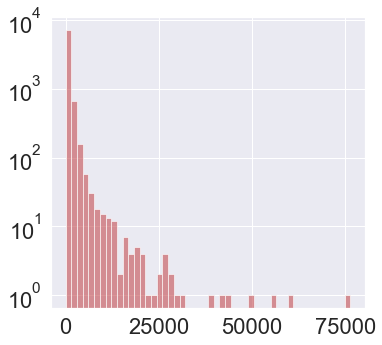

In [520]:
plt.figure(figsize=(5, 5))
plt.hist(data['min_payments'], 50, color='r', alpha=0.6)
plt.yscale('log')

298
227
71


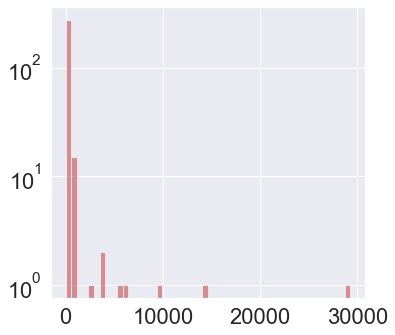

In [521]:
plt.figure(figsize=(5, 5))
df = data[data['min_payments'].isnull()]
print(len(df))
print(len(df[df['payments']==0]))
print(len(df[df['payments']!=0]))
plt.hist(df['payments'], 50, color='r', alpha=0.6)
plt.yscale('log')

71


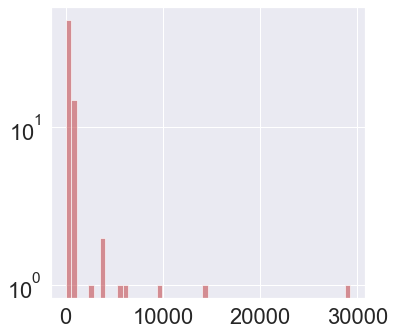

In [522]:
plt.figure(figsize=(5, 5))
df = data[data['min_payments'].isnull() & data['payments']!=0]
print(len(df))
plt.hist(df['payments'], 50, color='r', alpha=0.6)
plt.yscale('log')

2250


Text(0, 0.5, 'min_payments')

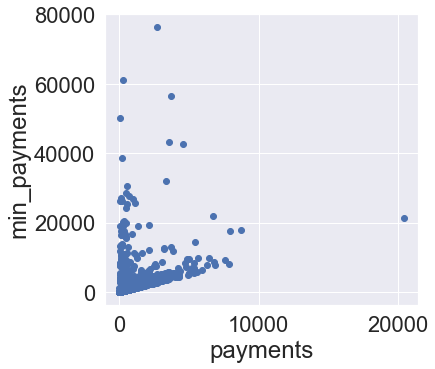

In [523]:
df = data.dropna()
print(len(df[df['payments'] < df['min_payments']]))
plt.figure(figsize=(5, 5))
plt.scatter(
                x=df[df['payments'] < df['min_payments']].payments, 
                y=df[df['payments'] < df['min_payments']].min_payments, 
                cmap='tab10',
                alpha=1
                )
plt.xlabel('payments')
plt.ylabel('min_payments')

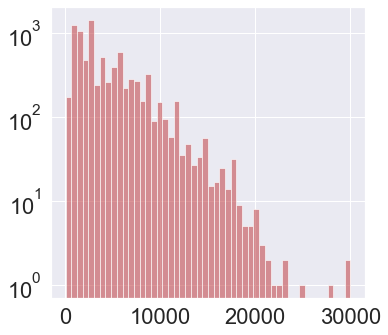

In [524]:
plt.figure(figsize=(5, 5))
plt.hist(data['credit_limit'], 50, color='r', alpha=0.6)
plt.yscale('log')

In [525]:
data_noID = data.copy()
data_noID = data_noID.drop(columns=['customer_id'])

## Imputation

In [526]:
from sklearn.impute import KNNImputer

imputer = KNNImputer(n_neighbors=5, weights="distance")
imputed_data = imputer.fit_transform(data_noID)

In [527]:
data_imp = pd.DataFrame(imputed_data, columns = data_noID.columns)

In [528]:
data.describe()

,balance_account,purchases_amount,paid_advance,full_purchases,balance_frequency_update,installments,purchases_frequency,full_purchases_frequency,purchases_installments_frequency,cash_advance_frequency,nr_cash_advances,nr_purchases,credit_limit,fixed_rate_period,payments,min_payments,full_payment_prc
count,8500.000000,8500.000000,8500.000000,8500.000000,8500.000000,8500.000000,8500.000000,8500.000000,8500.000000,8500.000000,8500.000000,8500.000000,8499.000000,8500.000000,8500.000000,8202.000000,8500.000000
mean,1565.941403,999.561312,973.508540,588.165365,0.876272,411.708492,0.489383,0.201940,0.363796,0.135288,3.253647,14.677059,4485.848704,11.516118,1721.250989,865.594683,0.152587
std,2090.513302,2154.189460,2078.539061,1669.466184,0.237517,910.142440,0.401075,0.297756,0.397162,0.200892,6.854883,25.001561,3629.804040,1.339121,2893.200899,2389.297977,0.291505
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,50.000000,6.000000,0.000000,0.019163,0.000000
25%,126.318369,39.000000,0.000000,0.000000,0.875000,0.000000,0.083333,0.000000,0.000000,0.000000,0.000000,1.000000,1500.000000,12.000000,381.893717,168.712104,0.000000
50%,869.046468,360.000000,0.000000,37.400000,1.000000,89.000000,0.500000,0.083333,0.166667,0.000000,0.000000,7.000000,3000.000000,12.000000,851.146953,310.399040,0.000000
75%,2053.674410,1105.897500,1113.726110,570.410000,1.000000,466.725000,0.916667,0.285714,0.750000,0.222222,4.000000,17.000000,6500.000000,12.000000,1897.014052,826.426929,0.142857
max,19043.138560,49039.570000,47137.211760,40761.250000,1.000000,22500.000000,1.000000,1.000000,1.000000,1.500000,123.000000,358.000000,30000.000000,12.000000,50721.483360,76406.207520,1.000000


2485


balance_account                     0
purchases_amount                    0
paid_advance                        0
full_purchases                      0
balance_frequency_update            0
installments                        0
purchases_frequency                 0
full_purchases_frequency            0
purchases_installments_frequency    0
cash_advance_frequency              0
nr_cash_advances                    0
nr_purchases                        0
credit_limit                        0
fixed_rate_period                   0
payments                            0
min_payments                        0
full_payment_prc                    0
dtype: int64

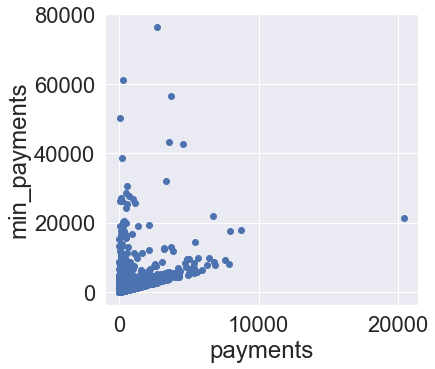

In [529]:
print(len(data_imp[data_imp['payments'] < data_imp['min_payments']]))
plt.figure(figsize=(5, 5))
plt.scatter(
                x=data_imp[data_imp['payments'] < data_imp['min_payments']].payments, 
                y=data_imp[data_imp['payments'] < data_imp['min_payments']].min_payments, 
                cmap='tab10',
                alpha=1
                )
plt.xlabel('payments')
plt.ylabel('min_payments')

data_imp.isna().sum()

/Users/andrea/anaconda3/envs/propy_env/lib/python3.7/site-packages/numpy/lib/histograms.py:839: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
/Users/andrea/anaconda3/envs/propy_env/lib/python3.7/site-packages/numpy/lib/histograms.py:840: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


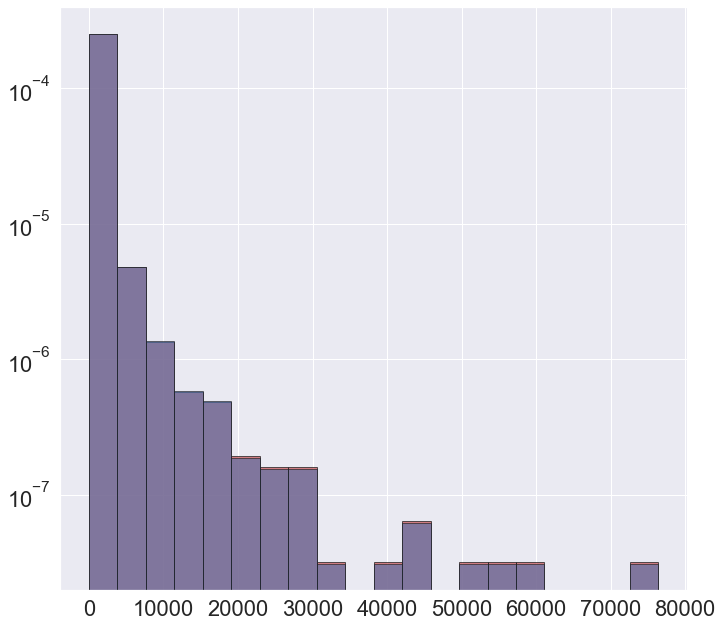

In [530]:
plt.figure(figsize=(10, 10))
_, bins, _ = plt.hist(data['min_payments'], 20, color='r', edgecolor='k', alpha=0.7, density=True)
plt.hist(data_imp['min_payments'], bins=bins, color='b', edgecolor='k', alpha=0.6, density=True)
plt.yscale('log')

## Plotting variables

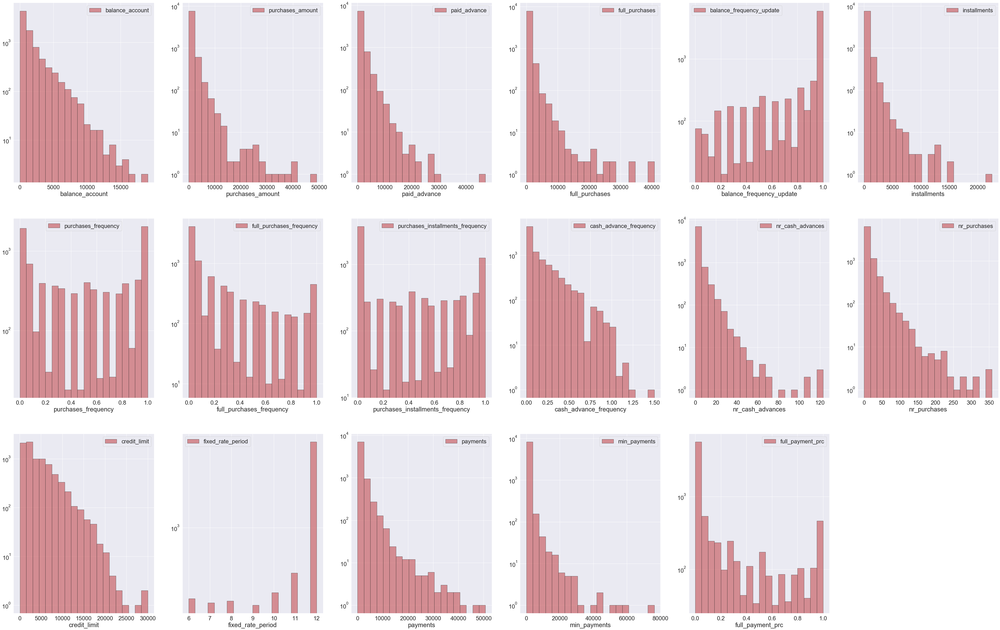

In [531]:
plot_distrib(data=data_imp, ncols=6, nrows=3, figsize=(60, 40))

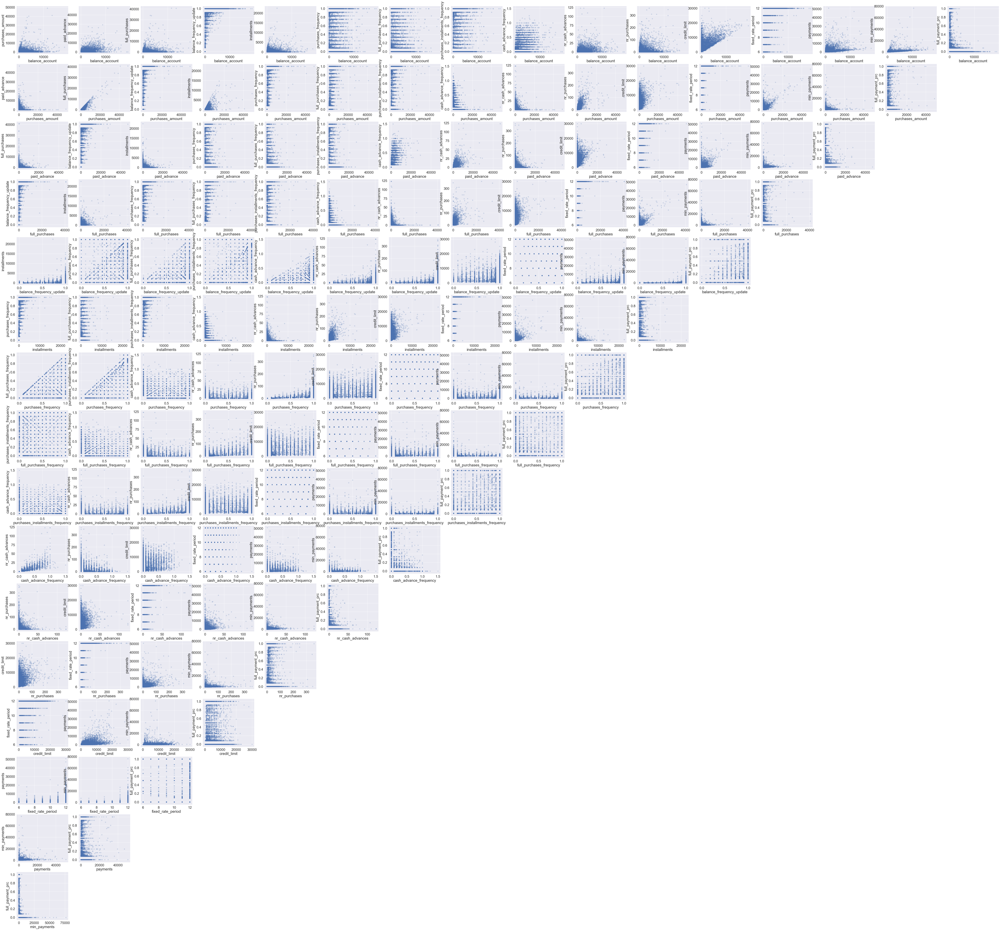

In [532]:
plot_2d(data_imp, data_imp.columns, (100, 100))

227
227
0
227
0
2251
2485


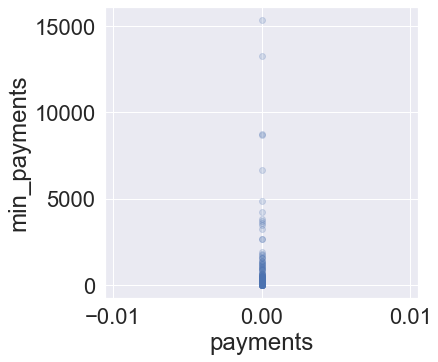

In [533]:
plt.figure(figsize=(5, 5))
df = data_imp[data_imp['payments'] == 0]
plt.scatter(
    x=df['payments'],
    y=df['min_payments'],
    cmap='tab10',
    alpha=0.2
)
plt.xlabel('payments')
plt.ylabel('min_payments')

print(len(df['payments']))
print(len(data_imp[data_imp['payments'] == 0]))
print(len(data_imp[data_imp['min_payments'] == 0]))
print(len(data[data['payments'] == 0]))
print(len(data[data['min_payments'] == 0]))

print(len(data[data['payments'] < data['min_payments']]))
print(len(data_imp[data_imp['payments'] < data_imp['min_payments']]))

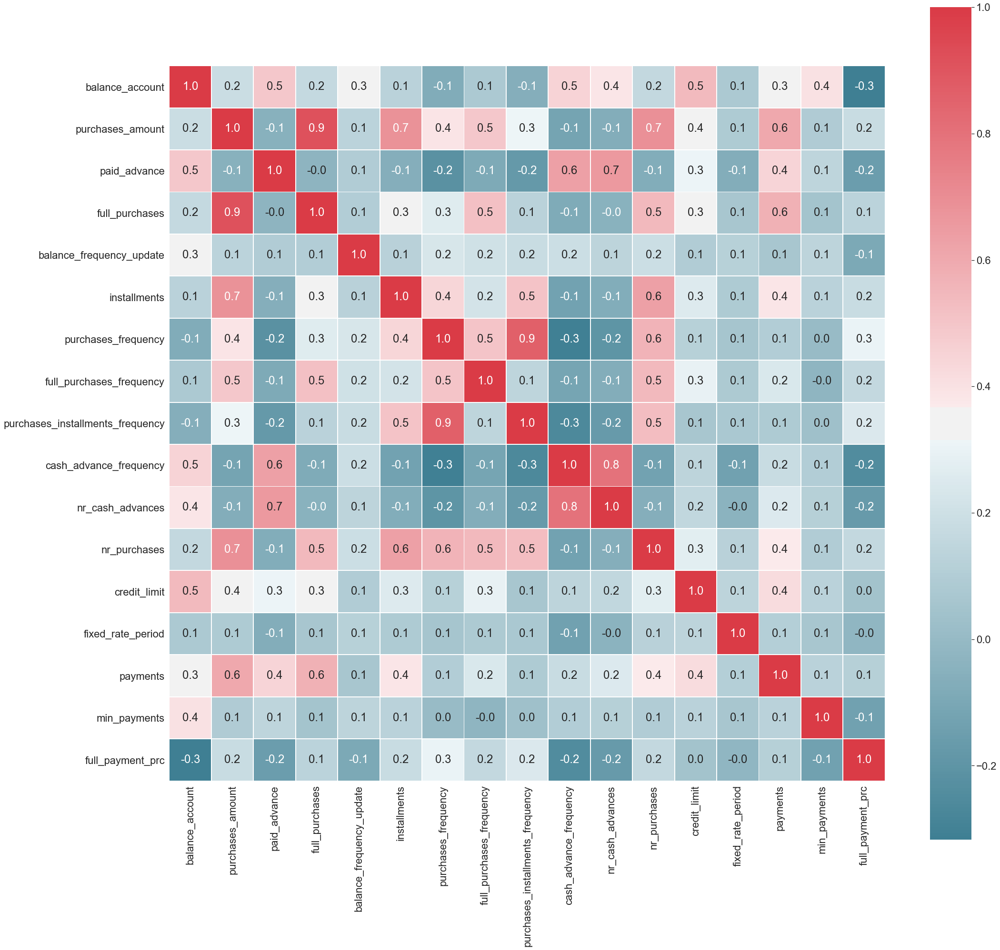

In [534]:
functions.correlation_heatmap(data_imp)

## Scaling

In [535]:
data_imp.columns

Index(['balance_account', 'purchases_amount', 'paid_advance', 'full_purchases',
       'balance_frequency_update', 'installments', 'purchases_frequency',
       'full_purchases_frequency', 'purchases_installments_frequency',
       'cash_advance_frequency', 'nr_cash_advances', 'nr_purchases',
       'credit_limit', 'fixed_rate_period', 'payments', 'min_payments',
       'full_payment_prc'],
      dtype='object')

### Standard Scaling

In [536]:
scaler = StandardScaler()
data_imp_scaled_g = data_imp.copy()
data_imp_scaled_g = pd.DataFrame(scaler.fit_transform(data_imp_scaled_g), columns=data_imp.columns)

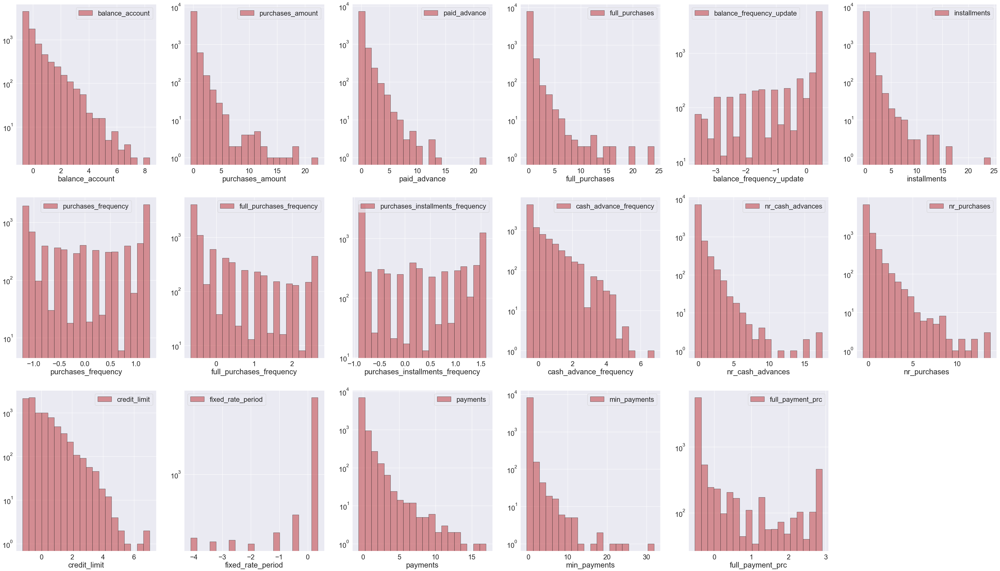

In [537]:
plot_distrib(data=data_imp_scaled_g, ncols=6, nrows=3, figsize=(50, 30))

### MinMax Scaler

In [538]:
data_imp.describe()

,balance_account,purchases_amount,paid_advance,full_purchases,balance_frequency_update,installments,purchases_frequency,full_purchases_frequency,purchases_installments_frequency,cash_advance_frequency,nr_cash_advances,nr_purchases,credit_limit,fixed_rate_period,payments,min_payments,full_payment_prc
count,8500.000000,8500.000000,8500.000000,8500.000000,8500.000000,8500.000000,8500.000000,8500.000000,8500.000000,8500.000000,8500.000000,8500.000000,8500.000000,8500.000000,8500.000000,8500.000000,8500.000000
mean,1565.941403,999.561312,973.508540,588.165365,0.876272,411.708492,0.489383,0.201940,0.363796,0.135288,3.253647,14.677059,4485.585989,11.516118,1721.250989,854.159378,0.152587
std,2090.513302,2154.189460,2078.539061,1669.466184,0.237517,910.142440,0.401075,0.297756,0.397162,0.200892,6.854883,25.001561,3629.671307,1.339121,2893.200899,2365.193677,0.291505
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,50.000000,6.000000,0.000000,0.019163,0.000000
25%,126.318369,39.000000,0.000000,0.000000,0.875000,0.000000,0.083333,0.000000,0.000000,0.000000,0.000000,1.000000,1500.000000,12.000000,381.893717,165.825432,0.000000
50%,869.046468,360.000000,0.000000,37.400000,1.000000,89.000000,0.500000,0.083333,0.166667,0.000000,0.000000,7.000000,3000.000000,12.000000,851.146953,299.898497,0.000000
75%,2053.674410,1105.897500,1113.726110,570.410000,1.000000,466.725000,0.916667,0.285714,0.750000,0.222222,4.000000,17.000000,6500.000000,12.000000,1897.014052,804.724525,0.142857
max,19043.138560,49039.570000,47137.211760,40761.250000,1.000000,22500.000000,1.000000,1.000000,1.000000,1.500000,123.000000,358.000000,30000.000000,12.000000,50721.483360,76406.207520,1.000000


In [539]:
data_imp.columns

Index(['balance_account', 'purchases_amount', 'paid_advance', 'full_purchases',
       'balance_frequency_update', 'installments', 'purchases_frequency',
       'full_purchases_frequency', 'purchases_installments_frequency',
       'cash_advance_frequency', 'nr_cash_advances', 'nr_purchases',
       'credit_limit', 'fixed_rate_period', 'payments', 'min_payments',
       'full_payment_prc'],
      dtype='object')

In [540]:
transfm_cols = ['balance_account', 'purchases_amount', 'paid_advance', 'full_purchases',
                'installments', 'cash_advance_frequency', 'nr_cash_advances', 'nr_purchases', 'credit_limit', 'fixed_rate_period', 'payments', 'min_payments']
data_imp_scaled = data_imp.copy()

In [541]:
scaler = MinMaxScaler()
data_imp_scaled[transfm_cols] = scaler.fit_transform(data_imp_scaled[transfm_cols].to_numpy())

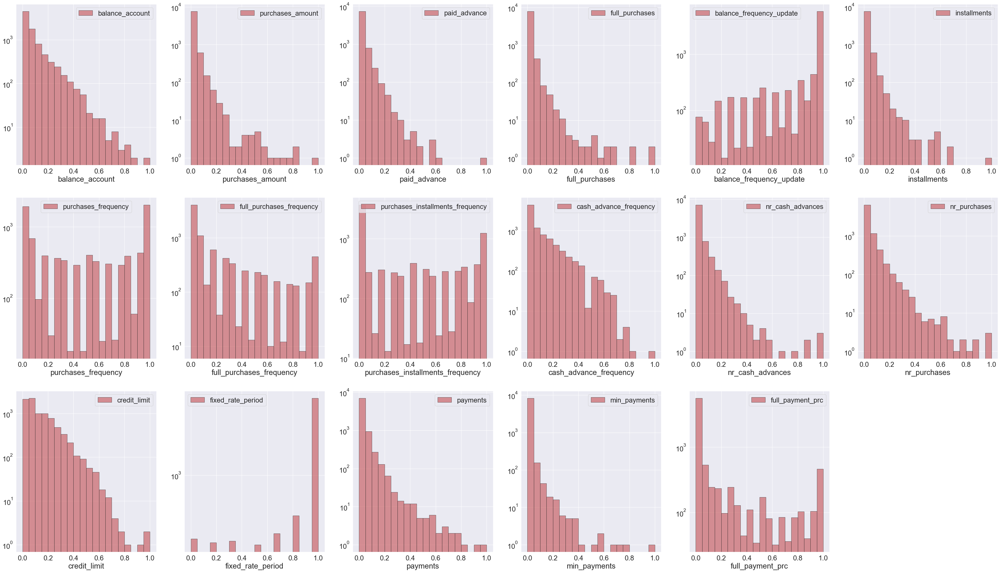

In [542]:
plot_distrib(data=data_imp_scaled, ncols=6, nrows=3, figsize=(50, 30))

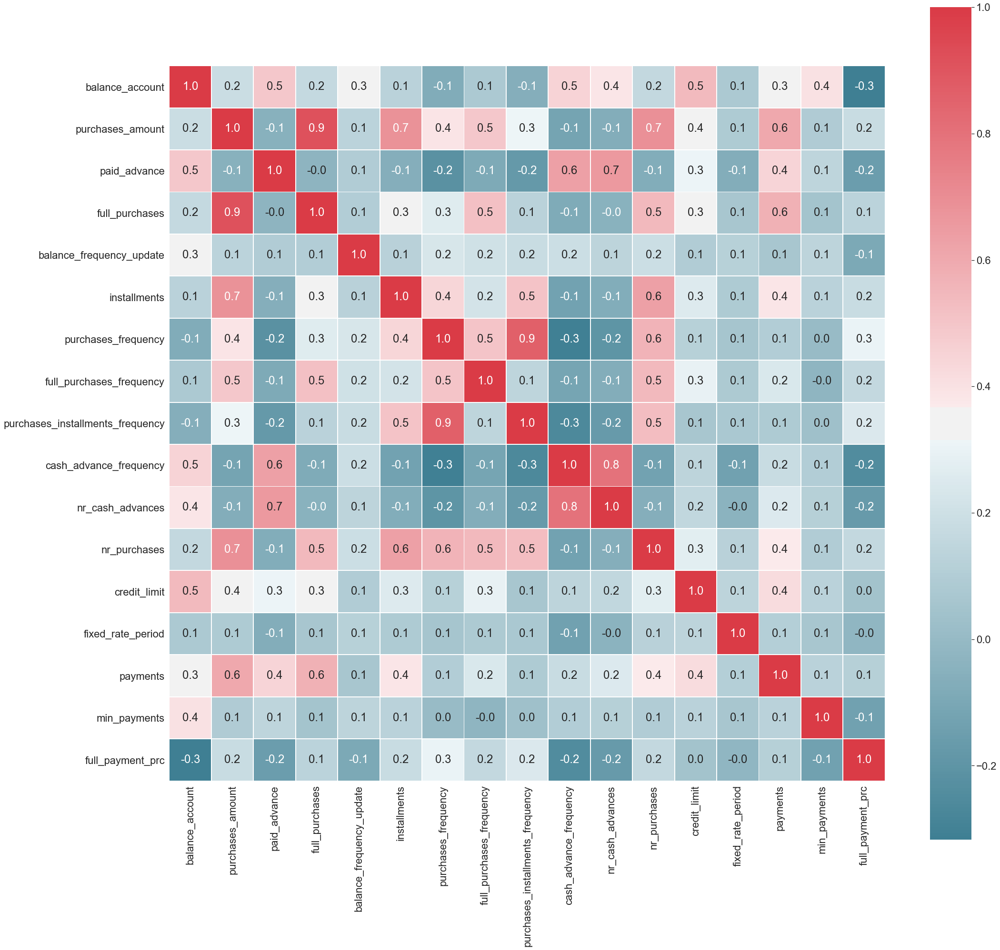

In [543]:
functions.correlation_heatmap(data_imp_scaled)

## K-means

In [544]:
cluster_range = list(range(2, 10))

### Silhouette

For n_clusters = 2 the average silhouette_score is : 0.3863852322101593
For n_clusters = 3 the average silhouette_score is : 0.37189388275146484
For n_clusters = 4 the average silhouette_score is : 0.3205740749835968
For n_clusters = 5 the average silhouette_score is : 0.31481683254241943
For n_clusters = 6 the average silhouette_score is : 0.3216805160045624
For n_clusters = 7 the average silhouette_score is : 0.3371502757072449
For n_clusters = 8 the average silhouette_score is : 0.32452264428138733
For n_clusters = 9 the average silhouette_score is : 0.334155410528183


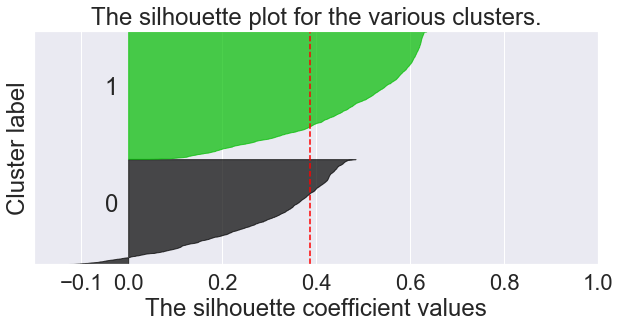

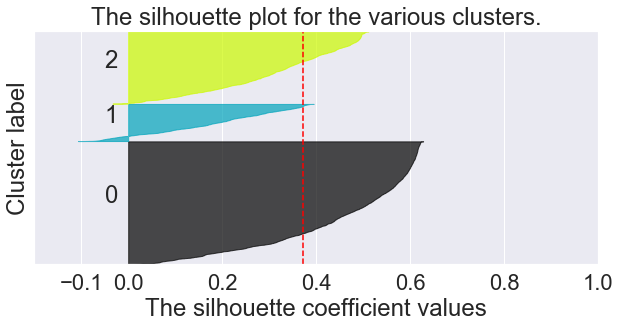

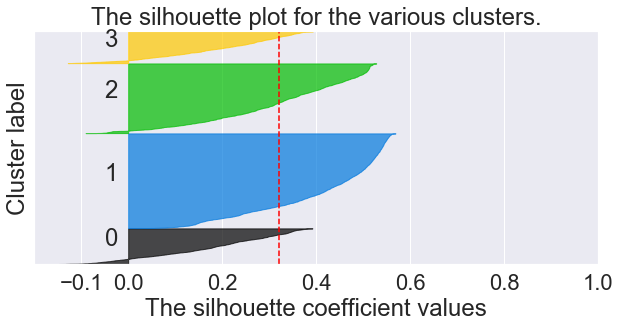

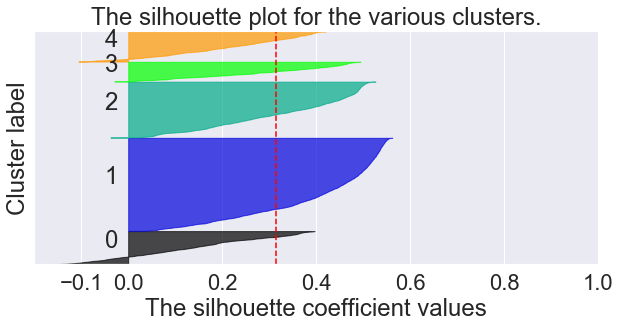

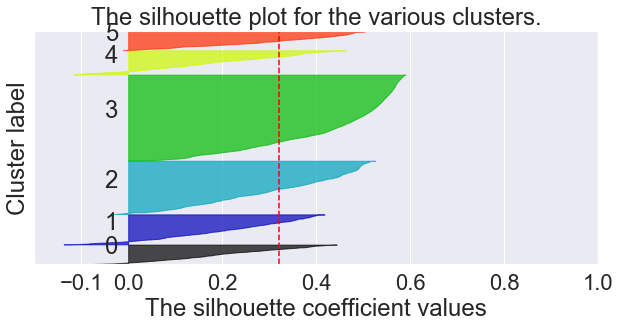

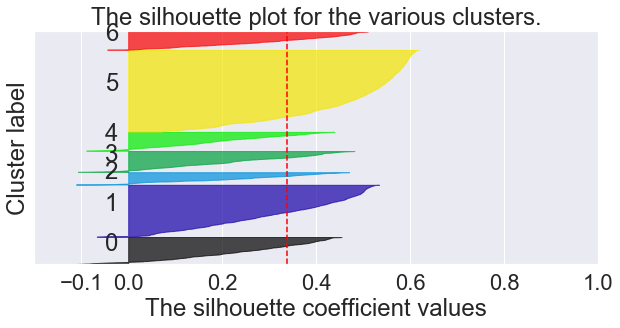

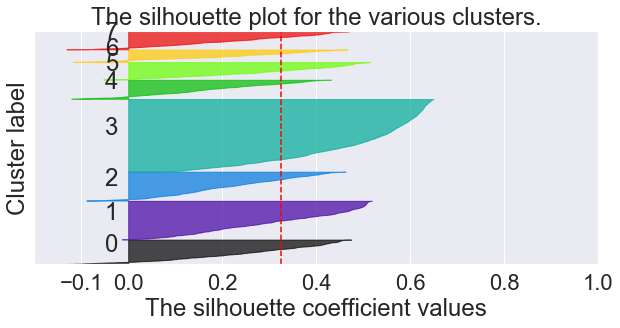

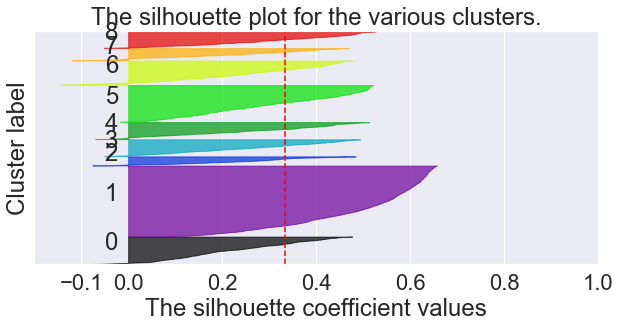

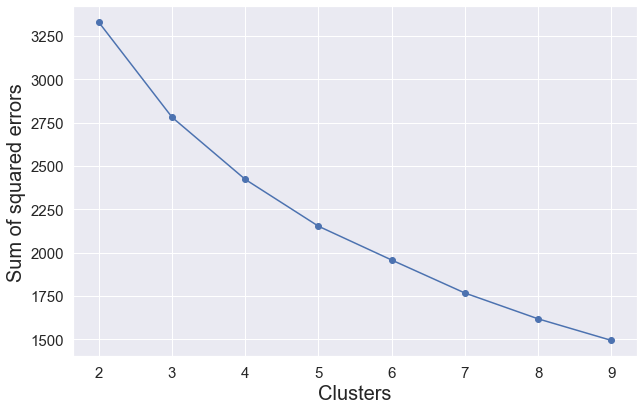

In [545]:
make_silhouette_plot(cluster_range, data_imp_scaled, 'kmeans_min_max_scaled')

### Clusterer 4

In [620]:
clusterer = KMeans(n_clusters=4, init='k-means++', random_state=10)
cluster_labels = clusterer.fit_predict(data_imp_scaled)

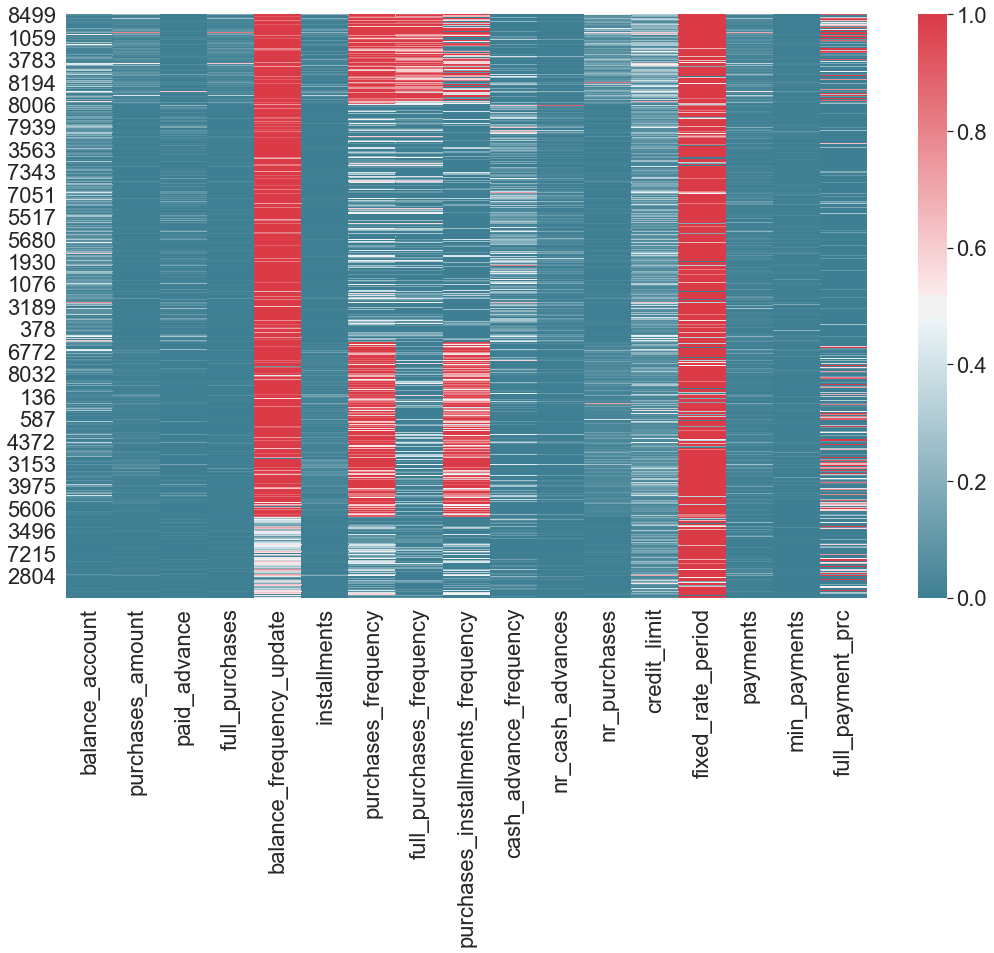

In [547]:
sns.set(font_scale=2)
data_w_cls = plot_map_clusters(data_imp_scaled, cluster_labels, 'heatmap_4clusters_kmeans')

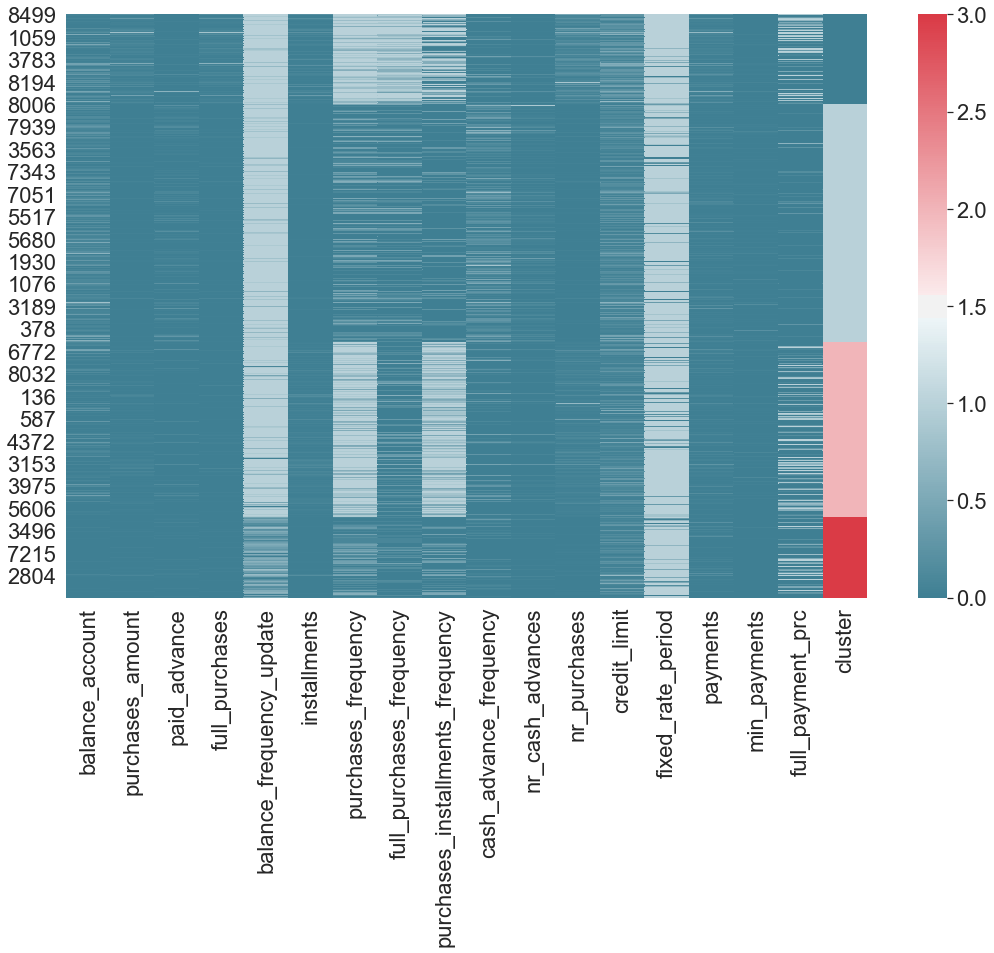

In [548]:
sns.set(font_scale=2)
data_w_cls = plot_map_clusters2(data_imp_scaled, cluster_labels, 'heatmap_4clusters_kmeans_2')

In [549]:
data_w_cls.columns

Index(['balance_account', 'purchases_amount', 'paid_advance', 'full_purchases',
       'balance_frequency_update', 'installments', 'purchases_frequency',
       'full_purchases_frequency', 'purchases_installments_frequency',
       'cash_advance_frequency', 'nr_cash_advances', 'nr_purchases',
       'credit_limit', 'fixed_rate_period', 'payments', 'min_payments',
       'full_payment_prc', 'cluster'],
      dtype='object')

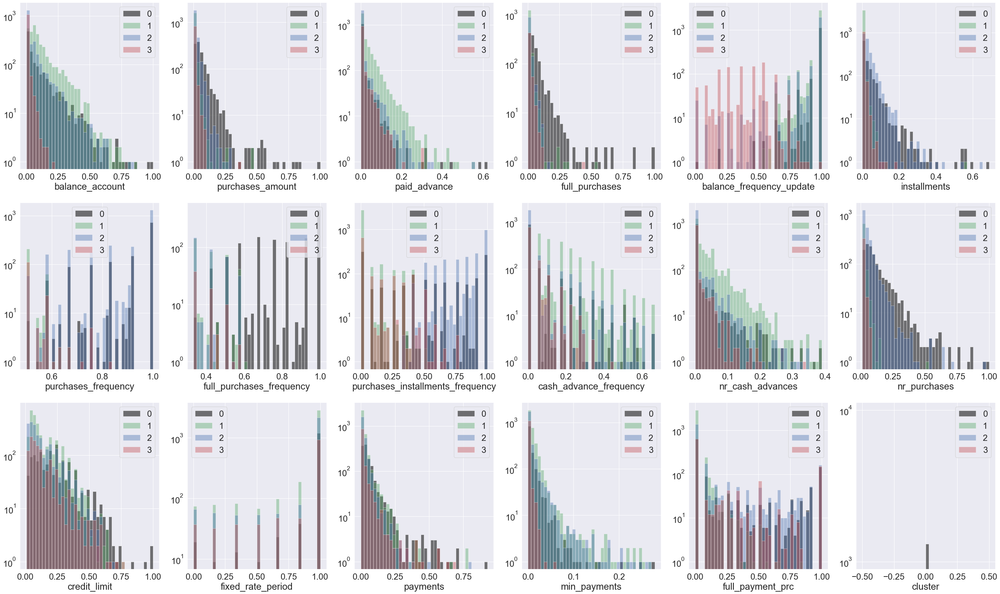

In [550]:
plot_numeric_distrib(data_w_cls, 'cluster', [0, 1, 2, 3], ['k', 'g', 'b', 'r'], ncols=6, nrows=3, figsize=(40,25), filename='features_distrib_4clusters_kmeans')

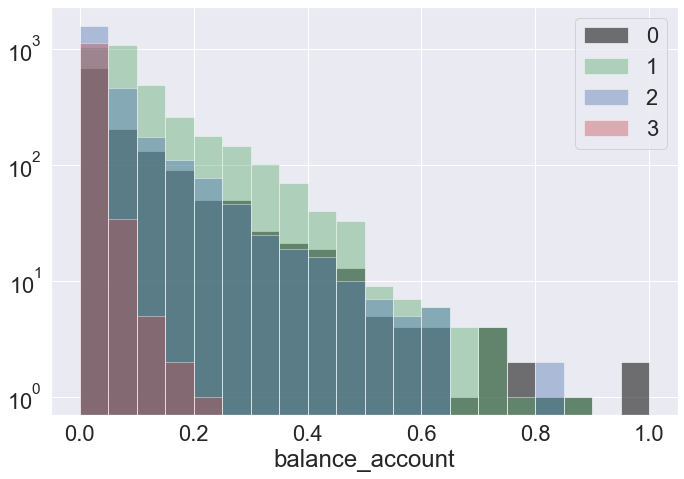

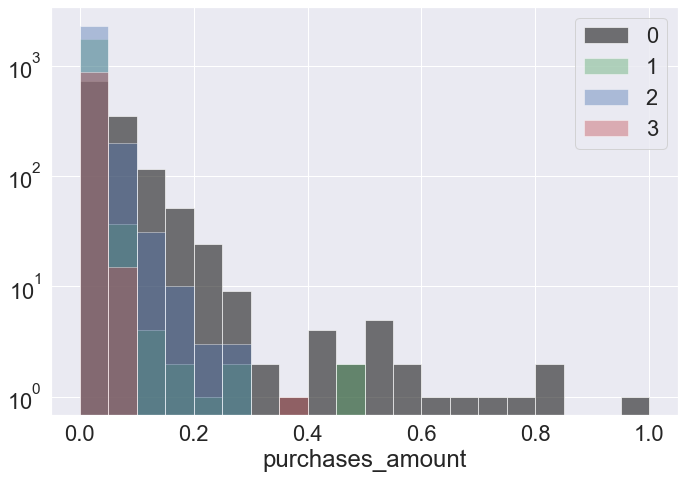

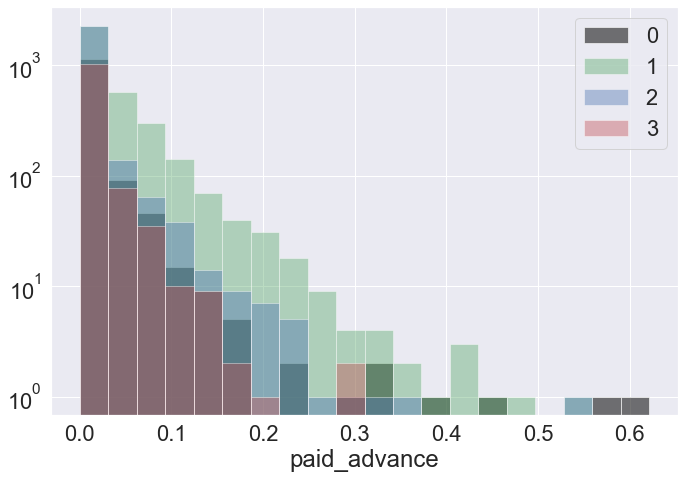

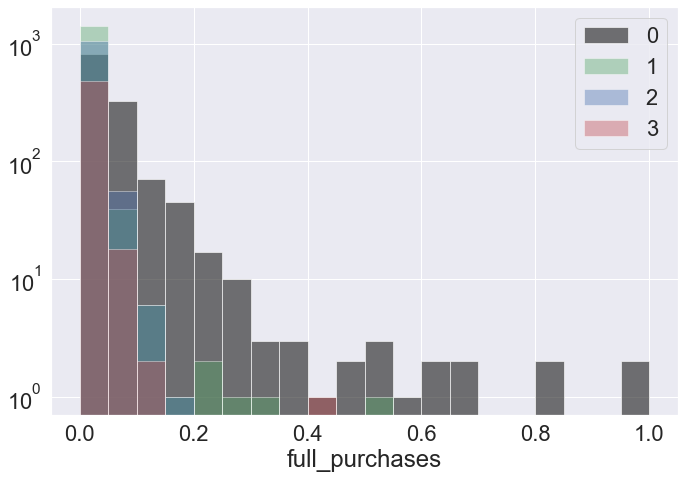

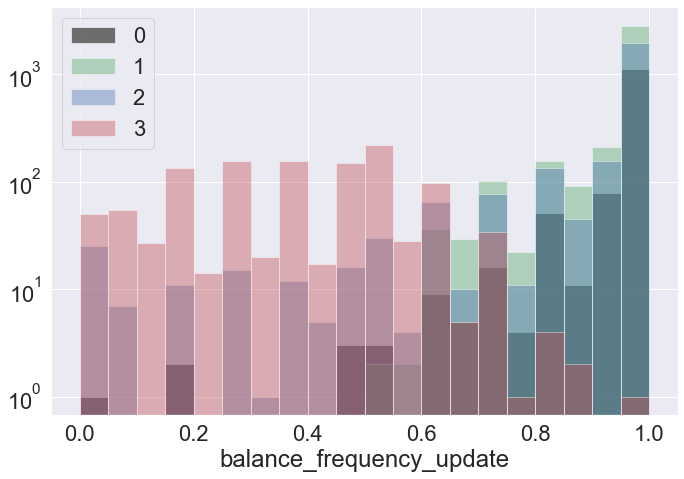

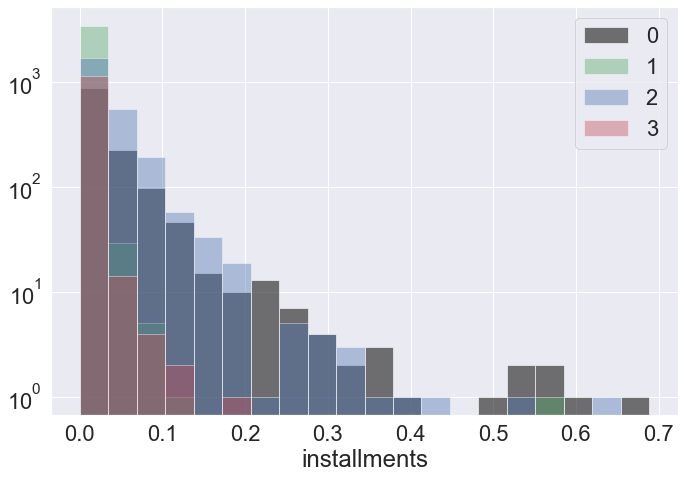

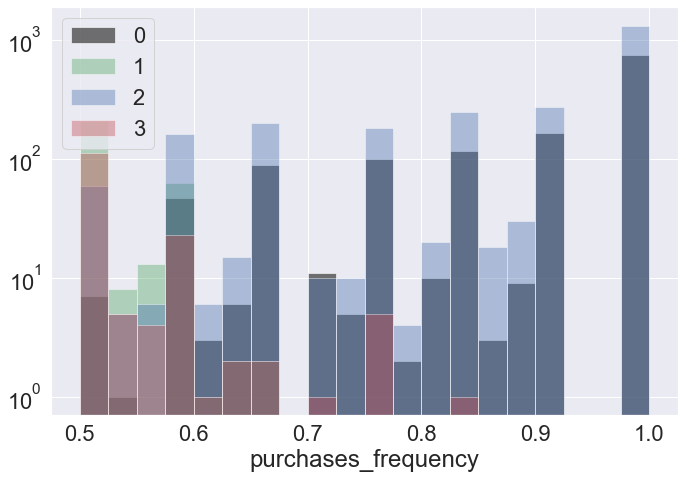

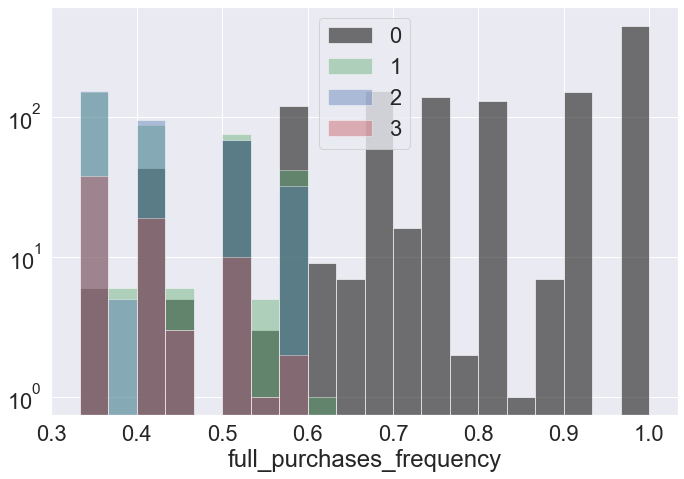

KeyboardInterrupt: 

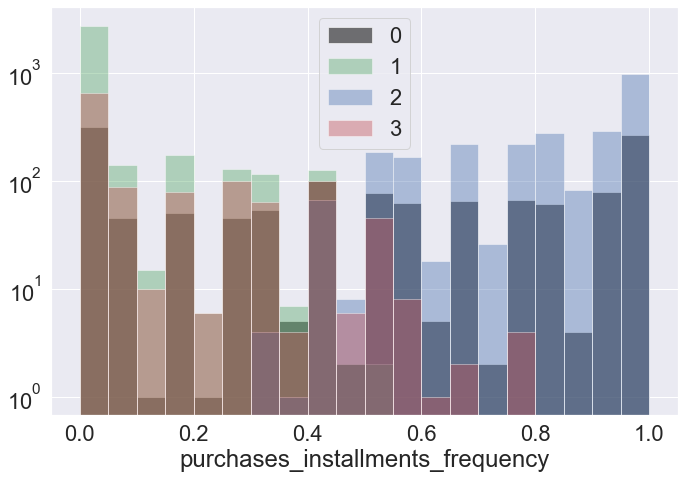

In [551]:
plot_single_numeric_distrib(data_w_cls, 'cluster', [0, 1, 2, 3], ['k', 'g', 'b', 'r'], ncols=6, nrows=3, figsize=(10,7), filename='feature_distrib_4clusters_kmeans')

No handles with labels found to put in legend.


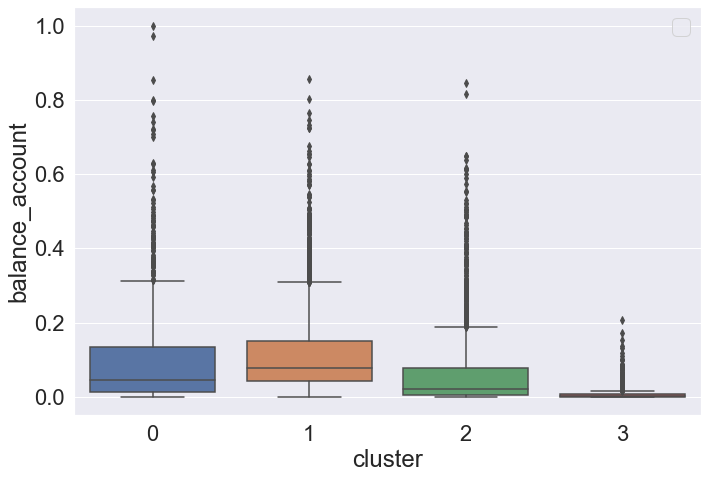

No handles with labels found to put in legend.


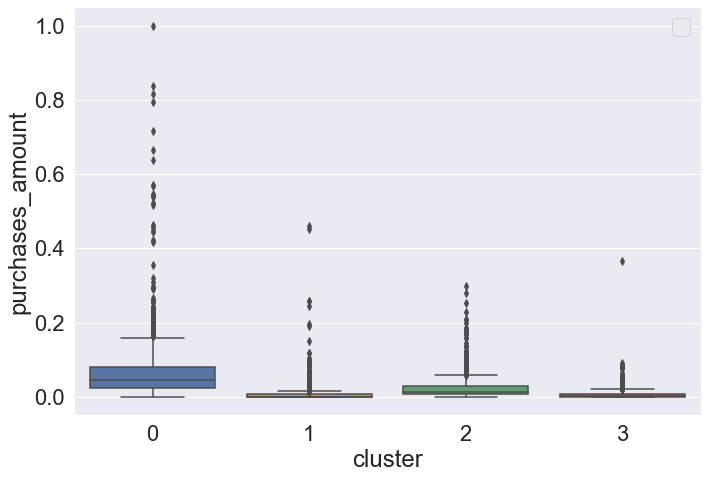

No handles with labels found to put in legend.


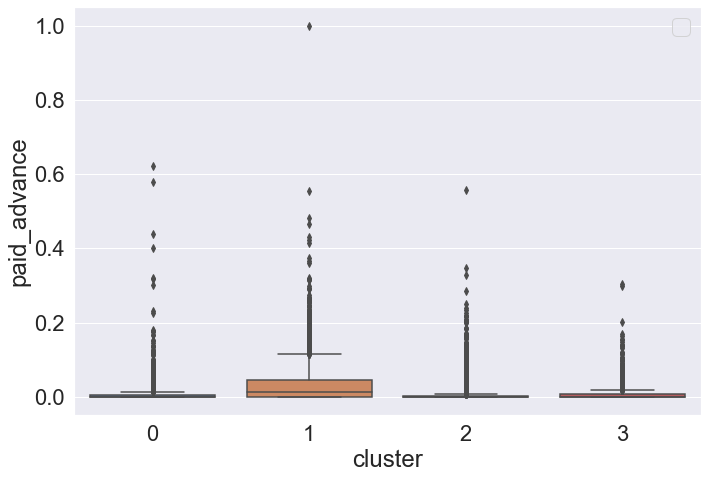

No handles with labels found to put in legend.


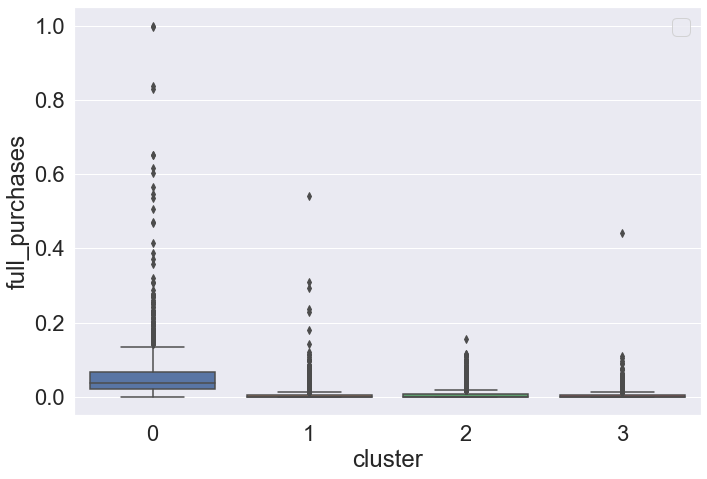

No handles with labels found to put in legend.


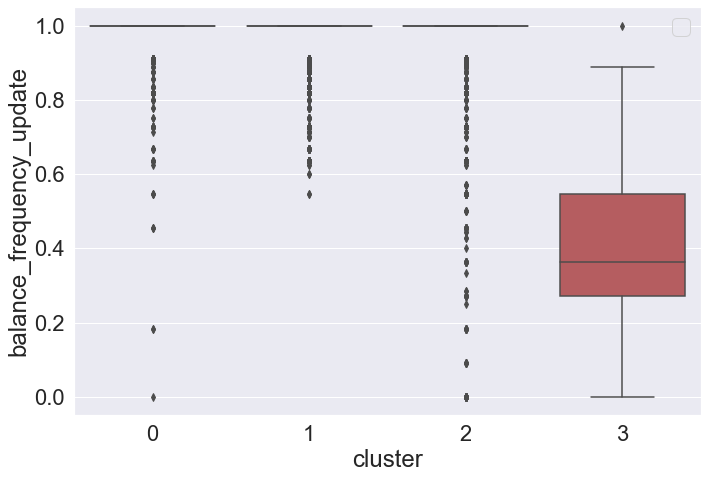

No handles with labels found to put in legend.


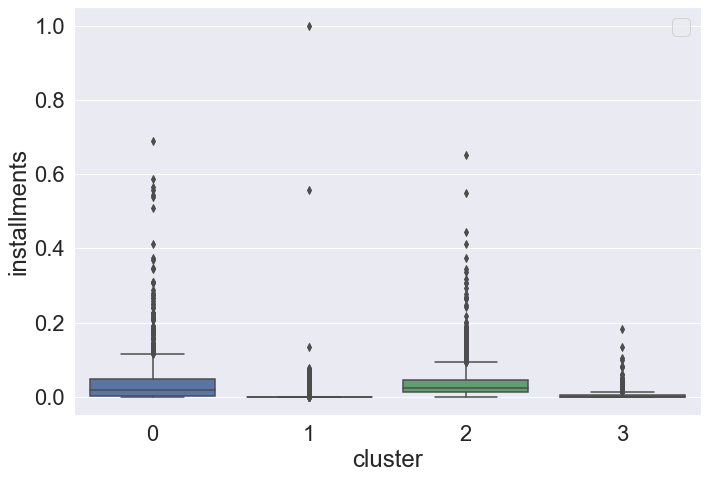

No handles with labels found to put in legend.


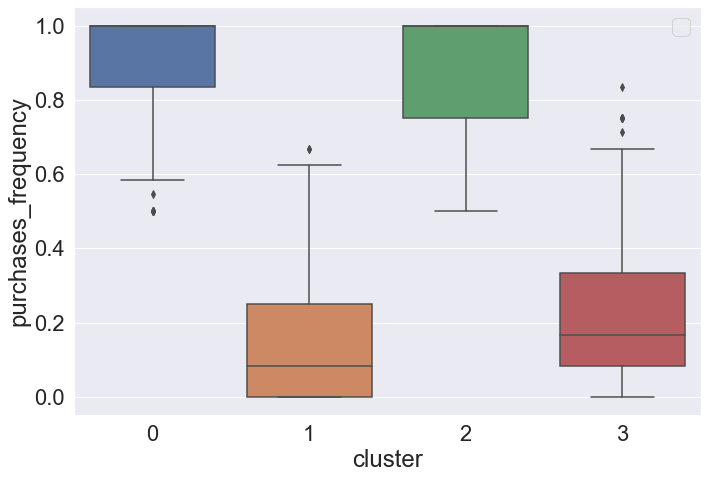

No handles with labels found to put in legend.


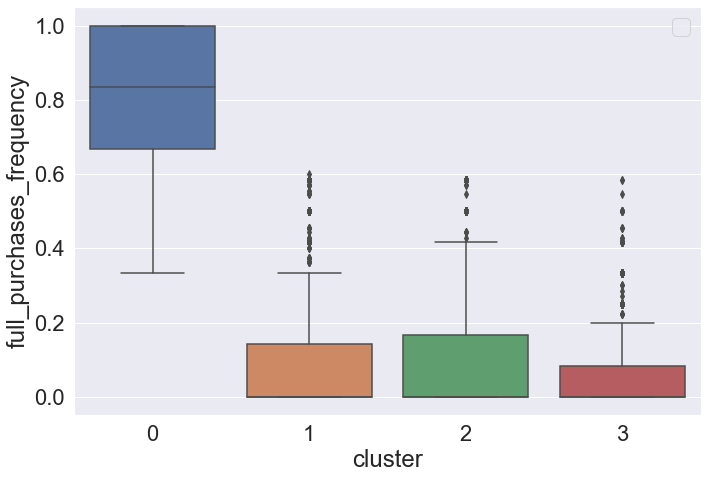

No handles with labels found to put in legend.


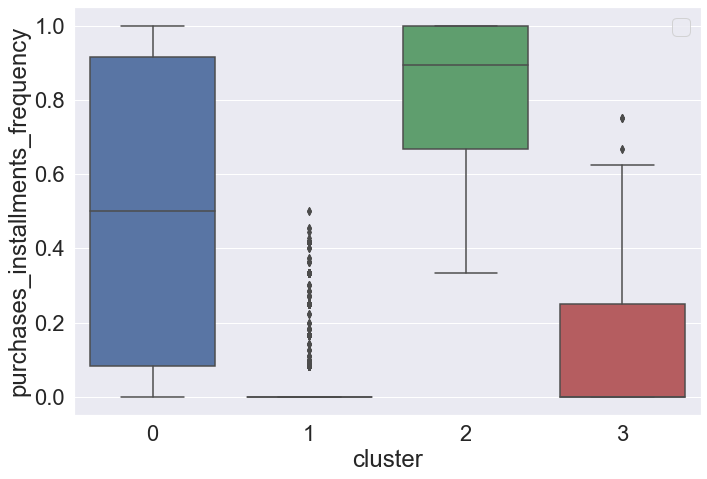

No handles with labels found to put in legend.


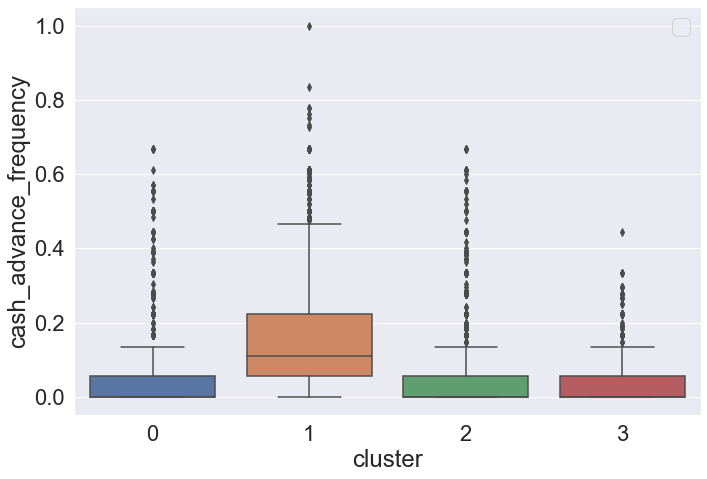

No handles with labels found to put in legend.


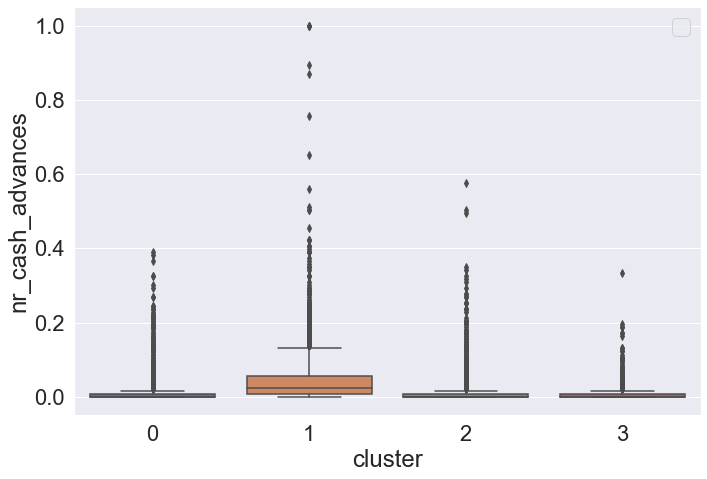

No handles with labels found to put in legend.


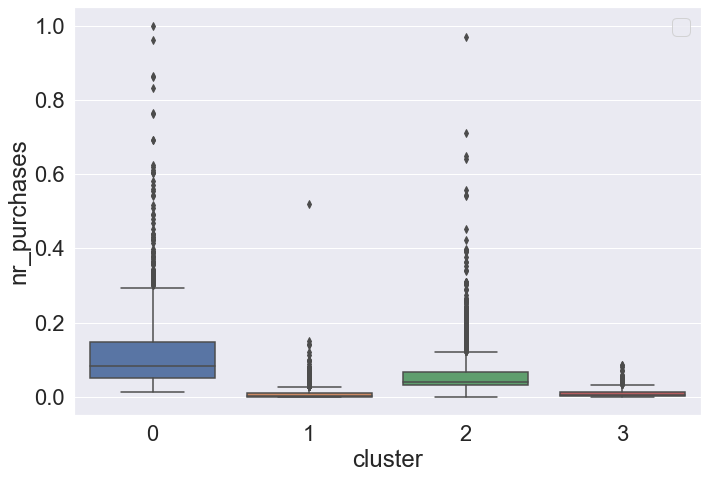

No handles with labels found to put in legend.


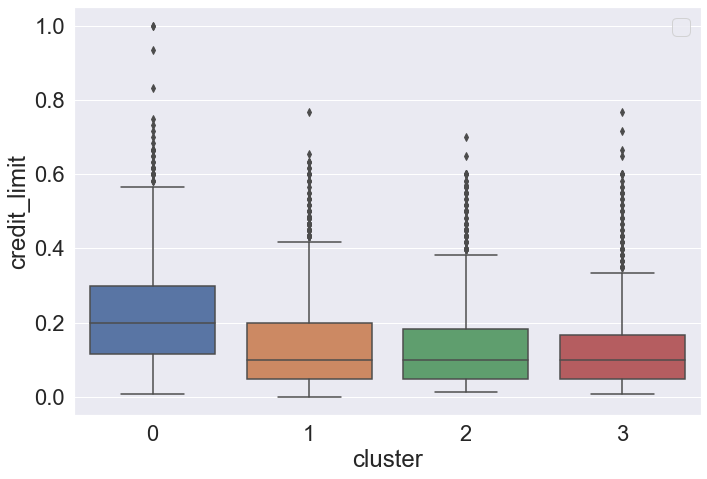

No handles with labels found to put in legend.


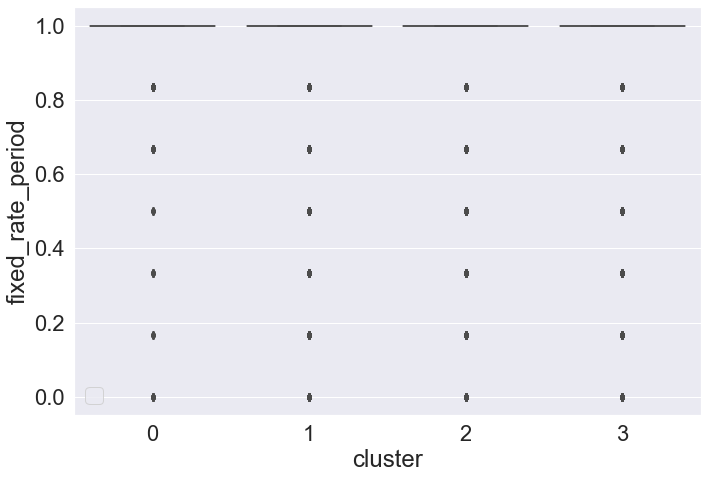

No handles with labels found to put in legend.


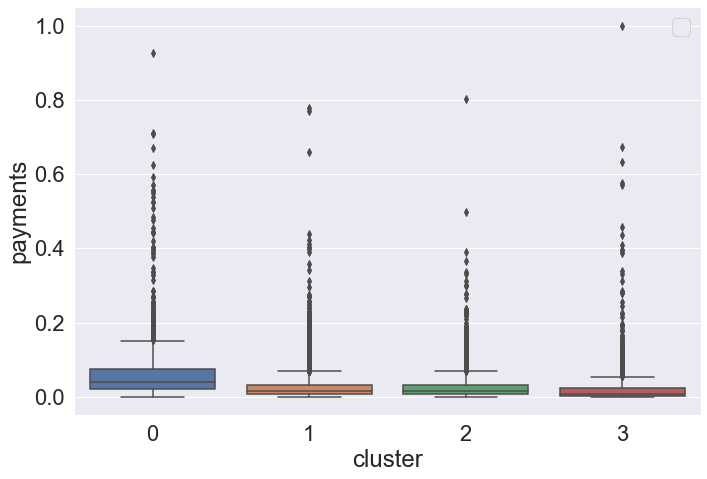

No handles with labels found to put in legend.


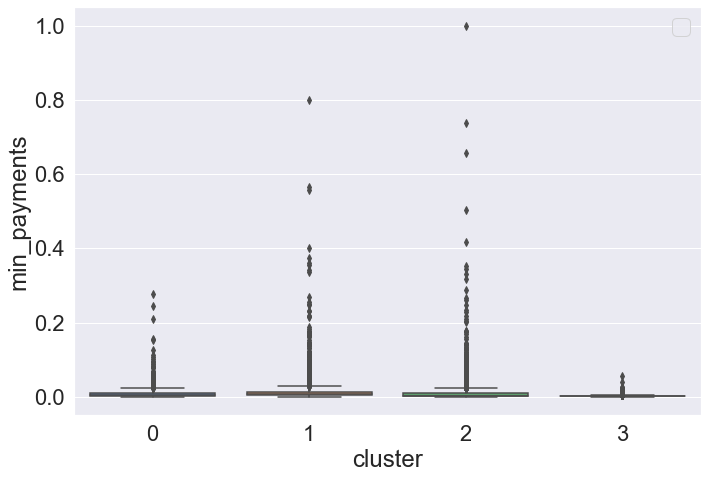

No handles with labels found to put in legend.


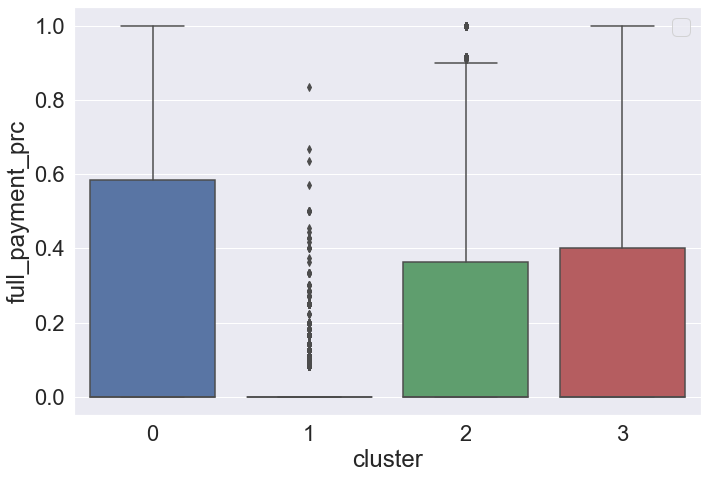

In [553]:
#variables=['balance_account','balance_frequency_update', 'purchases_frequency','full_purchases_frequency', 'purchases_installments_frequency','cash_advance_frequency','nr_purchases','full_payment_prc']
variables=['balance_account', 'purchases_amount', 'paid_advance', 'full_purchases',
       'balance_frequency_update', 'installments', 'purchases_frequency',
       'full_purchases_frequency', 'purchases_installments_frequency',
       'cash_advance_frequency', 'nr_cash_advances', 'nr_purchases',
       'credit_limit', 'fixed_rate_period', 'payments', 'min_payments',
       'full_payment_prc']
plot_box_sns(data_w_cls, variables, 'cluster', (10,7), '4clusters_kmeans')

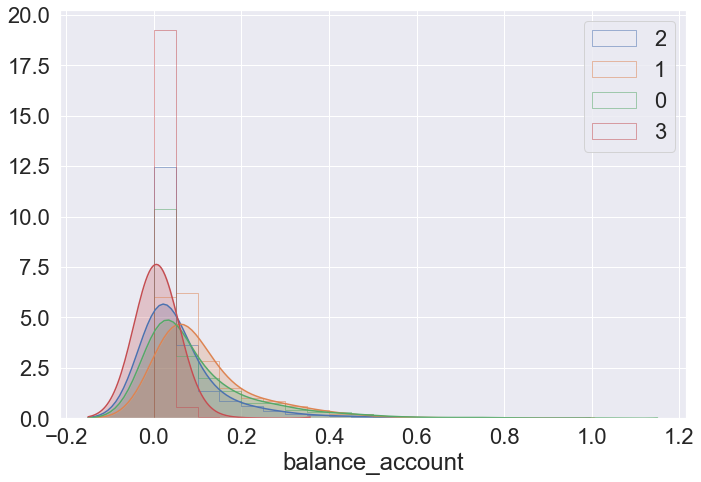

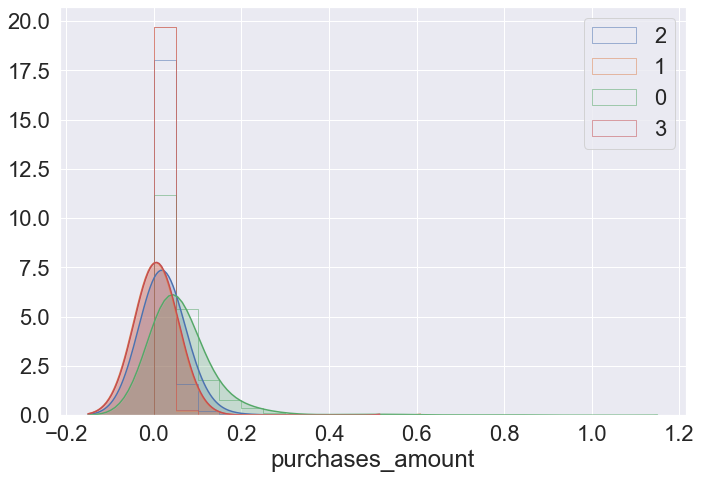

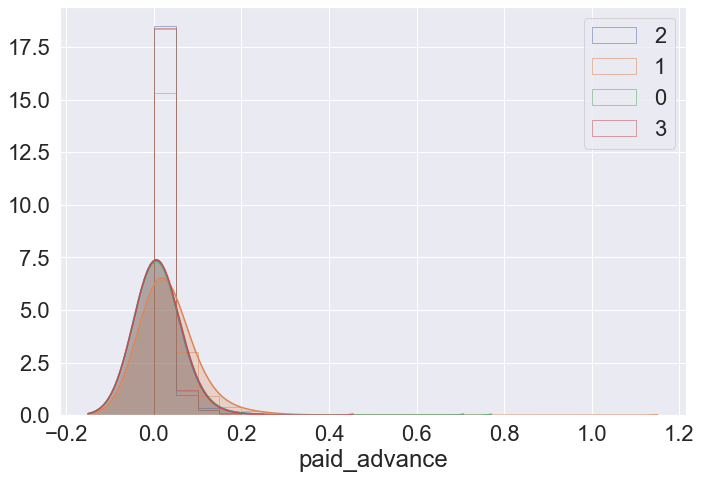

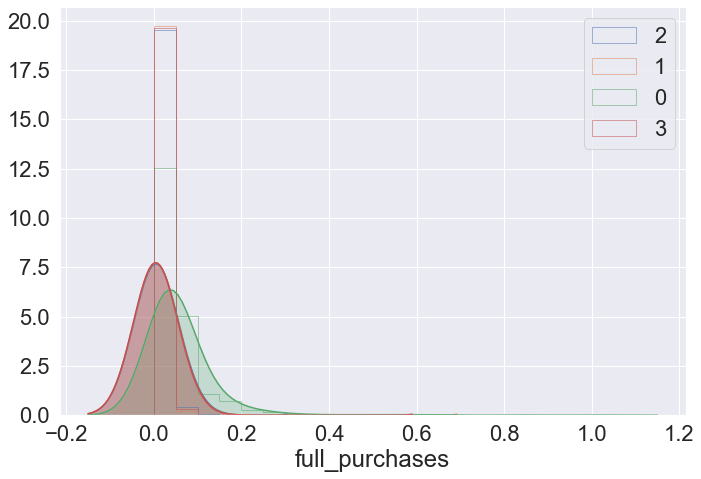

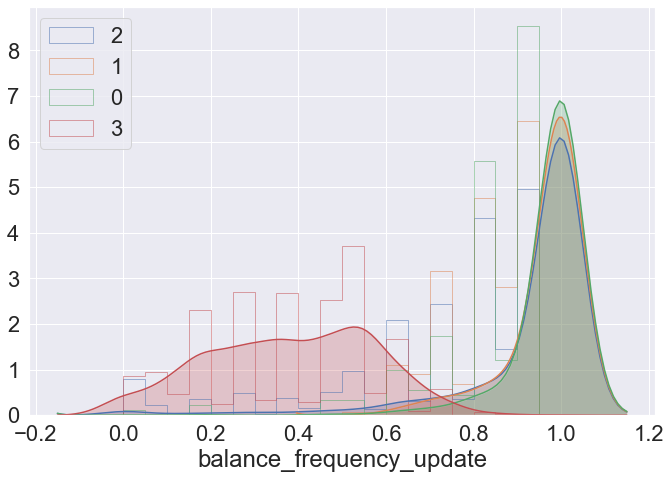

...

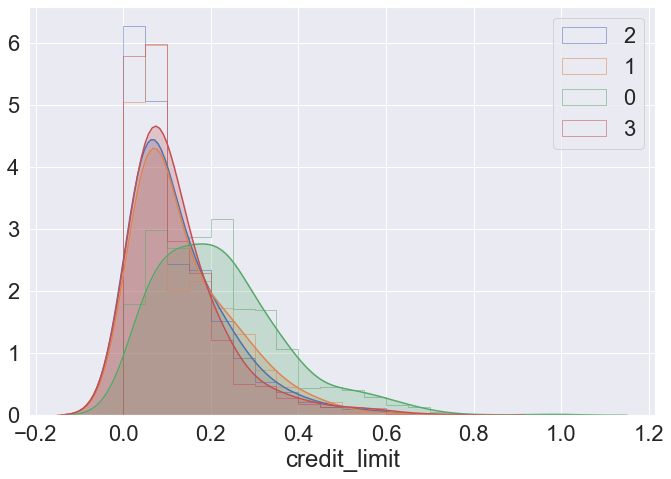

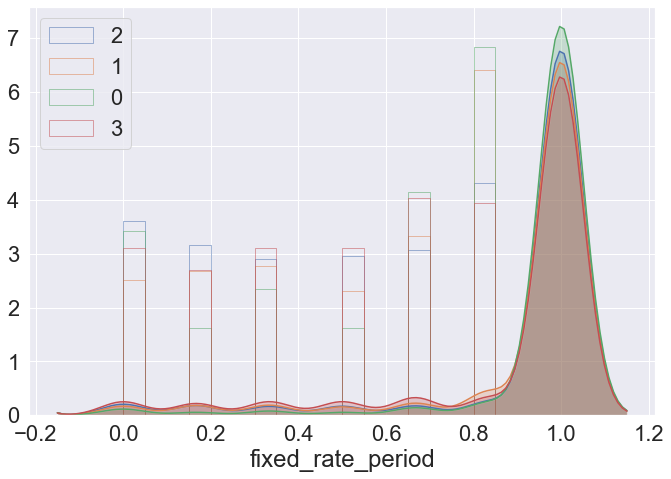

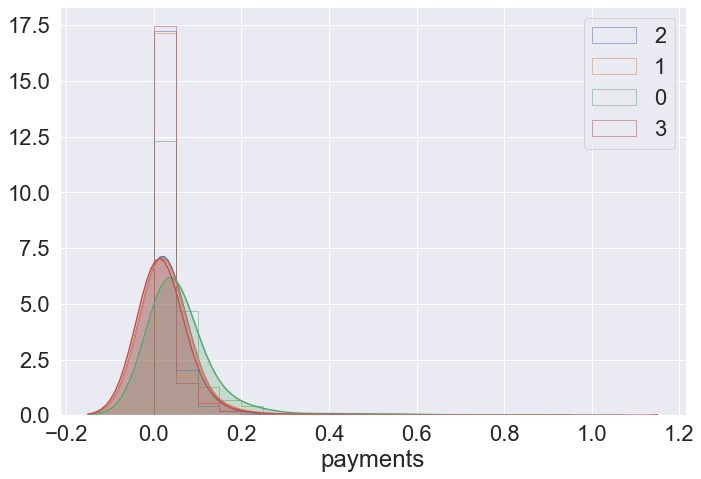

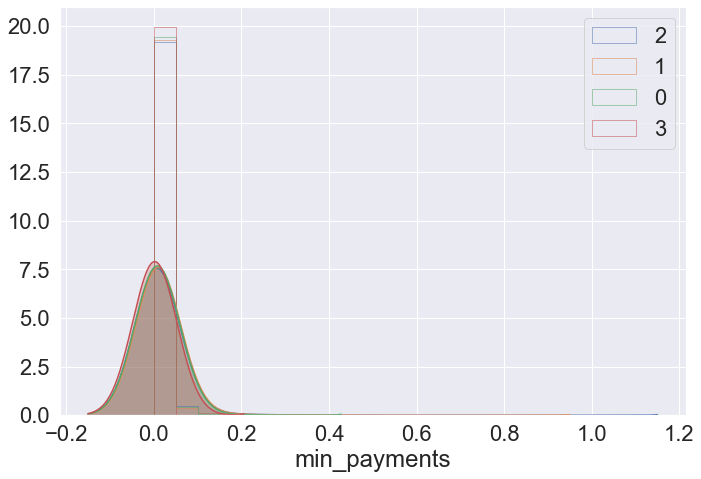

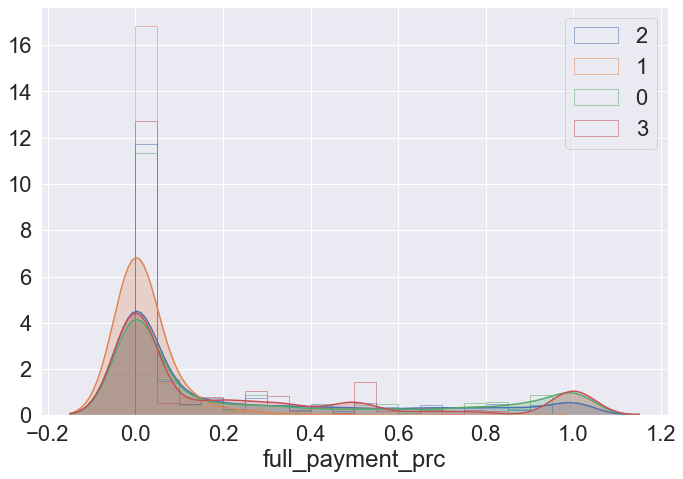

In [554]:
plot_numeric_distrib_sns(data_w_cls, variables, 'cluster', (10,7), '4clusters_kmeans')

In [555]:
df_centers = pd.DataFrame(clusterer.cluster_centers_, columns=data_imp_scaled.columns)
df_centers

,balance_account,purchases_amount,paid_advance,full_purchases,balance_frequency_update,installments,purchases_frequency,full_purchases_frequency,purchases_installments_frequency,cash_advance_frequency,nr_cash_advances,nr_purchases,credit_limit,fixed_rate_period,payments,min_payments,full_payment_prc
0,0.099869,0.066958,0.013330,0.059789,0.974237,0.037622,0.906215,0.809382,0.498813,0.060588,0.018330,0.121525,0.224135,0.958970,0.064120,0.009982,0.280765
1,0.115092,0.006048,0.033667,0.005904,0.966641,0.002493,0.138562,0.089451,0.049642,0.150464,0.043885,0.007695,0.139889,0.915682,0.029358,0.013684,0.023060
2,0.062410,0.022104,0.011165,0.006774,0.929170,0.035936,0.881594,0.102704,0.830224,0.049244,0.014745,0.059457,0.130146,0.918363,0.027708,0.012426,0.221159
3,0.008105,0.007049,0.010917,0.005700,0.381918,0.005049,0.207274,0.072857,0.126066,0.033723,0.009328,0.009392,0.126592,0.888032,0.027347,0.002342,0.244103


In [688]:
def plot_2d_corr_features_centers(df, featuresx, featuresy, centers_df, figsize, filename):
    for featx, featy in zip(featuresx, featuresy):
        plt.figure(figsize=figsize)
        ax = plt.subplot(1, 1, 1)
#         ax.scatter(
#              x=df[featx],
#              y=df[featy],
#              c=df['cluster'],
#              cmap='tab10',
#              alpha=0.2
#          )
#         sns.kdeplot(data=df[featx], data2=df[featy],
#                  cmap="Reds", shade=True, shade_lowest=False)
        sns.scatterplot(x=df[featx],y=df[featy],hue=df['cluster'],palette='Set1')#,alpha=0.2)
        for c in range((centers_df.shape)[0]):
            ax.scatter(centers_df.loc[c, featx], centers_df.loc[c, featy], marker='o',c="white", alpha=1, s=200, edgecolor='k')
            ax.scatter(centers_df.loc[c, featx], centers_df.loc[c, featy], marker='$%d$' % c, alpha=1, s=50, edgecolor='k')
        plt.xlabel(featx)
        plt.ylabel(featy)
        plt.savefig(f'./figures/scatter_{featx}_{featy}_{filename}.png', bbox_inches="tight")
    plt.show()

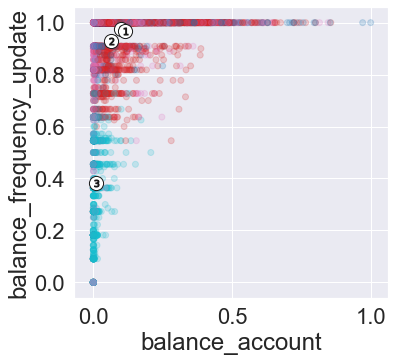

In [566]:
plot_2d_corr_features_centers(data_w_cls, ['balance_account'], ['balance_frequency_update'], df_centers, (5, 5), '4clusters_kmeans')

In [687]:
def plot_2d_corr_features_centers2(df, featx, featuresy, centers_df, figsize, filename):
    fig = plt.figure(figsize=figsize)
    i = 0 
    for featy in featuresy:
        ax = fig.add_subplot(4, 4, i+1)
#         ax.scatter(
#              x=df[featx],
#              y=df[featy],
#              c=df['cluster'],
#              cmap='tab10',
#              alpha=0.2
#          )
        sns.scatterplot(x=df[featx],y=df[featy],hue=df['cluster'],palette='Set1')#,alpha=0.2)
        for c in range((centers_df.shape)[0]):
            ax.scatter(centers_df.loc[c, featx], centers_df.loc[c, featy], marker='o',c="white", alpha=1, s=200, edgecolor='k')
            ax.scatter(centers_df.loc[c, featx], centers_df.loc[c, featy], marker='$%d$' % c, alpha=1, s=50, edgecolor='k')
        plt.xlabel(featx)
        plt.ylabel(featy)
        i = i+1
    fig.tight_layout()
    plt.savefig(f'./figures/scatter_vs_{featx}_{filename}.png', bbox_inches="tight")
    plt.show()

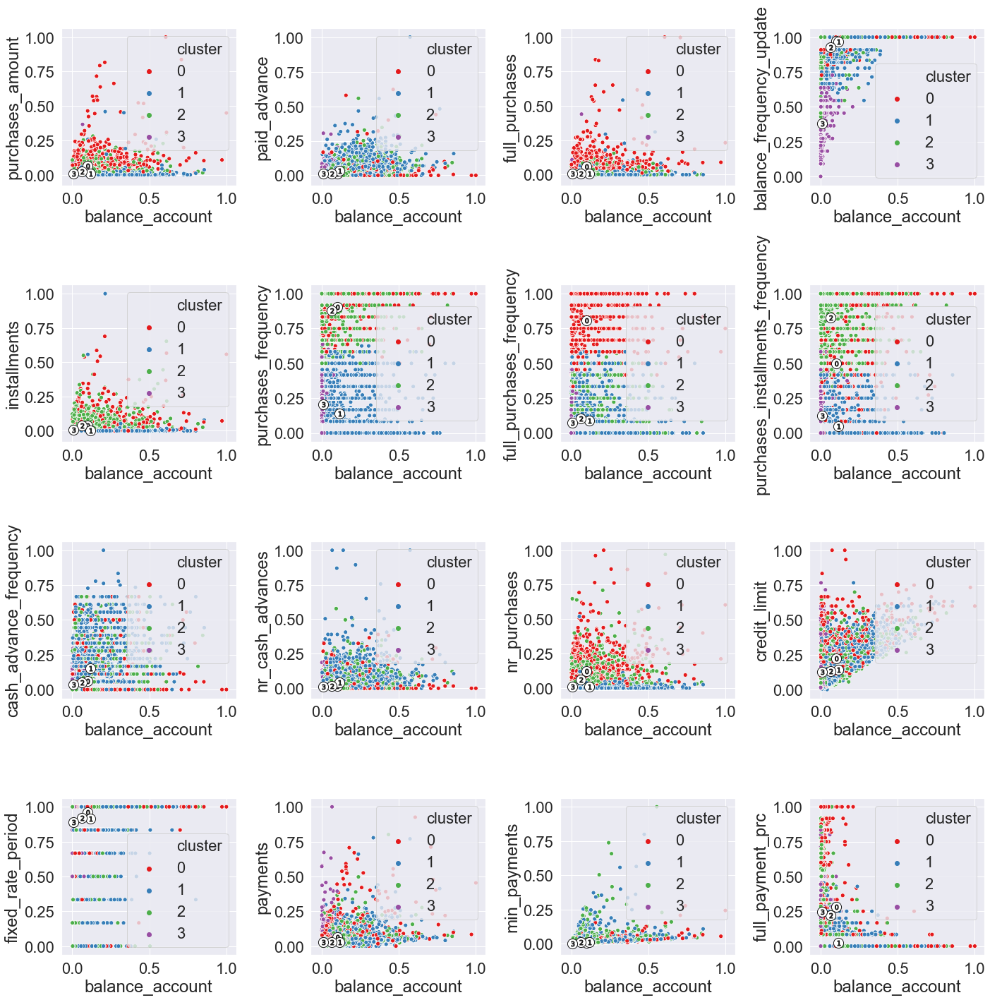

In [575]:
var_x = 'balance_account'
var_y = ['purchases_amount', 'paid_advance', 'full_purchases',
       'balance_frequency_update', 'installments', 'purchases_frequency',
       'full_purchases_frequency', 'purchases_installments_frequency',
       'cash_advance_frequency', 'nr_cash_advances', 'nr_purchases',
       'credit_limit', 'fixed_rate_period', 'payments', 'min_payments',
       'full_payment_prc']

plot_2d_corr_features_centers2(data_w_cls, var_x, var_y, df_centers, (20, 20), '4clusters_kmeans')

In [652]:
def plot_2d_corr_features_nocenters(data, labels, featx, featuresy, figsize, filename):
    
    df = data.copy()
    df['cluster'] = labels
    
    fig = plt.figure(figsize=figsize)
    i = 0 
    for featy in featuresy:
        ax = fig.add_subplot(4, 4, i+1)
#         ax.scatter(
#              x=df[featx],
#              y=df[featy],
#              c=df['cluster'],
#              cmap='tab10',
#              alpha=0.2
#          )
        sns.scatterplot(x=df[featx],y=df[featy],hue=df['cluster'],palette='Set1',alpha=0.2)
        plt.xlabel(featx)
        plt.ylabel(featy)
        i = i+1
    fig.tight_layout()
    plt.savefig(f'./figures/scatter_notnorm_vs_{featx}_{filename}.png', bbox_inches="tight")
    plt.show()

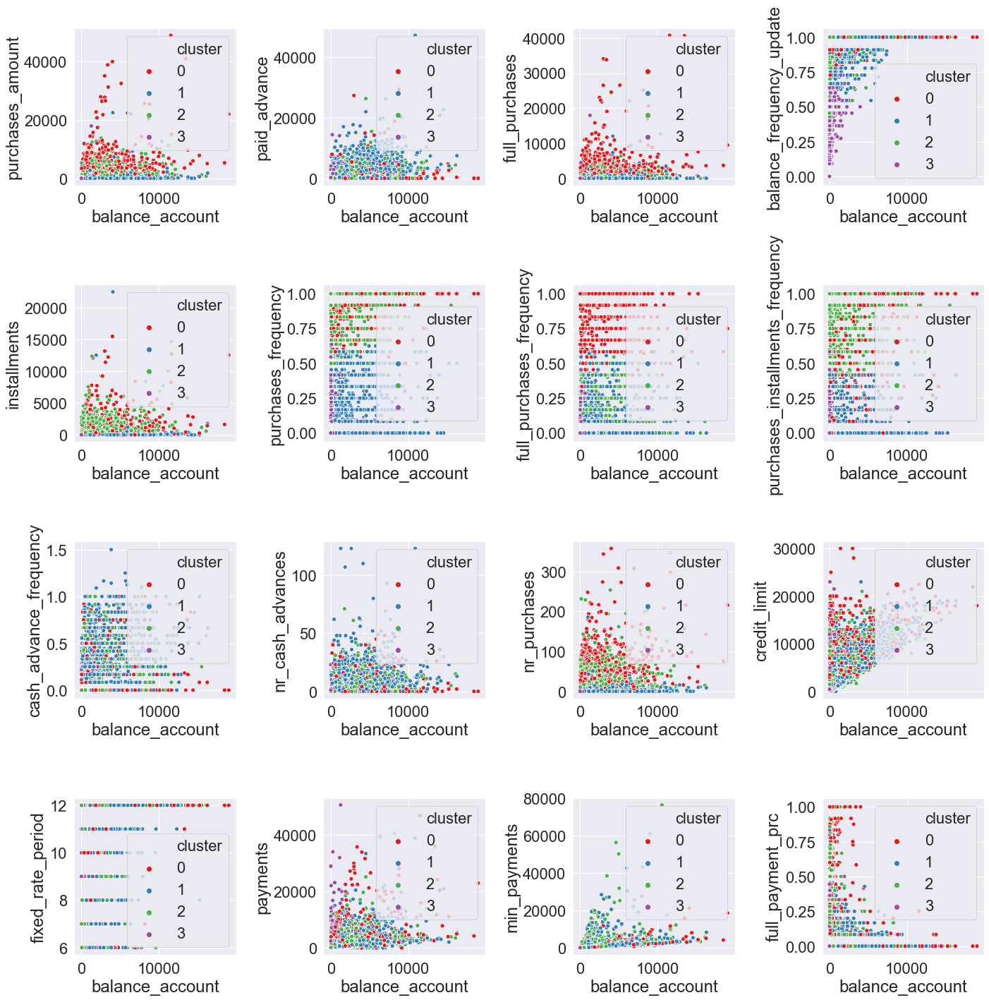

In [578]:
plot_2d_corr_features_nocenters(data_imp, cluster_labels, var_x, var_y, (20, 20), '4clusters_kmeans')

### Silhouette Standard Scaler

For n_clusters = 2 the average silhouette_score is : 0.20913133025169373
For n_clusters = 3 the average silhouette_score is : 0.2516399025917053
For n_clusters = 4 the average silhouette_score is : 0.2018386572599411
For n_clusters = 5 the average silhouette_score is : 0.19235222041606903
For n_clusters = 6 the average silhouette_score is : 0.20141124725341797
For n_clusters = 7 the average silhouette_score is : 0.21313196420669556
For n_clusters = 8 the average silhouette_score is : 0.22046808898448944
For n_clusters = 9 the average silhouette_score is : 0.22498401999473572


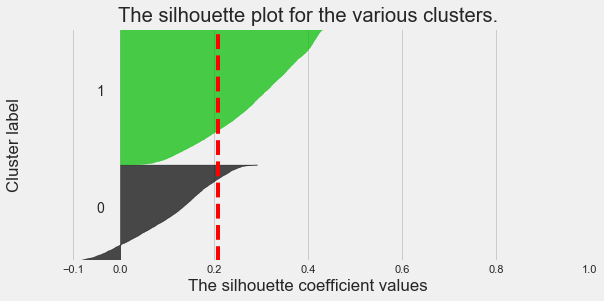

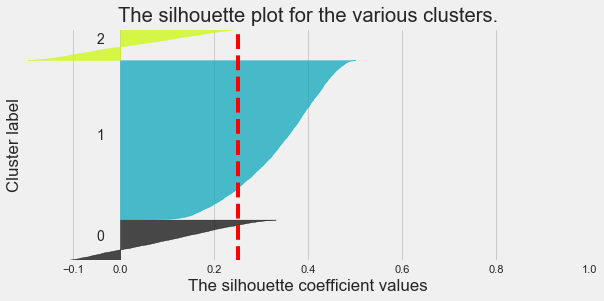

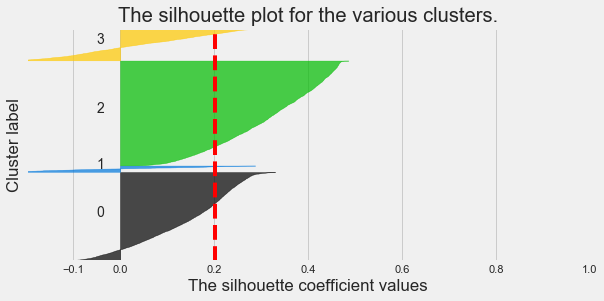

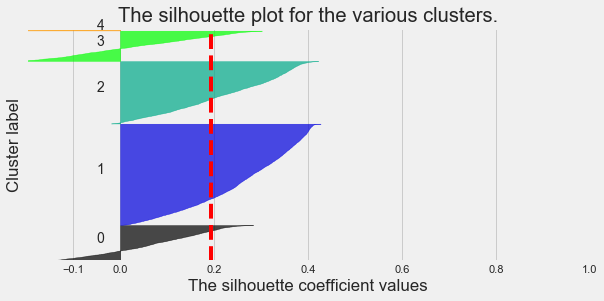

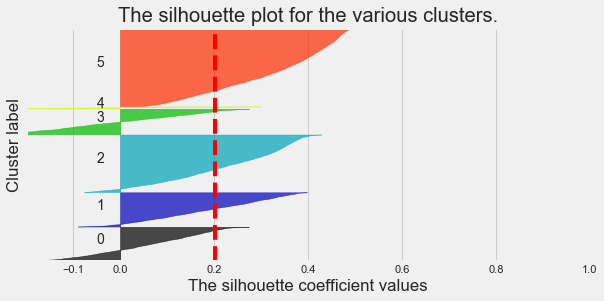

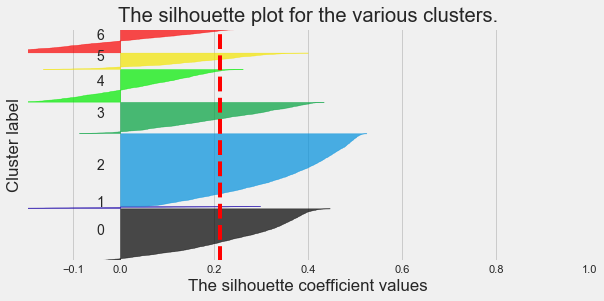

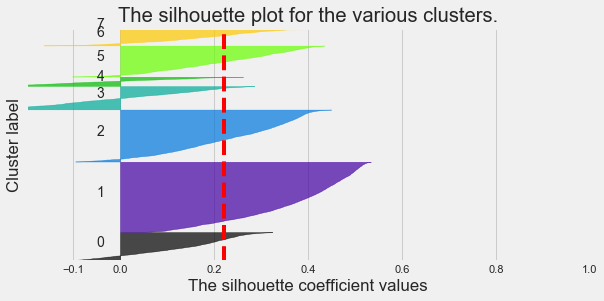

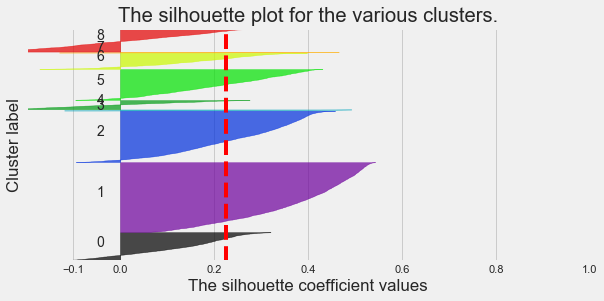

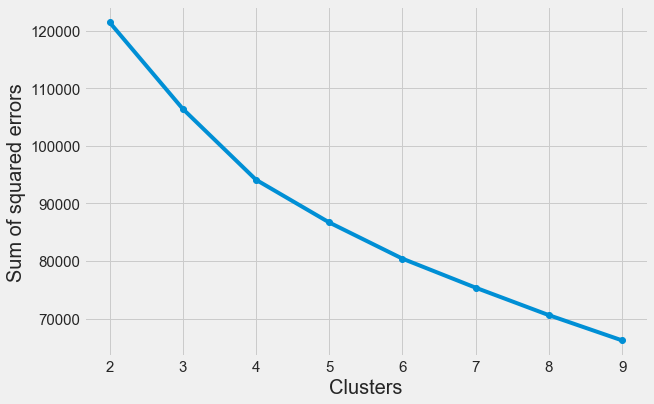

In [606]:
make_silhouette_plot(cluster_range, data_imp_scaled_g, 'kmeans_standard_scaler')

### Clusterer 3 Standard Scaler

In [621]:
clusterer3 = KMeans(n_clusters=3, init='k-means++', random_state=10)
cluster_labels_3 = clusterer3.fit_predict(data_imp_scaled_g)

In [622]:
clusterer3.cluster_centers_

array([[ 1.15895886, -0.28904914,  1.3775511 , -0.20677698,  0.34231824,
        -0.30510667, -0.64280777, -0.30782242, -0.55383024,  1.56076508,
         1.33751358, -0.36368182,  0.60534073, -0.12568054,  0.43145711,
         0.41450188, -0.40932747],
       [-0.36837581, -0.2289885 , -0.3110661 , -0.20025401, -0.17701562,
        -0.17464076, -0.06042107, -0.23144805, -0.04805817, -0.33670963,
        -0.29990212, -0.24175181, -0.3347426 , -0.02742411, -0.28081486,
        -0.13945526,  0.0093711 ],
       [ 0.33343795,  1.5305748 , -0.24134161,  1.27820967,  0.44153702,
         1.2782899 ,  1.14652374,  1.56755431,  0.96770734, -0.35254275,
        -0.24500488,  1.69260063,  0.89001181,  0.30267795,  0.84673046,
         0.15800827,  0.4894489 ]])

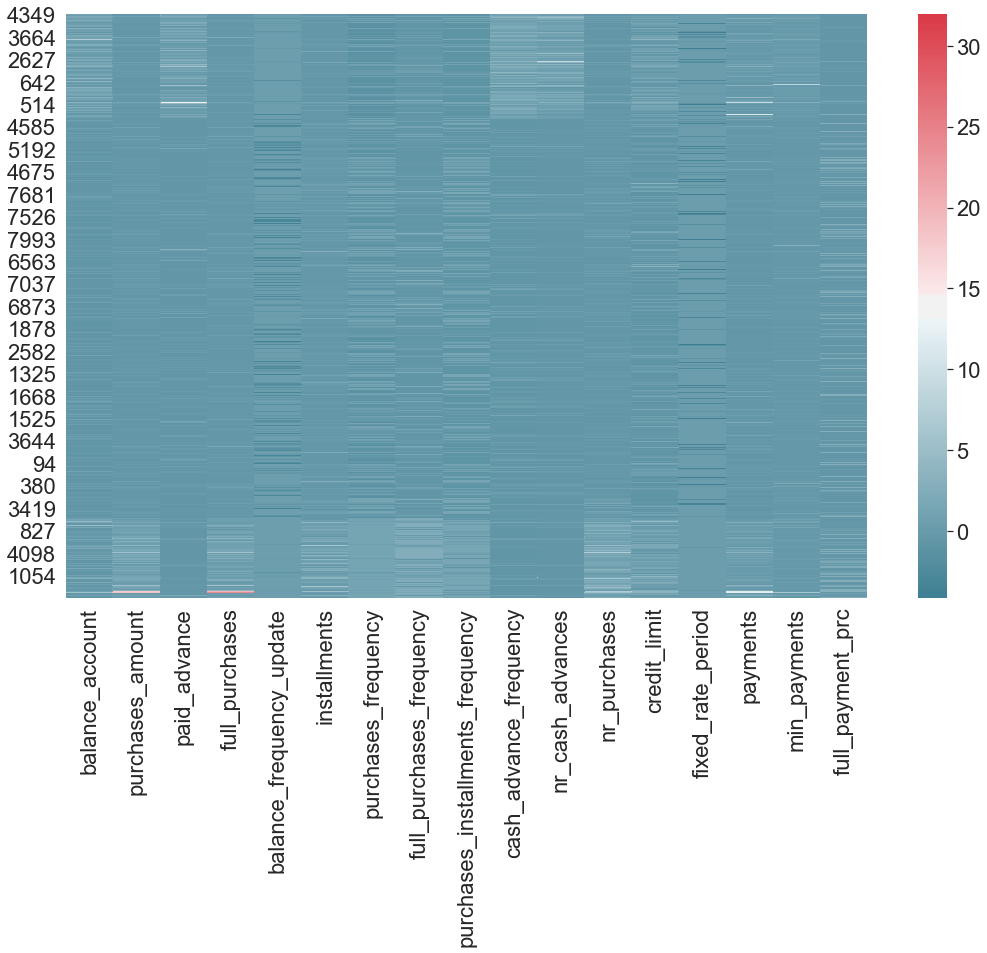

In [623]:
sns.set(font_scale=2)
data_w_3cls_standard = plot_map_clusters(data_imp_scaled_g, cluster_labels_3, 'heatmap_3clusters_kmeans_standard_scaler')

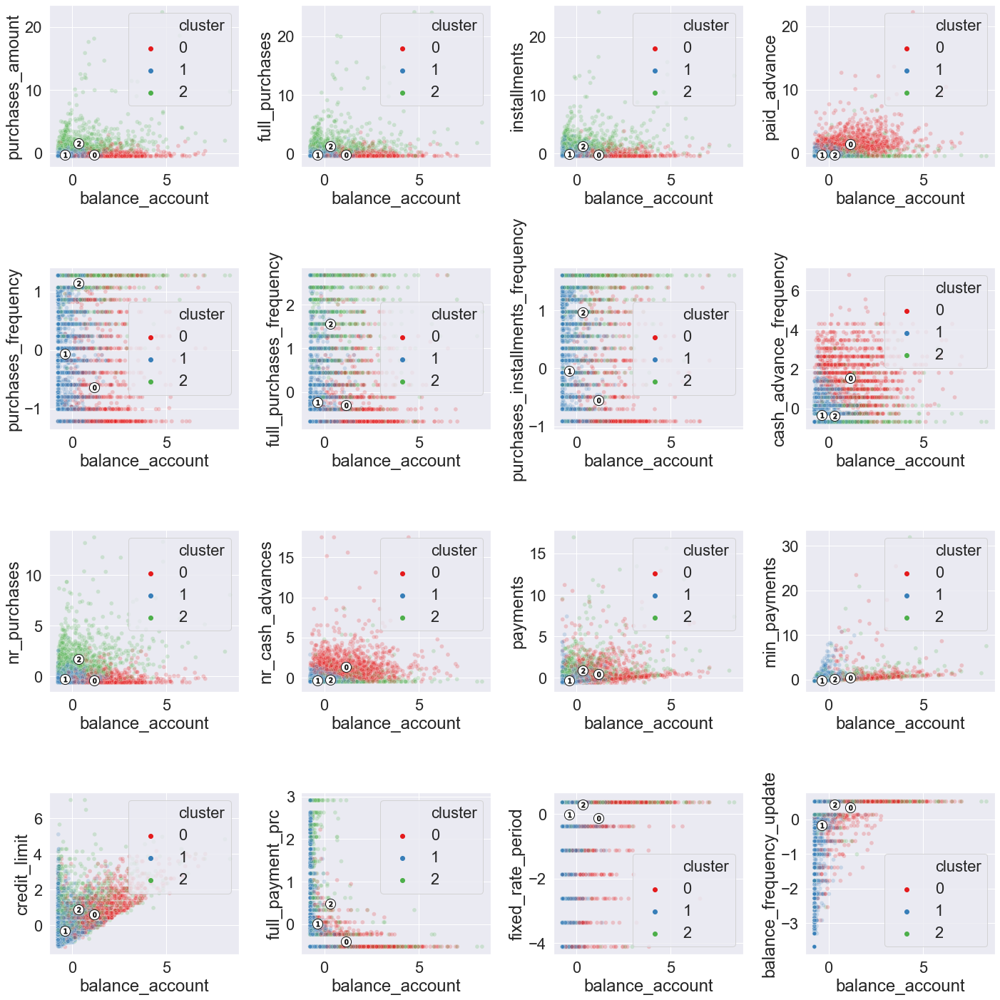

In [655]:
df_centers3 = pd.DataFrame(clusterer3.cluster_centers_, columns=data_imp_scaled_g.columns)

var_x_ = 'balance_account'
var_y_ = ['purchases_amount', 'full_purchases', 'installments', 'paid_advance', 
         'purchases_frequency', 'full_purchases_frequency', 'purchases_installments_frequency', 'cash_advance_frequency', 
         'nr_purchases', 'nr_cash_advances', 'payments', 'min_payments',
         'credit_limit', 'full_payment_prc','fixed_rate_period', 'balance_frequency_update']

plot_2d_corr_features_centers2(data_w_3cls_standard, var_x_, var_y_, df_centers3, (20, 20), '3clusters_kmeans_standard_scaler')

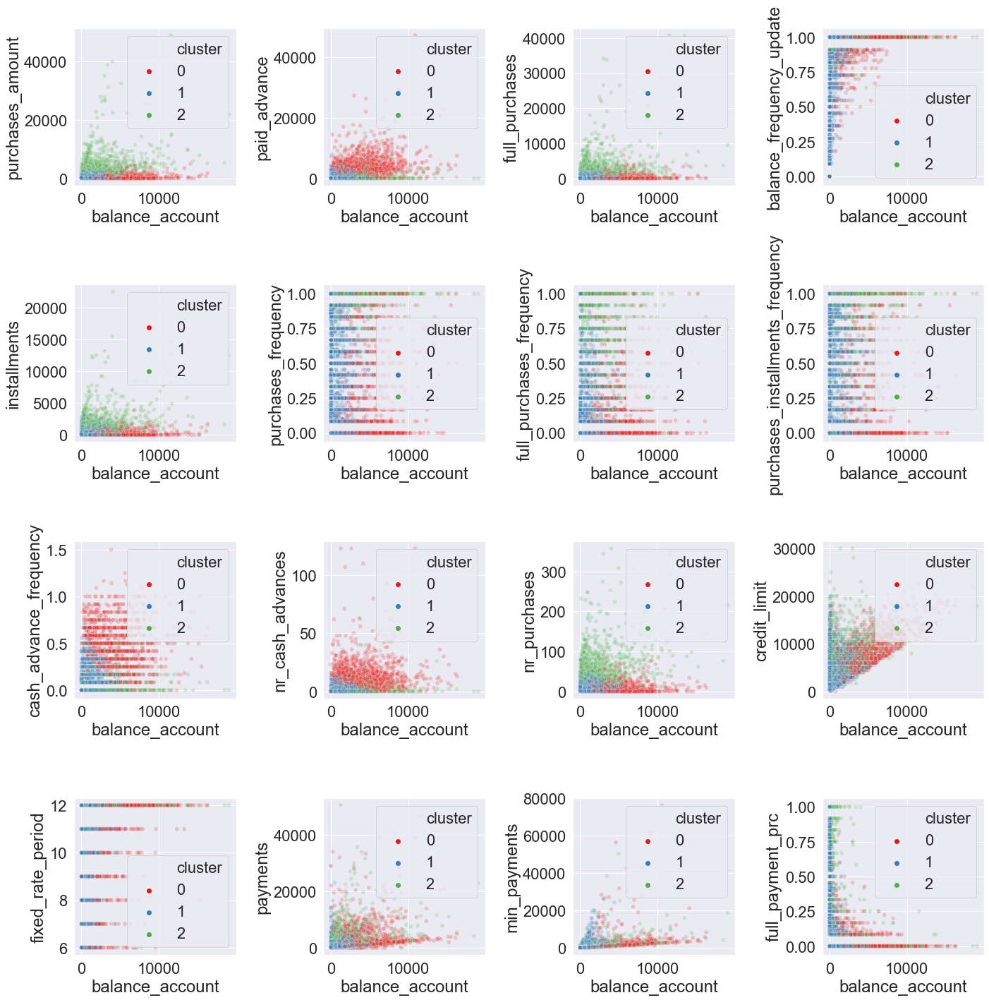

In [656]:
plot_2d_corr_features_nocenters(data_imp, cluster_labels_3, var_x, var_y, (20, 20), '3clusters_kmeans_standard_scaler_no_centers')

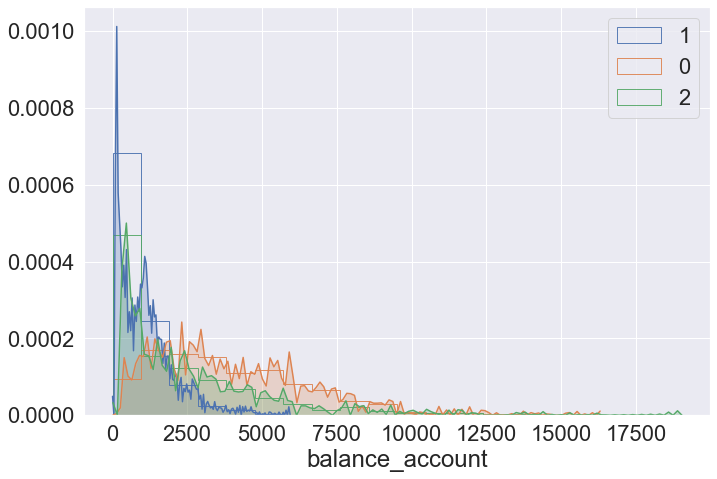

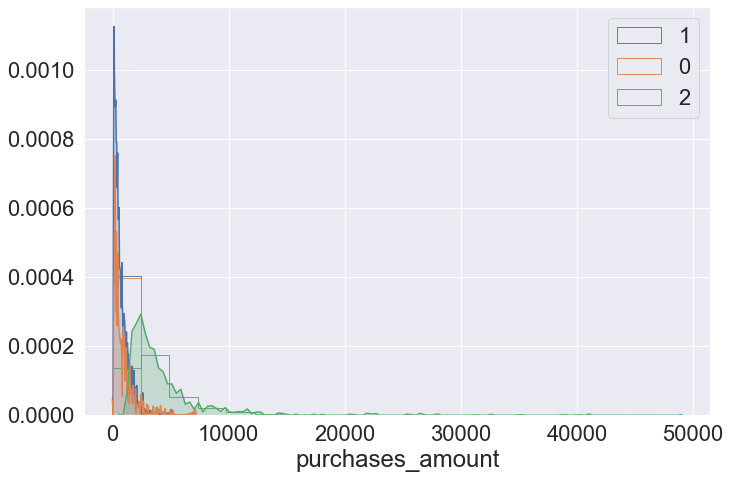

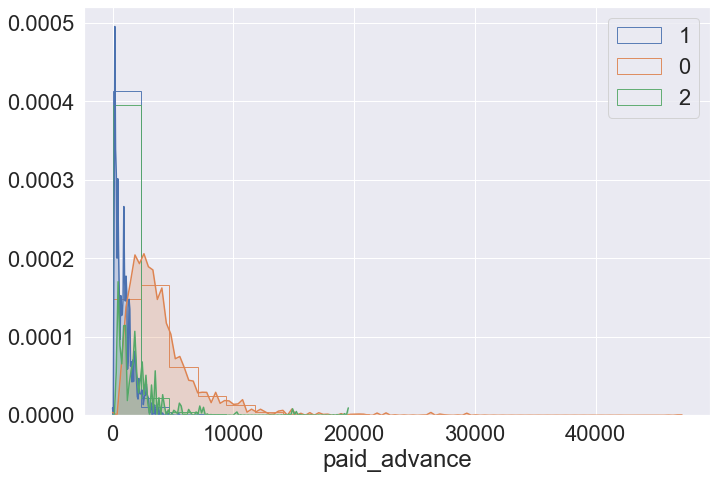

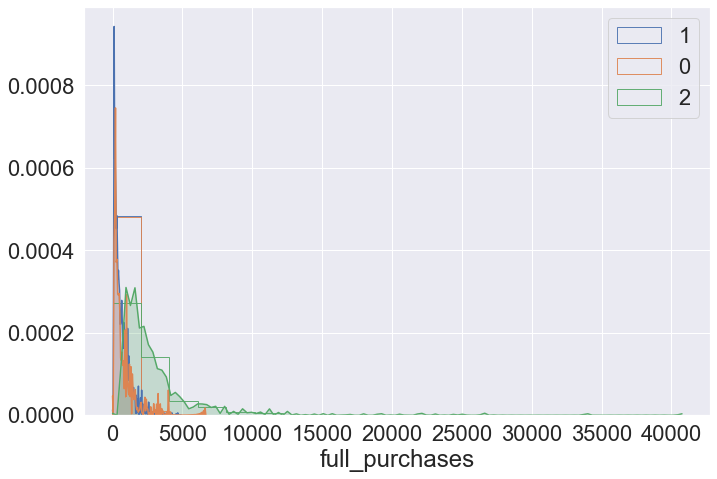

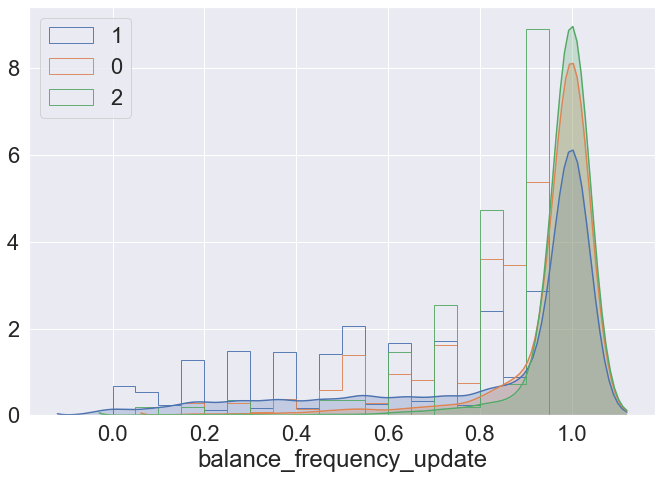

...

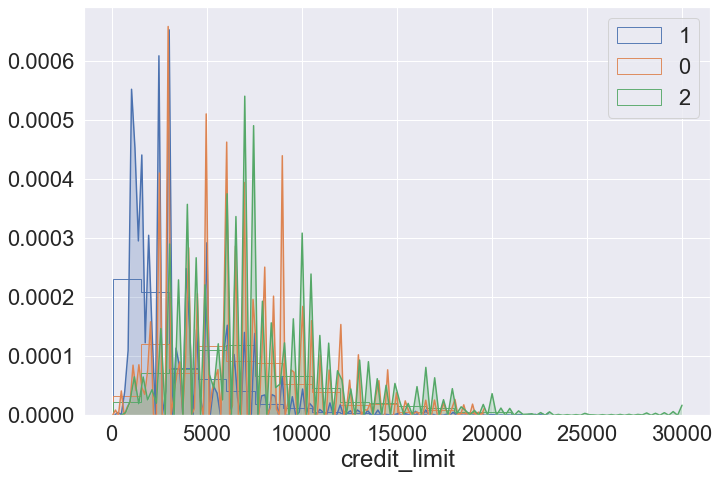

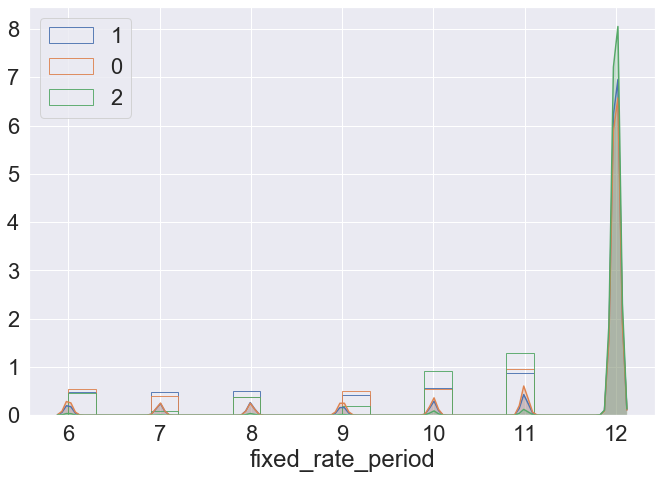

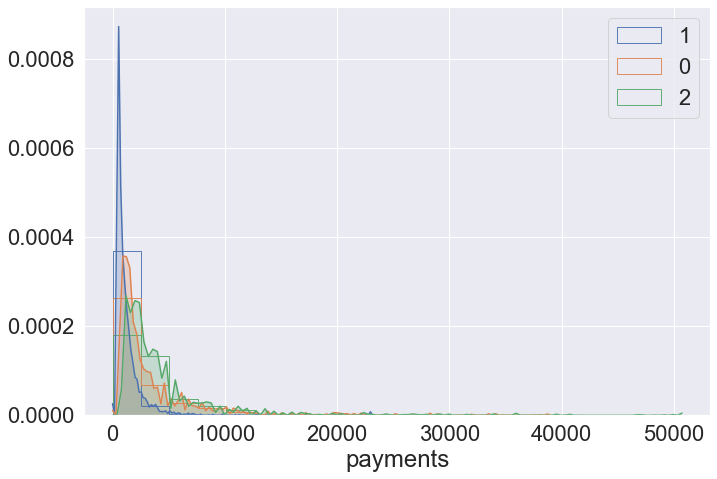

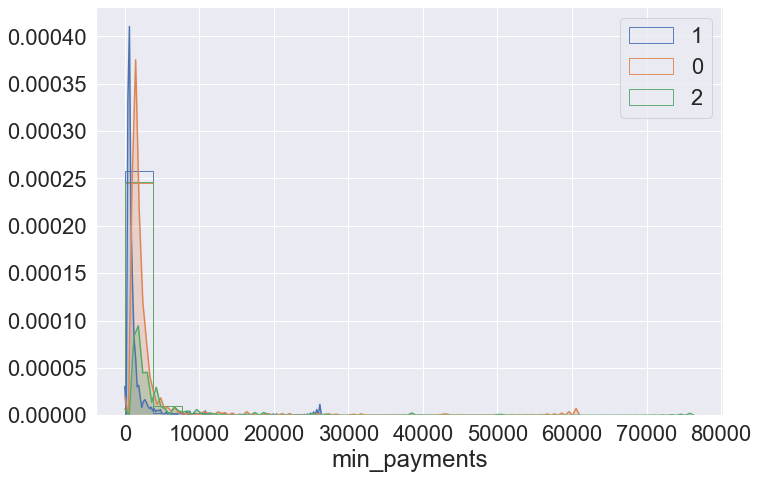

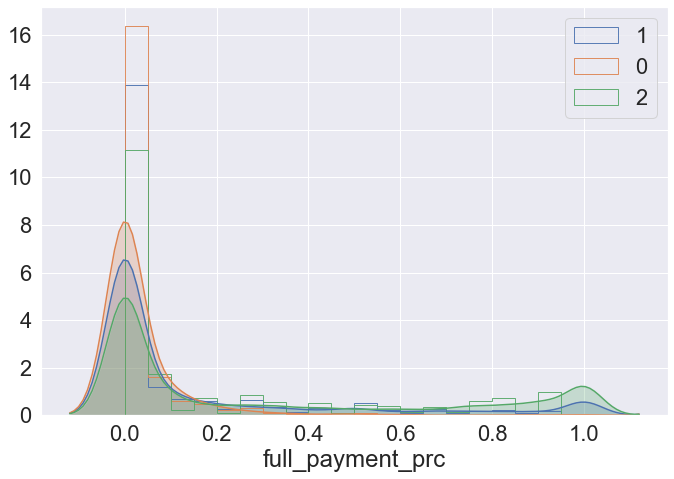

In [645]:
def plot_numeric_distrib_sns_mod(data, variables, outcome, figsize, filename):
    c = 0
    #binsize = np.arange(0,1,0.05)
    for v in variables:
        plt.figure(figsize=figsize)
        min_=  np.min(data[v])
        max_=  np.max(data[v])
        binsize = np.arange(min_,max_,(max_-min_)/20.)
        for cls in data[outcome].unique():
            df = data[data[outcome]==cls]
            g = sns.distplot(df[v], bins=binsize, label=cls, kde_kws={'bw':0.04, 'shade':True}, hist_kws={"histtype": "step", "linewidth": 0.9, "alpha": 1})
            plt.xlabel(v)
            plt.legend(loc='best')
        c = c + 1
        plt.savefig(f'./figures/distribution_{v}_{filename}.png', bbox_inches="tight")
        plt.show()  

data_w_3cls_standard_sc = data_imp.copy()
variables = data_w_3cls_standard_sc.columns
data_w_3cls_standard_sc['cluster'] = cluster_labels_3

plot_numeric_distrib_sns_mod(data_w_3cls_standard_sc, variables, 'cluster', (10,7), '3clusters_kmeans_standardscaler')

No handles with labels found to put in legend.


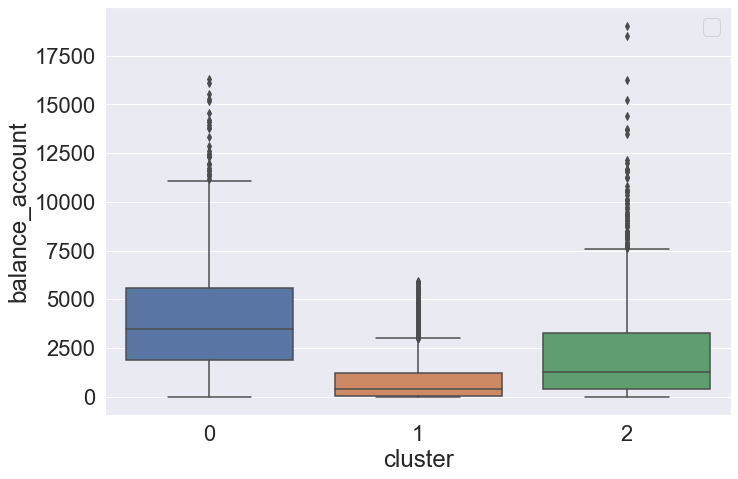

No handles with labels found to put in legend.


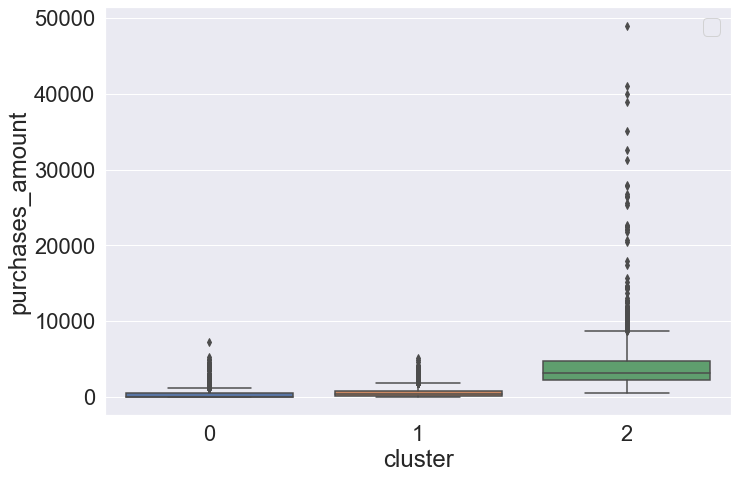

No handles with labels found to put in legend.


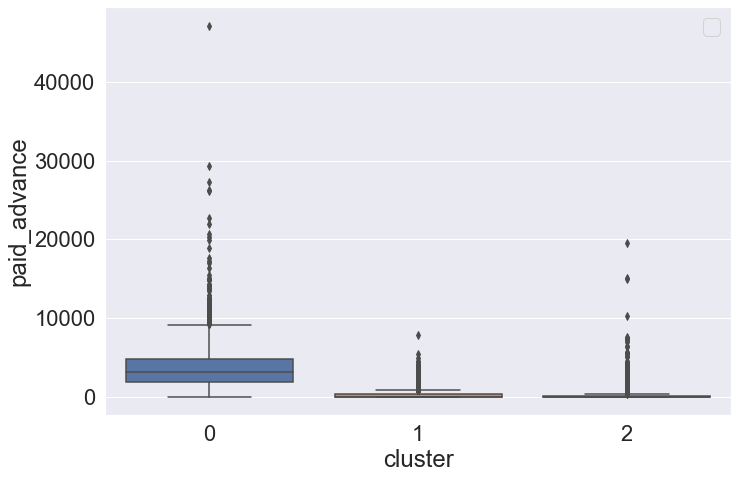

No handles with labels found to put in legend.


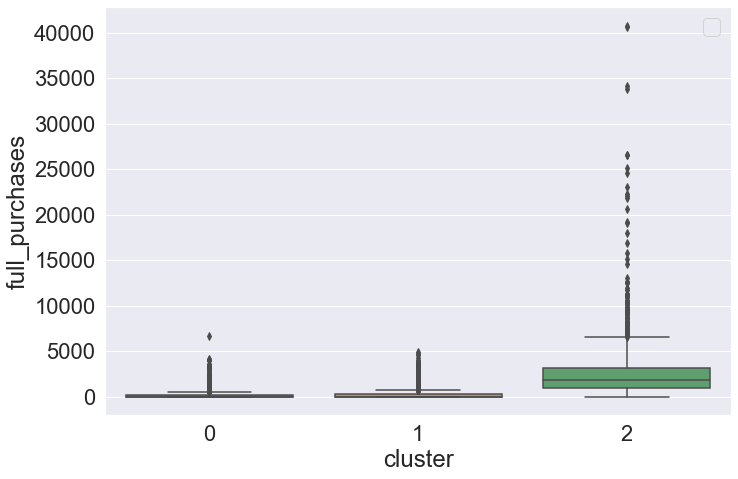

No handles with labels found to put in legend.


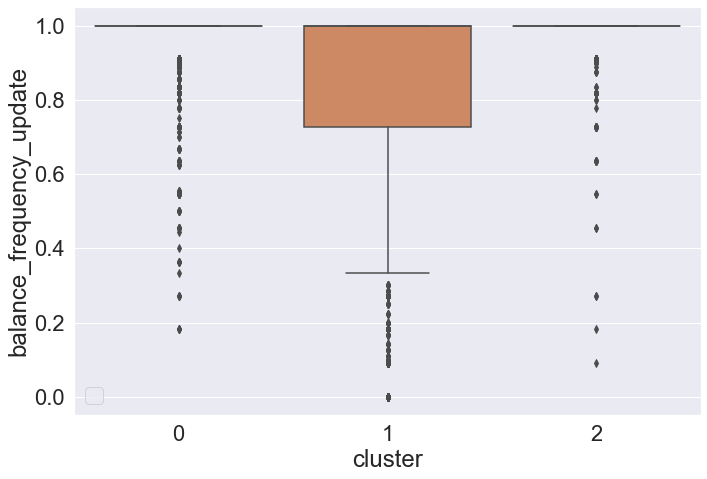

No handles with labels found to put in legend.


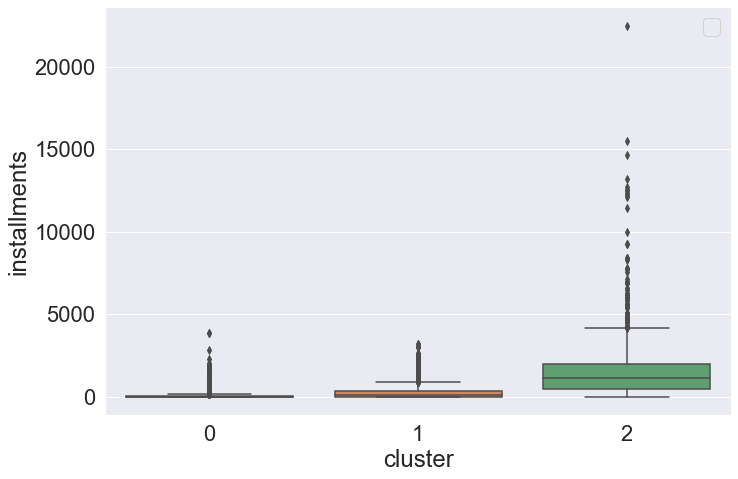

No handles with labels found to put in legend.


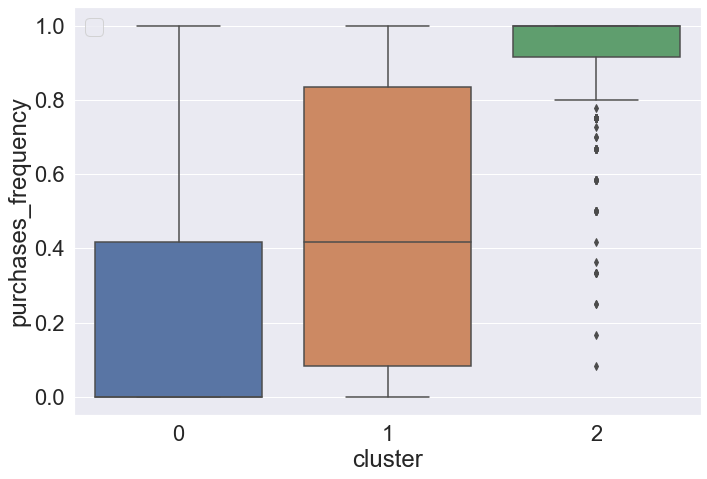

No handles with labels found to put in legend.


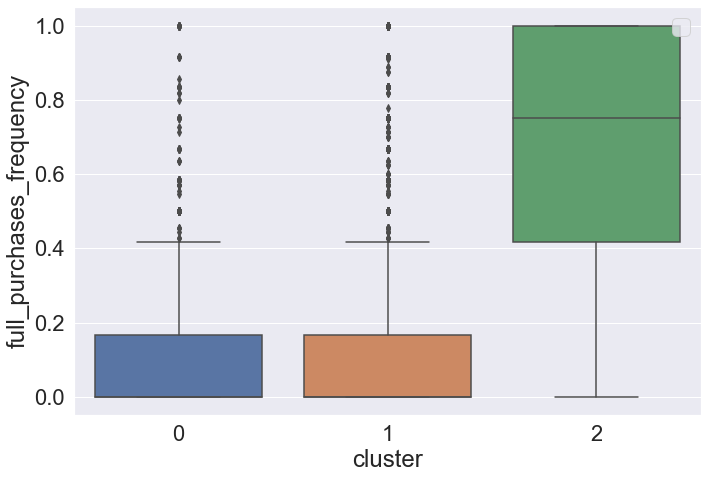

No handles with labels found to put in legend.


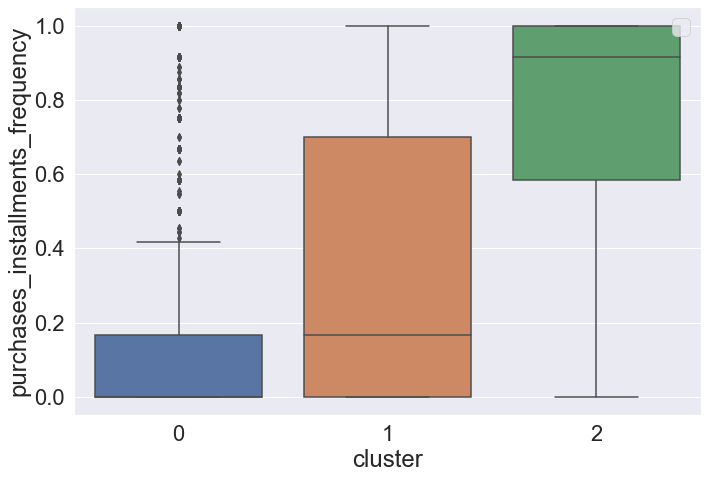

No handles with labels found to put in legend.


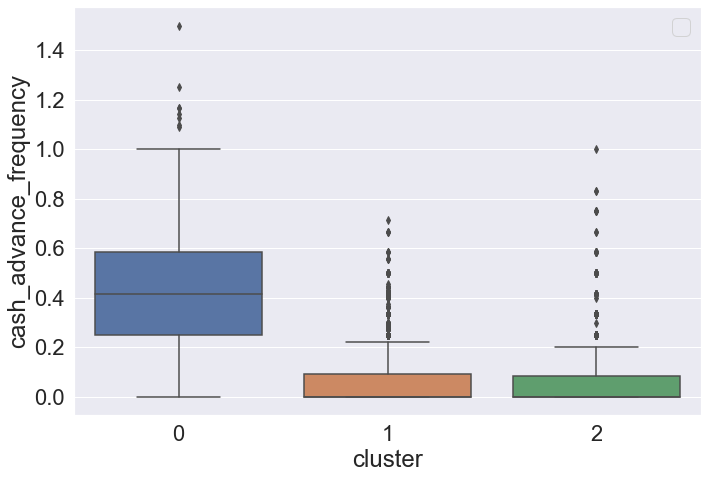

No handles with labels found to put in legend.


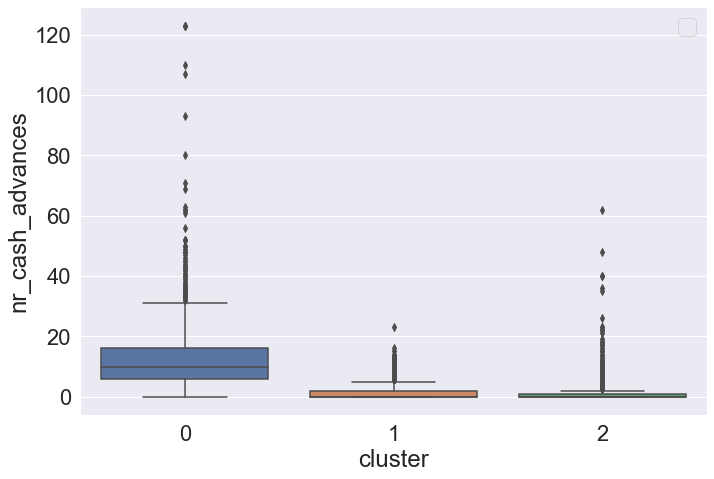

No handles with labels found to put in legend.


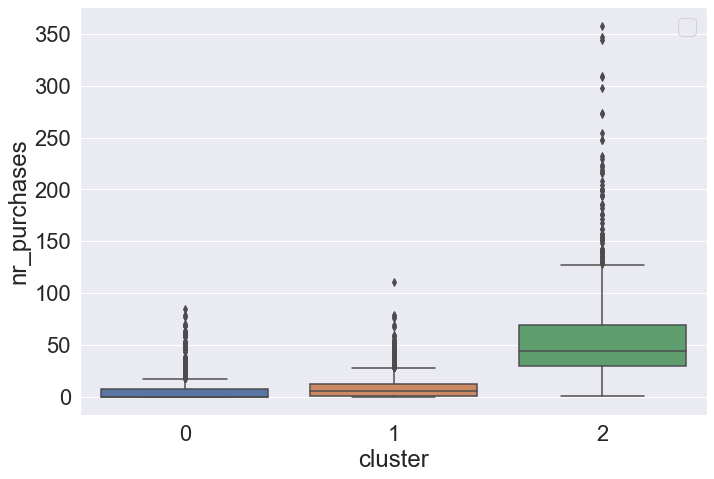

No handles with labels found to put in legend.


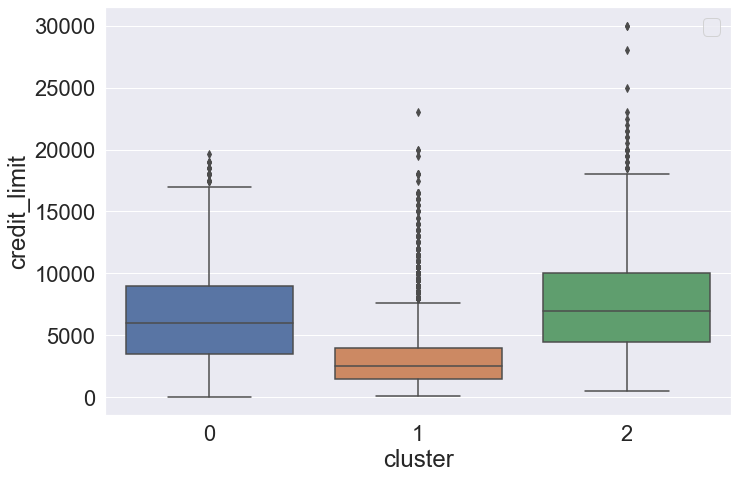

No handles with labels found to put in legend.


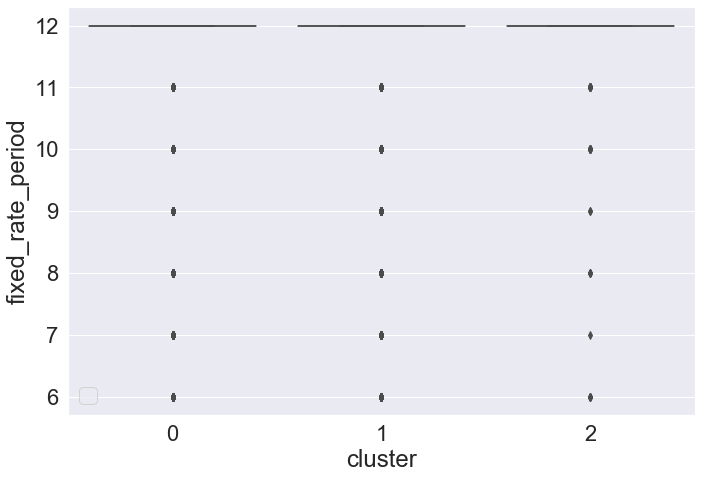

No handles with labels found to put in legend.


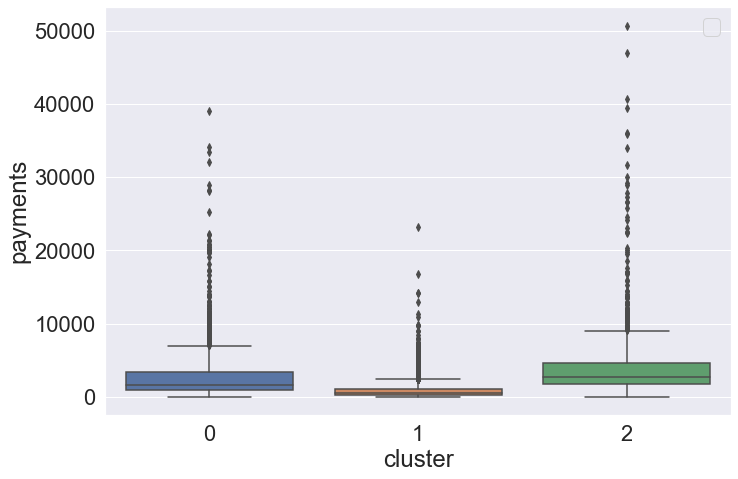

No handles with labels found to put in legend.


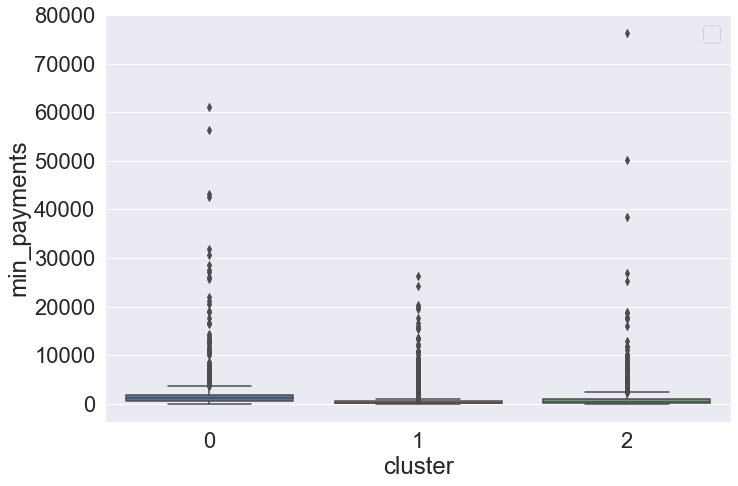

No handles with labels found to put in legend.


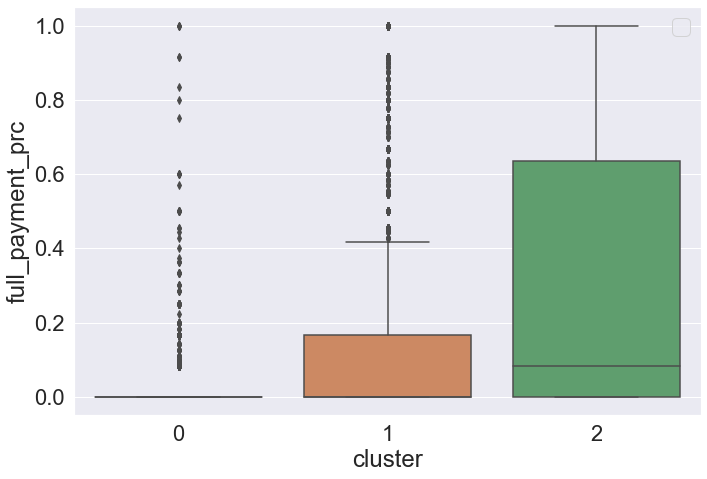

In [648]:
plot_box_sns(data_w_3cls_standard_sc, variables, 'cluster', (10,7), '3clusters_kmeans_standardscaler_box')

In [636]:
data_w_3cls_standard_sc.head()

,balance_account,purchases_amount,paid_advance,full_purchases,balance_frequency_update,installments,purchases_frequency,full_purchases_frequency,purchases_installments_frequency,cash_advance_frequency,nr_cash_advances,nr_purchases,credit_limit,fixed_rate_period,payments,min_payments,full_payment_prc,cluster
0,9.298409,107.60,0.000000,0.00,0.909091,107.6,0.909091,0.000000,0.818182,0.000000,0.0,10.0,1000.0,11.0,89.868853,89.711672,0.428571,1
1,52.666422,150.30,0.000000,0.00,1.000000,150.3,1.000000,0.000000,0.833333,0.000000,0.0,6.0,1000.0,6.0,54.722514,82.955180,0.000000,1
2,1360.795674,0.00,462.861443,0.00,1.000000,0.0,0.000000,0.000000,0.000000,0.272727,6.0,0.0,1500.0,11.0,303.031979,443.781316,0.000000,1
3,2021.641161,363.18,0.000000,363.18,1.000000,0.0,1.000000,1.000000,0.000000,0.000000,0.0,13.0,2000.0,12.0,704.240770,795.859808,0.000000,1
4,22.322374,95.00,1162.045833,95.00,0.363636,0.0,0.083333,0.083333,0.000000,0.166667,3.0,1.0,2500.0,12.0,4094.261427,40.142262,0.000000,1


In [637]:
data_imp.head()

,balance_account,purchases_amount,paid_advance,full_purchases,balance_frequency_update,installments,purchases_frequency,full_purchases_frequency,purchases_installments_frequency,cash_advance_frequency,nr_cash_advances,nr_purchases,credit_limit,fixed_rate_period,payments,min_payments,full_payment_prc
0,9.298409,107.60,0.000000,0.00,0.909091,107.6,0.909091,0.000000,0.818182,0.000000,0.0,10.0,1000.0,11.0,89.868853,89.711672,0.428571
1,52.666422,150.30,0.000000,0.00,1.000000,150.3,1.000000,0.000000,0.833333,0.000000,0.0,6.0,1000.0,6.0,54.722514,82.955180,0.000000
2,1360.795674,0.00,462.861443,0.00,1.000000,0.0,0.000000,0.000000,0.000000,0.272727,6.0,0.0,1500.0,11.0,303.031979,443.781316,0.000000
3,2021.641161,363.18,0.000000,363.18,1.000000,0.0,1.000000,1.000000,0.000000,0.000000,0.0,13.0,2000.0,12.0,704.240770,795.859808,0.000000
4,22.322374,95.00,1162.045833,95.00,0.363636,0.0,0.083333,0.083333,0.000000,0.166667,3.0,1.0,2500.0,12.0,4094.261427,40.142262,0.000000


### Clusterer 4 Standard Scaler


In [657]:
clusterer4 = KMeans(n_clusters=4, init='k-means++', random_state=10)
cluster_labels_4 = clusterer4.fit_predict(data_imp_scaled_g)

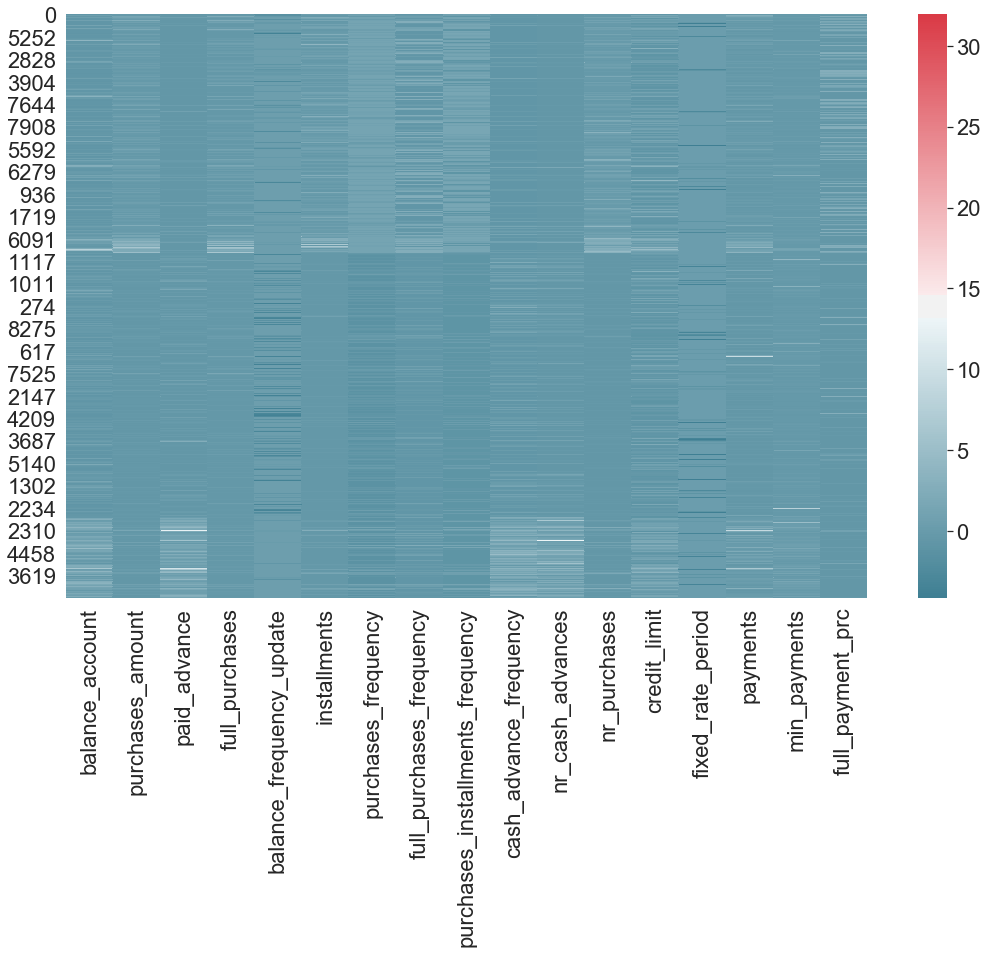

In [658]:
sns.set(font_scale=2)
data_w_4cls_standard = plot_map_clusters(data_imp_scaled_g, cluster_labels_4, 'heatmap_4clusters_kmeans_standard_scaler')

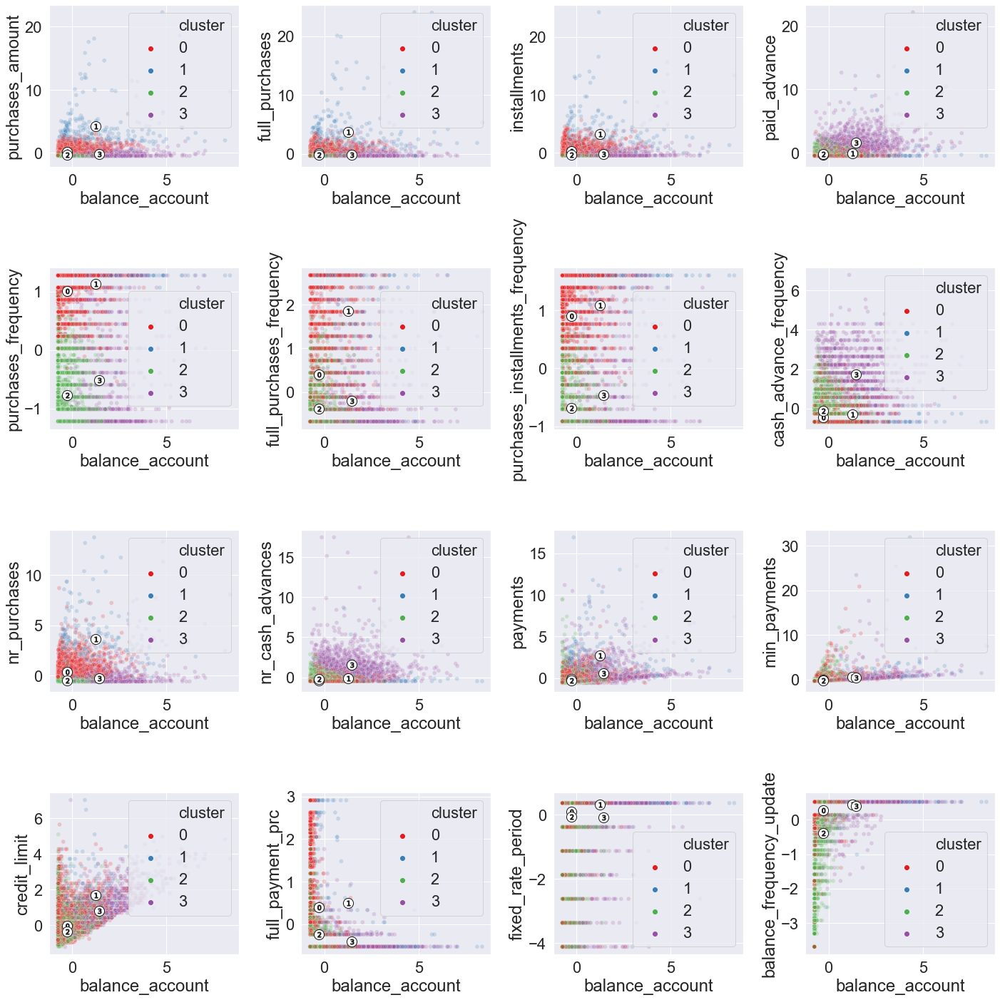

In [685]:
df_centers4 = pd.DataFrame(clusterer4.cluster_centers_, columns=data_imp_scaled_g.columns)

var_x_ = 'balance_account'
var_y_ = ['purchases_amount', 'full_purchases', 'installments', 'paid_advance', 
         'purchases_frequency', 'full_purchases_frequency', 'purchases_installments_frequency', 'cash_advance_frequency', 
         'nr_purchases', 'nr_cash_advances', 'payments', 'min_payments',
         'credit_limit', 'full_payment_prc','fixed_rate_period', 'balance_frequency_update']

plot_2d_corr_features_centers2(data_w_4cls_standard, var_x_, var_y_, df_centers4, (20, 20), '4clusters_kmeans_standard_scaler')

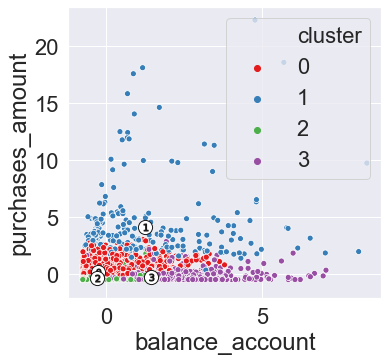

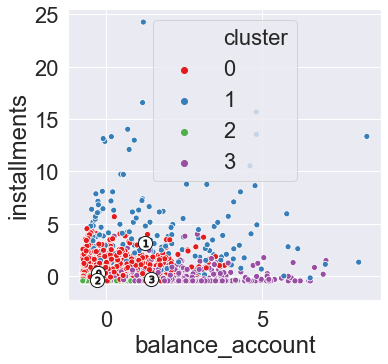

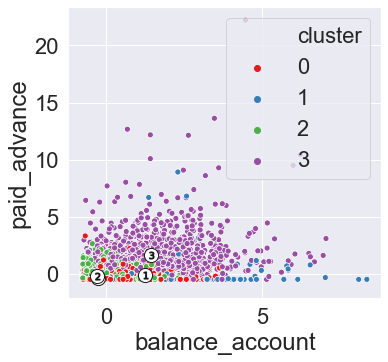

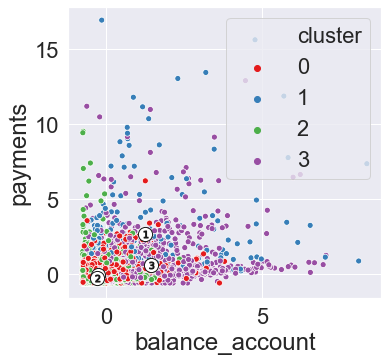

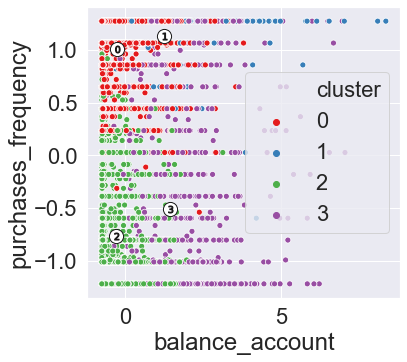

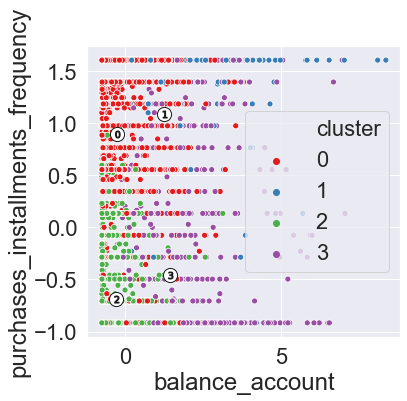

In [691]:
var_x__ = ['balance_account', 'balance_account', 'balance_account', 'balance_account', 'balance_account', 'balance_account']
var_y__ = ['purchases_amount', 'installments', 'paid_advance', 'payments', 'purchases_frequency', 'purchases_installments_frequency']

plot_2d_corr_features_centers(data_w_4cls_standard, var_x__, var_y__, df_centers4, (5, 5), '4clusters_kmeans_standard_scaler_selected')

In [ ]:
def plot_2d_corr_features_centers2(df, featx, featuresy, centers_df, figsize, filename):
    fig = plt.figure(figsize=figsize)
    i = 0 
    for featy in featuresy:
        ax = fig.add_subplot(4, 4, i+1)
#         ax.scatter(
#              x=df[featx],
#              y=df[featy],
#              c=df['cluster'],
#              cmap='tab10',
#              alpha=0.2
#          )
        sns.scatterplot(x=df[featx],y=df[featy],hue=df['cluster'],palette='Set1',alpha=0.2)
        for c in range((centers_df.shape)[0]):
            ax.scatter(centers_df.loc[c, featx], centers_df.loc[c, featy], marker='o',c="white", alpha=1, s=200, edgecolor='k')
            ax.scatter(centers_df.loc[c, featx], centers_df.loc[c, featy], marker='$%d$' % c, alpha=1, s=50, edgecolor='k')
        plt.xlabel(featx)
        plt.ylabel(featy)
        i = i+1
    fig.tight_layout()
    plt.savefig(f'./figures/scatter_vs_{featx}_{filename}.png', bbox_inches="tight")
    plt.show()

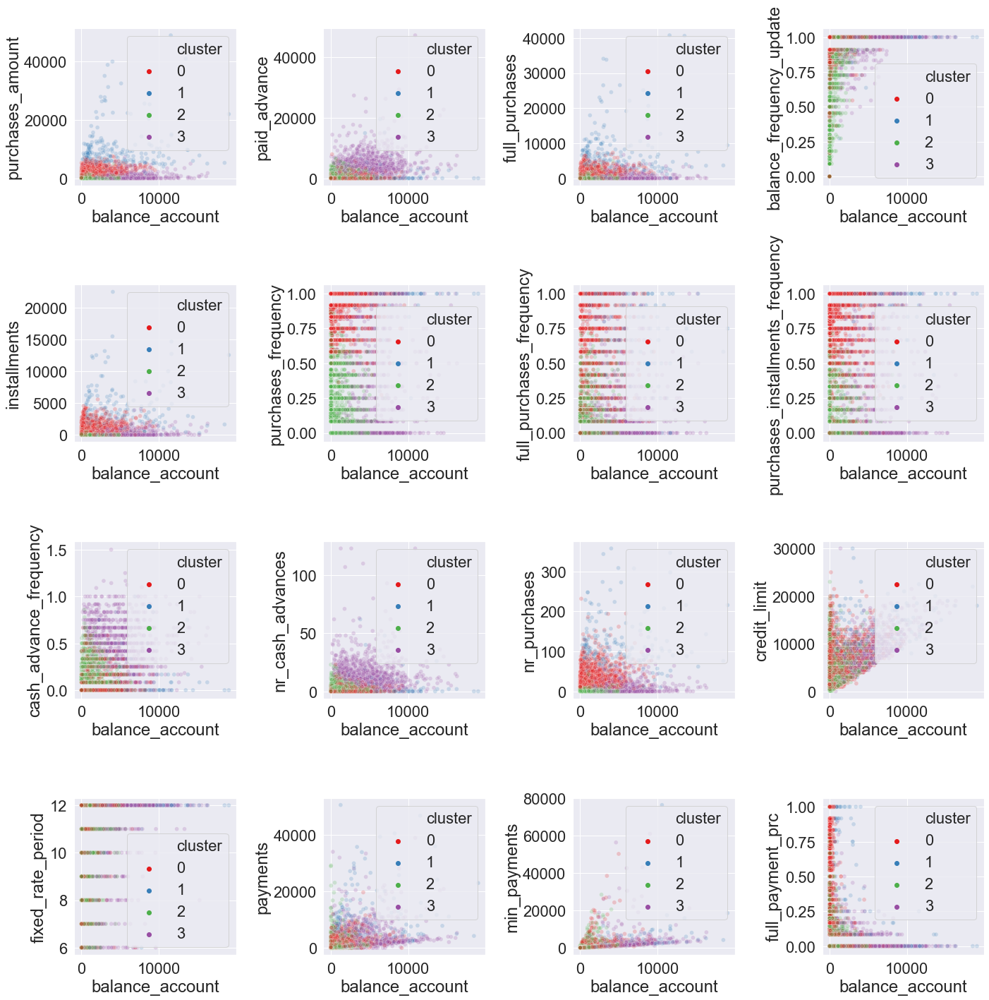

In [684]:
plot_2d_corr_features_nocenters(data_imp, cluster_labels_4, var_x, var_y, (20, 20), '4clusters_kmeans_standard_scaler_no_centers')

No handles with labels found to put in legend.


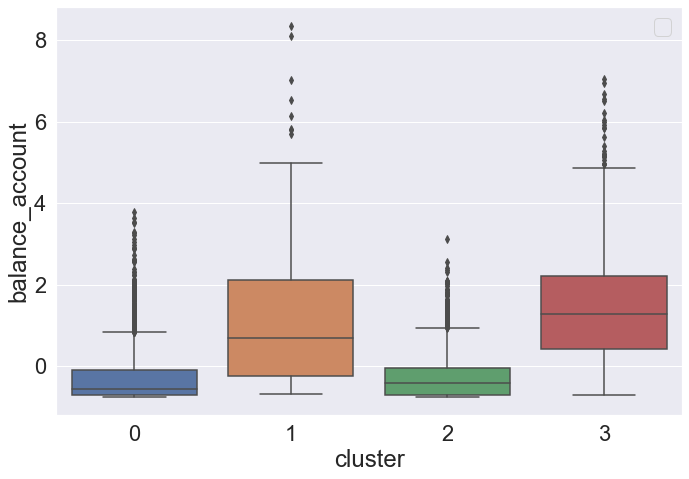

No handles with labels found to put in legend.


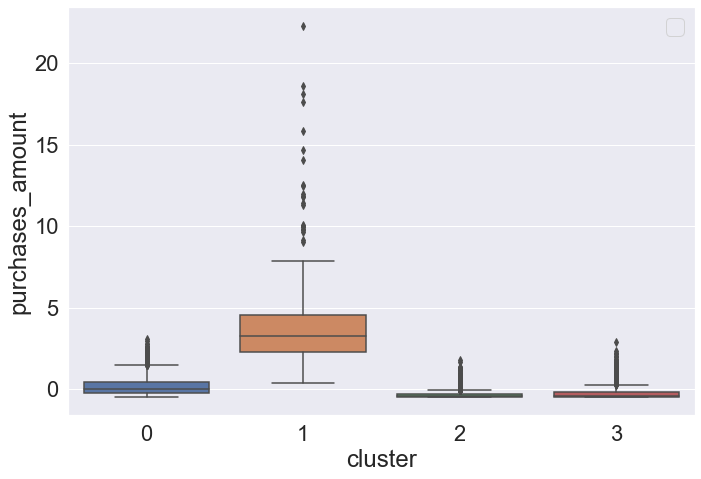

No handles with labels found to put in legend.


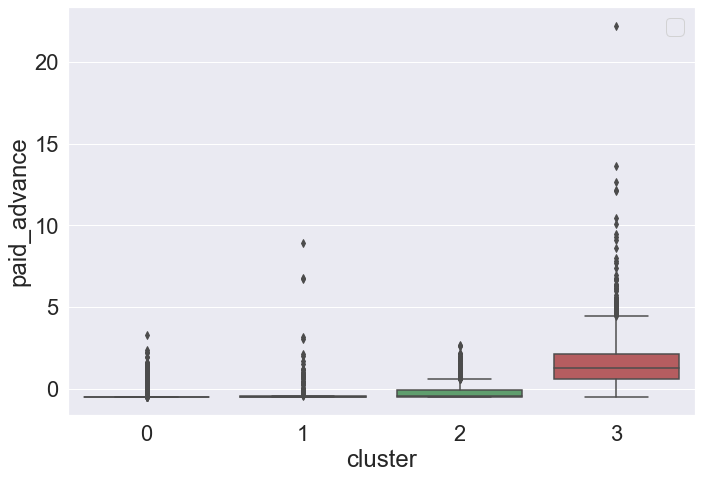

No handles with labels found to put in legend.


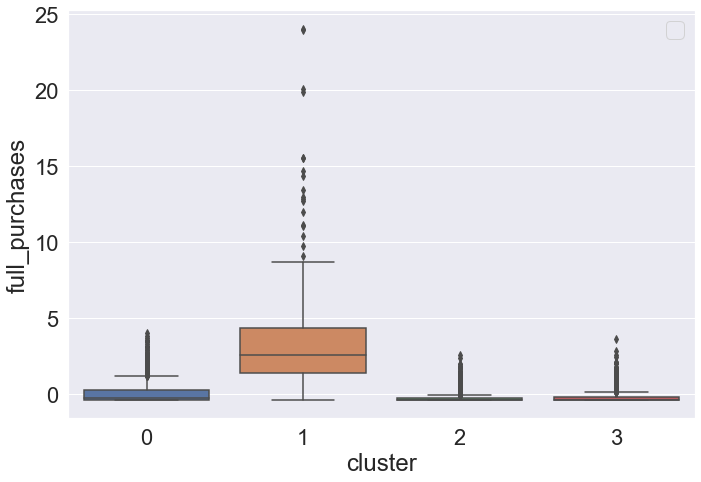

No handles with labels found to put in legend.


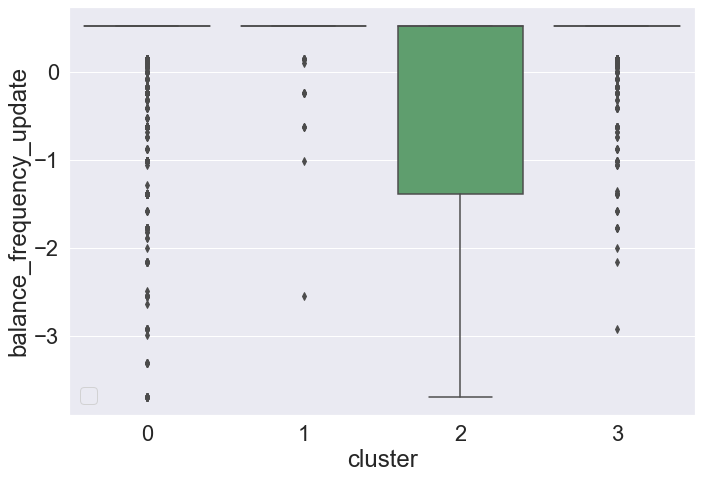

No handles with labels found to put in legend.


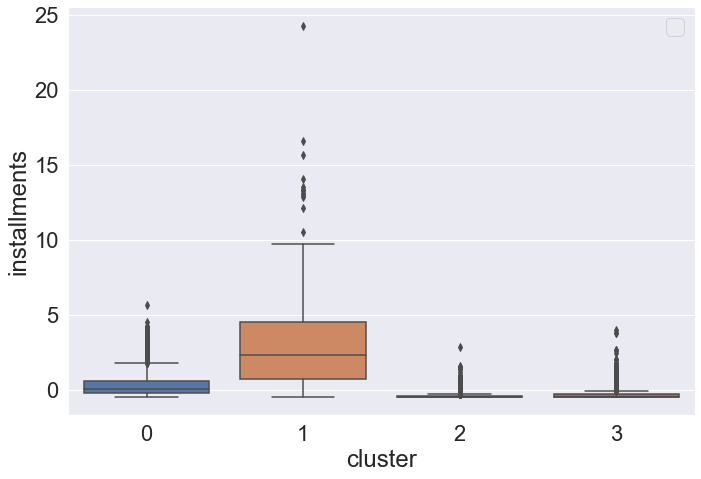

No handles with labels found to put in legend.


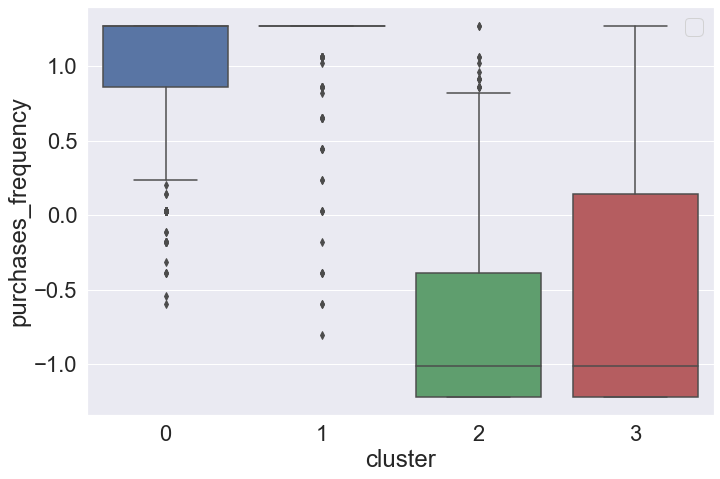

No handles with labels found to put in legend.


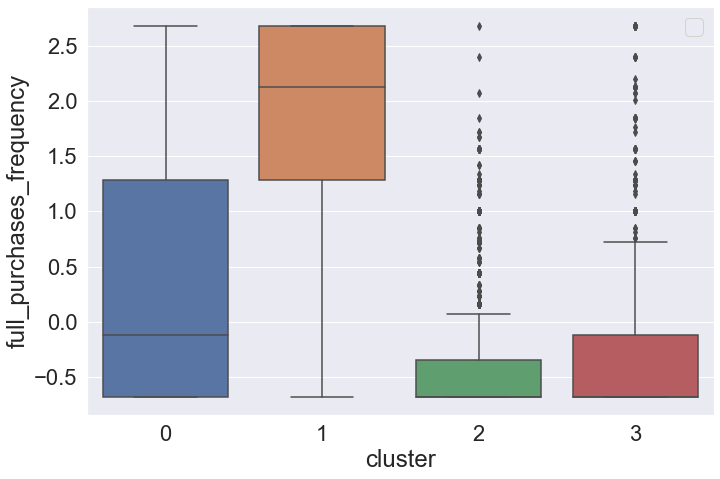

No handles with labels found to put in legend.


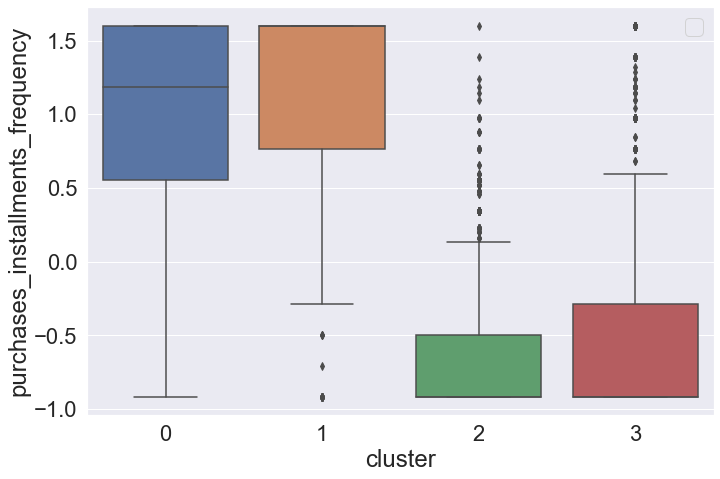

No handles with labels found to put in legend.


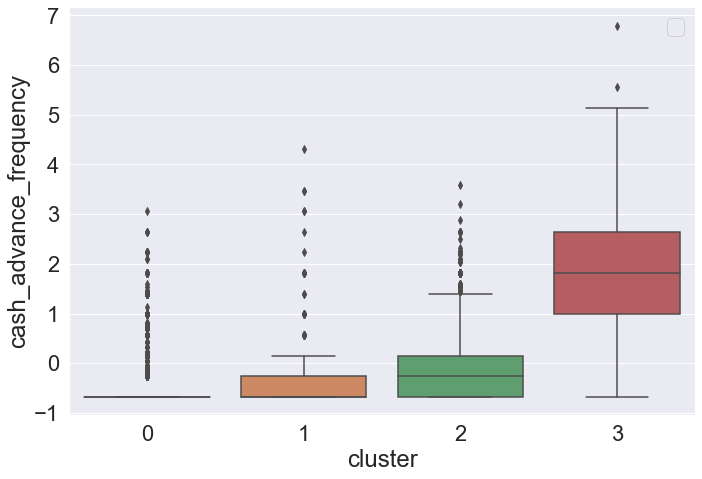

No handles with labels found to put in legend.


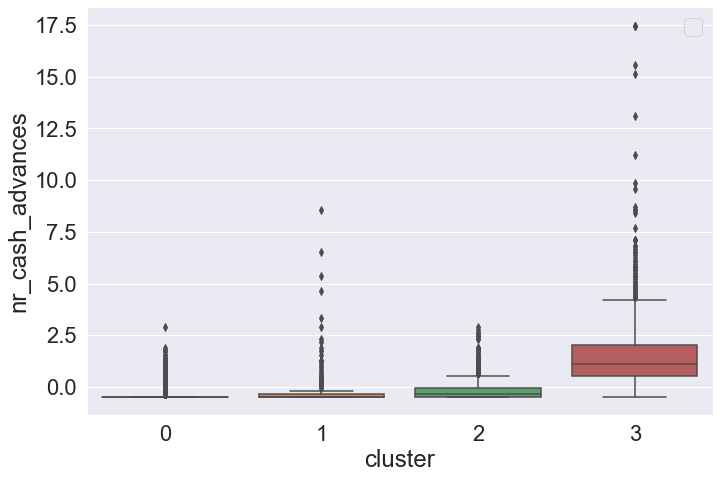

No handles with labels found to put in legend.


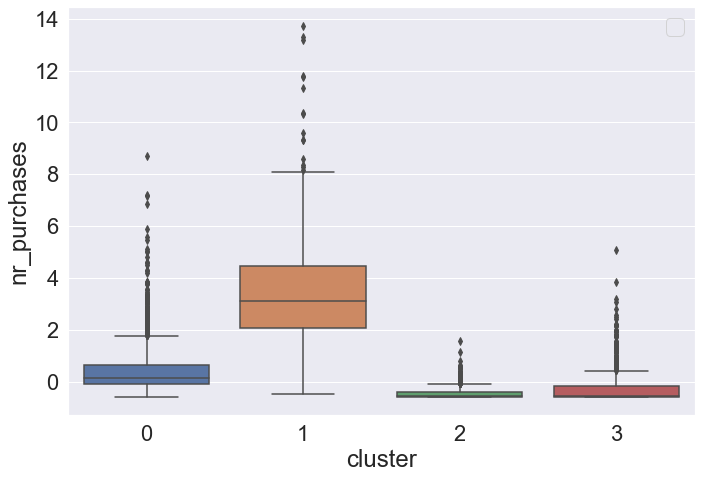

No handles with labels found to put in legend.


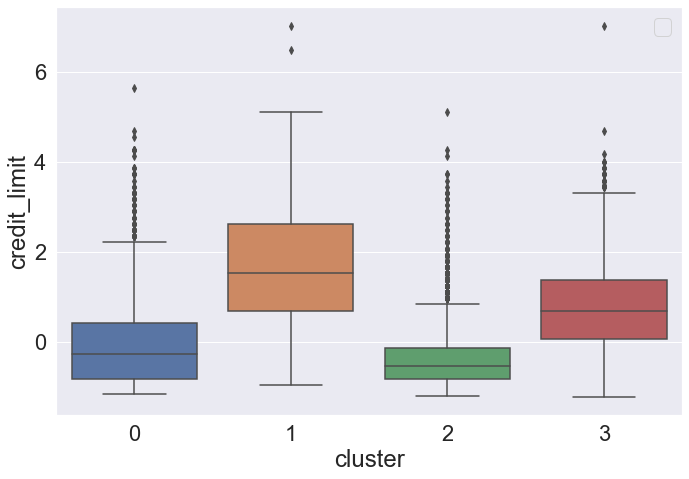

No handles with labels found to put in legend.


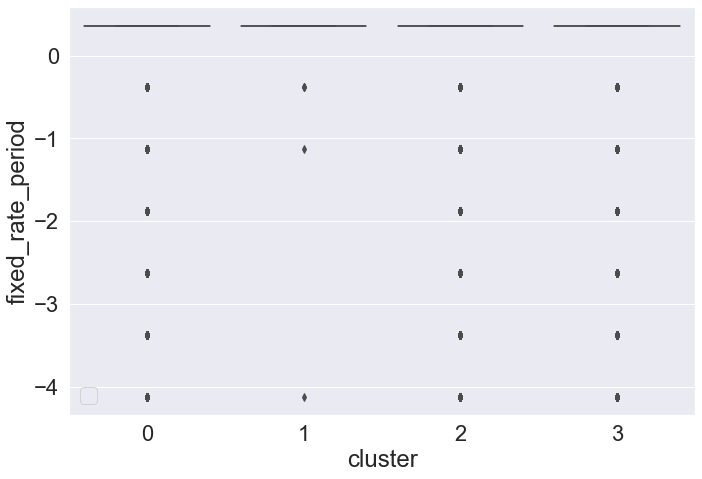

No handles with labels found to put in legend.


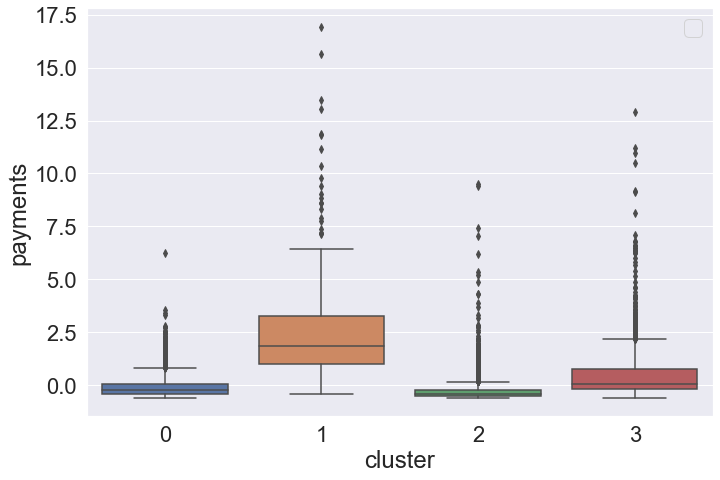

No handles with labels found to put in legend.


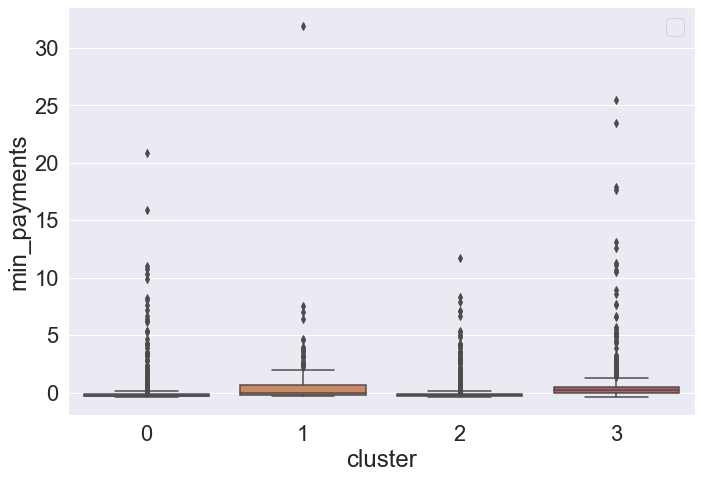

No handles with labels found to put in legend.


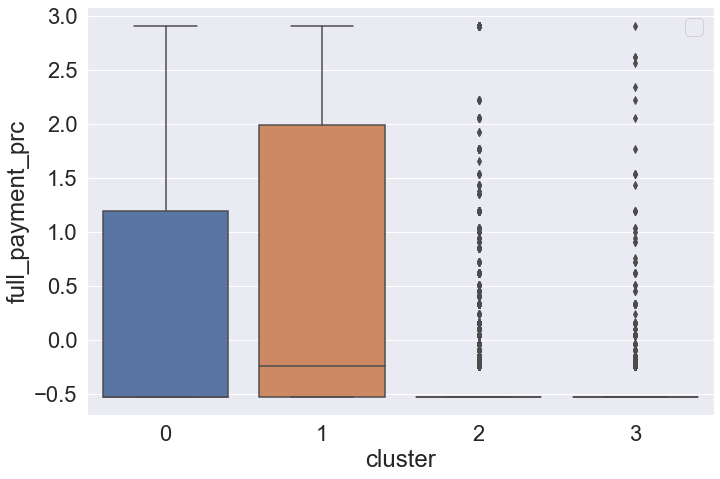

In [662]:
plot_box_sns(data_w_4cls_standard, variables, 'cluster', (10,7), '4clusters_kmeans_standardscaler_box')

In [665]:
data_w_4cls_standard.columns
df_test = data_w_4cls_standard.copy()
df_test=df_test[variables]

Index(['balance_account', 'purchases_amount', 'paid_advance', 'full_purchases',
       'balance_frequency_update', 'installments', 'purchases_frequency',
       'full_purchases_frequency', 'purchases_installments_frequency',
       'cash_advance_frequency', 'nr_cash_advances', 'nr_purchases',
       'credit_limit', 'fixed_rate_period', 'payments', 'min_payments',
       'full_payment_prc', 'cluster'],
      dtype='object')

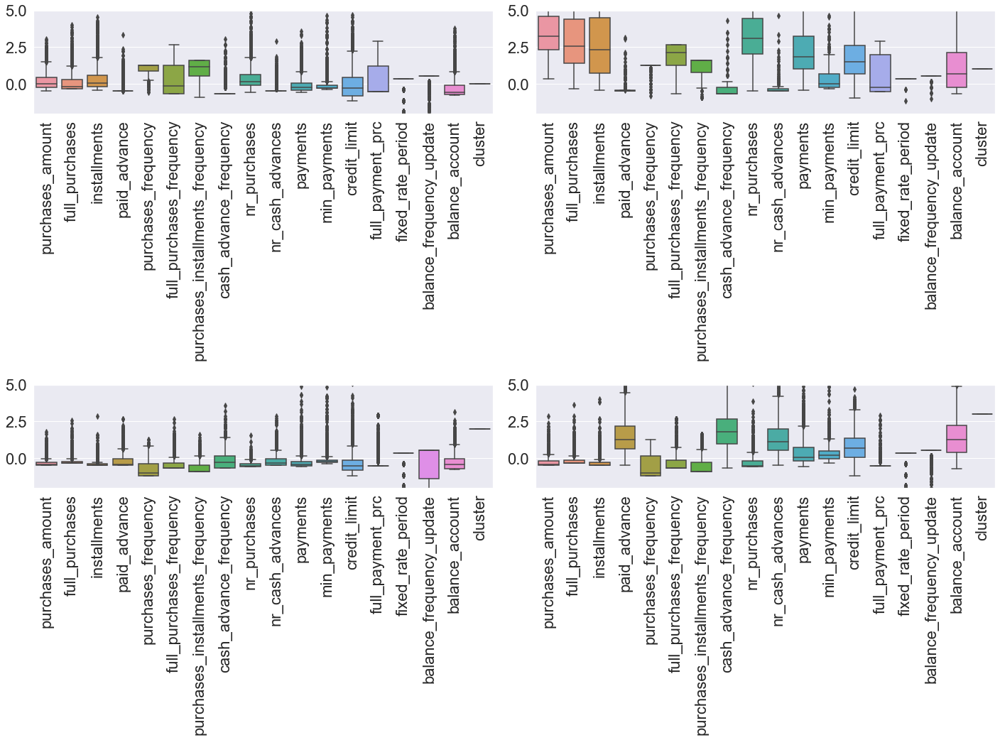

In [686]:
def plot_box_sns_clusters(data, clusters, variables, figsize, filename):
    df = data.copy()
    df=df[variables]
    fig = plt.figure(figsize=figsize)
    i = 0 
    for cls in clusters:
        ax = fig.add_subplot(2, 2, i+1)
        df_cls = df[df['cluster']==cls]
        sns.boxplot(data=df_cls, ax=ax)
        ax.set_ylim(ymin=-2,ymax=5)
        ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
        #ax.xticks(rotation=90)
        #plt.savefig(f'./figures/boxplot_{cls}_{filename}.png', bbox_inches="tight")
        #plt.show()  
        i = i+1
    
    fig.tight_layout()
    plt.savefig(f'./figures/boxplot_vsclusters_{filename}.png', bbox_inches="tight")
    plt.show()
    
    
vars_ = ['purchases_amount', 'full_purchases', 'installments', 'paid_advance', 
         'purchases_frequency', 'full_purchases_frequency', 'purchases_installments_frequency', 'cash_advance_frequency', 
         'nr_purchases', 'nr_cash_advances', 'payments', 'min_payments',
         'credit_limit', 'full_payment_prc','fixed_rate_period', 'balance_frequency_update','balance_account', 'cluster']
plot_box_sns_clusters(data_w_4cls_standard, [0, 1, 2, 3], vars_, (20,15), '4clusters_kmeans_standardscaler')




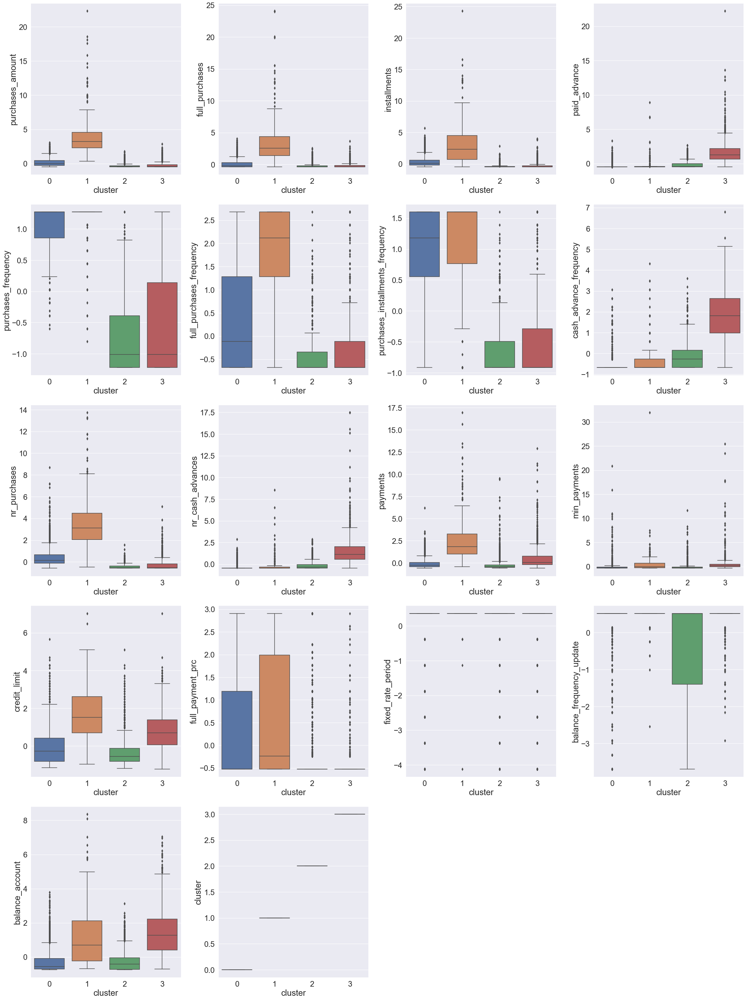

In [682]:
def plot_box_sns_ensemble(data, variables, outcome, figsize, filename):
    fig = plt.figure(figsize=figsize)
    i = 0 
    for v in variables:
        ax = fig.add_subplot(5, 4, i+1)
        sns.boxplot(x=outcome, y=v, data=data, ax=ax)
        #plt.xlabel(outcome)
        i=i+1
    fig.tight_layout()
    plt.savefig(f'./figures/boxplot_{v}_{filename}.png', bbox_inches="tight")
    plt.show()  



plot_box_sns_ensemble(data_w_4cls_standard, vars_, 'cluster', (30,40), '4clusters_ensemble_kmeans_standardscaler_box')

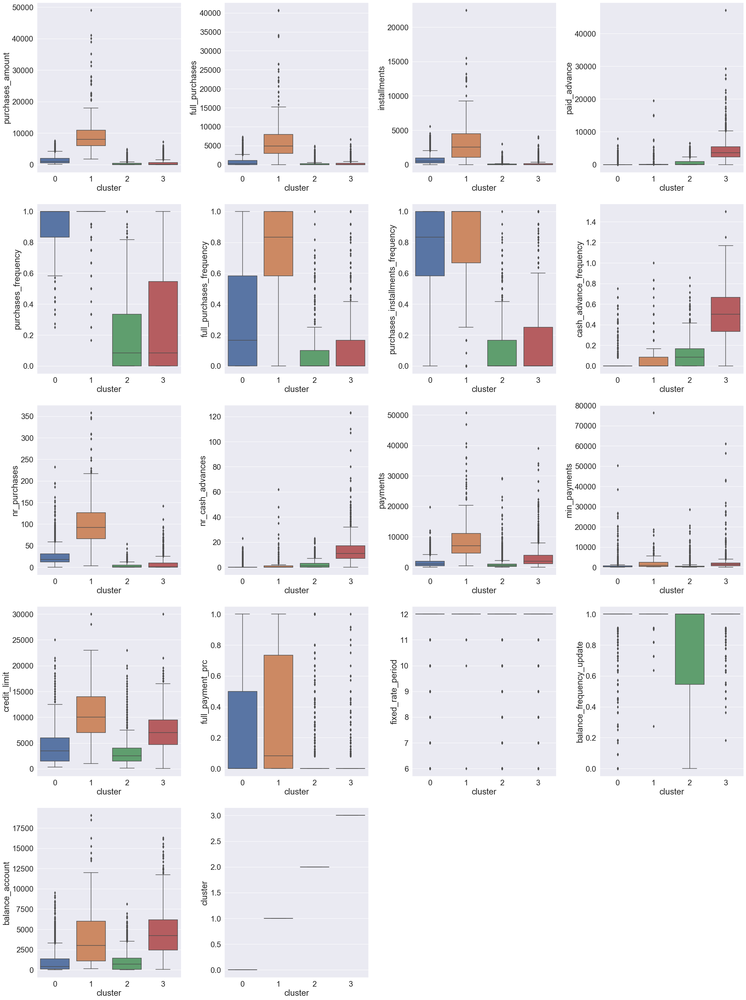

In [683]:
data_w_4cls_standard_notnorm = data_imp.copy()
data_w_4cls_standard_notnorm['cluster'] = cluster_labels_4
plot_box_sns_ensemble(data_w_4cls_standard_notnorm, vars_, 'cluster', (30,40), '4clusters_ensemble_kmeans_standardscaler_notnorm_box')

## Hiearchy

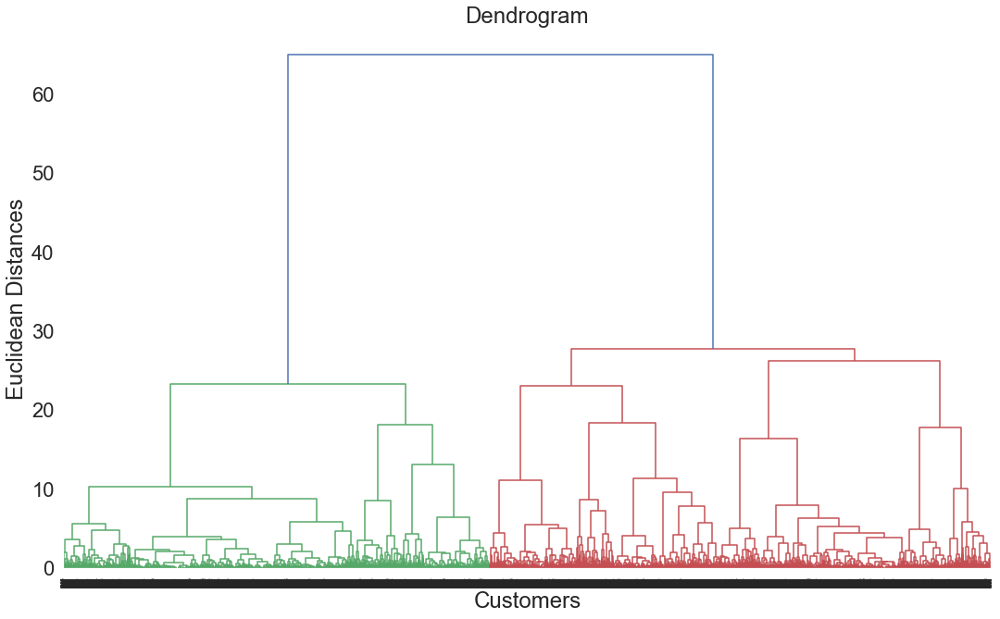

In [580]:
dendrogram = sch.dendrogram(sch.linkage(data_imp_scaled, method = 'ward'))
plt.title('Dendrogram')
plt.xlabel('Customers')
plt.ylabel('Euclidean Distances')
plt.show()

## DBSCAN

In [581]:
from sklearn.neighbors import NearestNeighbors
neigh = NearestNeighbors(n_neighbors=2*17)
nbrs = neigh.fit(data_imp_scaled)
distances, indices = nbrs.kneighbors(data_imp_scaled)

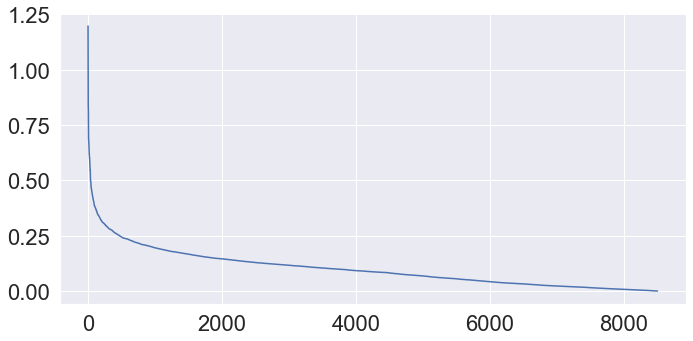

In [583]:
distances_ = np.sort(distances, axis=0,)
distances_ = distances[:,1]
distances_=sorted(distances_, reverse=True)
plt.figure(figsize=(10, 5))
plt.plot(distances_)

In [584]:
from sklearn.cluster import DBSCAN

# cluster the data into five clusters
dbscan = DBSCAN(eps=0.25, min_samples = 2*17)
clusters = dbscan.fit(data_imp_scaled)

In [586]:
db_scan_lbl=clusters.labels_
db_scan_idx=clusters.core_sample_indices_
data_dbscan = data_imp.copy()


In [587]:
np.unique(db_scan_lbl)

array([-1,  0,  1,  2,  3])

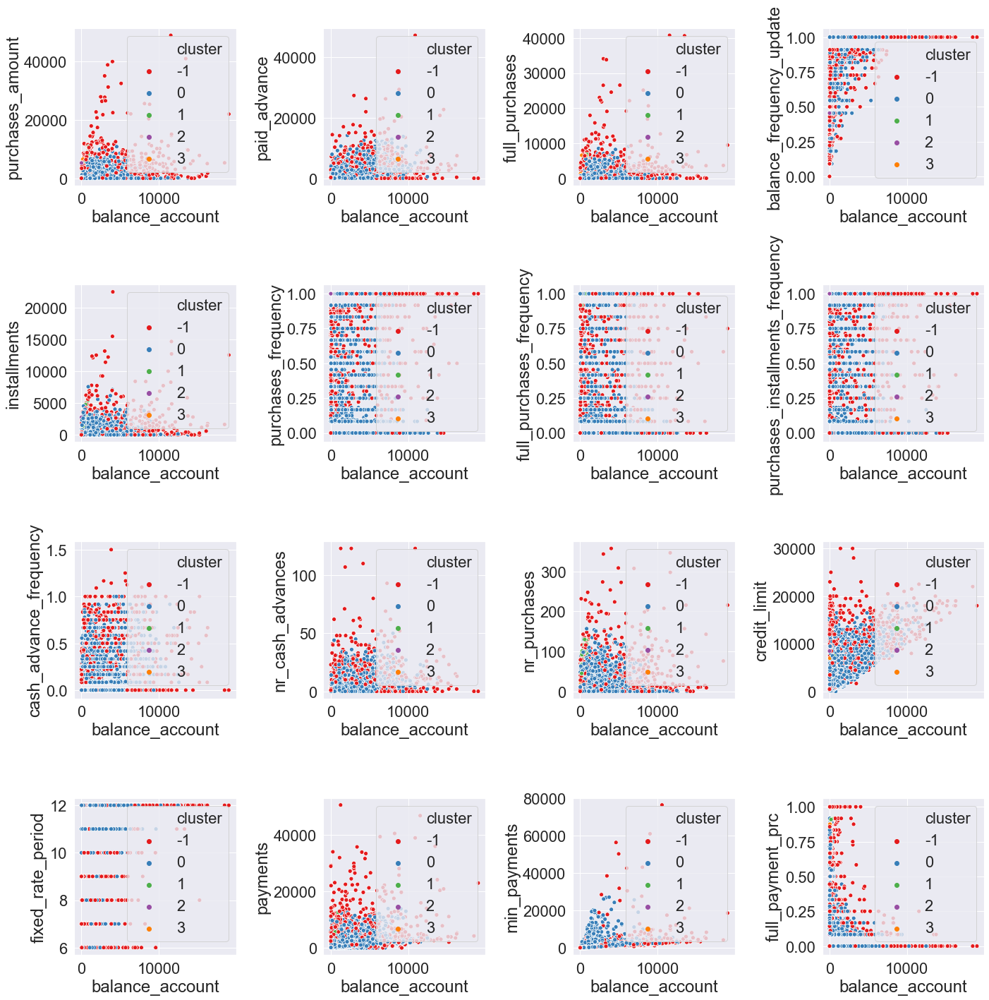

In [588]:
plot_2d_corr_features_nocenters(data_dbscan, db_scan_lbl, var_x, var_y, (20, 20), '_dbscan')

## PCA

In [589]:
pca = PCA(random_state=42)
pca_result = pca.fit_transform(data_imp_scaled)
pca_df = pd.DataFrame(pca_result, columns = [f'PCA_{x}' for x in range(len(data_imp_scaled.columns))])

In [590]:
expl_var_ratio = pca.explained_variance_ratio_
print('Explained variation per principal component: \n{}'.format(expl_var_ratio))

expl_var_ratio_sum = np.cumsum(expl_var_ratio)

Explained variation per principal component: 
[4.95778356e-01 1.40084518e-01 1.28148589e-01 7.68645030e-02
 6.99906949e-02 3.61002355e-02 1.82641103e-02 1.35719893e-02
 6.56414603e-03 5.60757380e-03 2.83500308e-03 1.87011122e-03
 1.28246044e-03 1.23666200e-03 1.08084138e-03 7.20172919e-04
 3.29100195e-08]


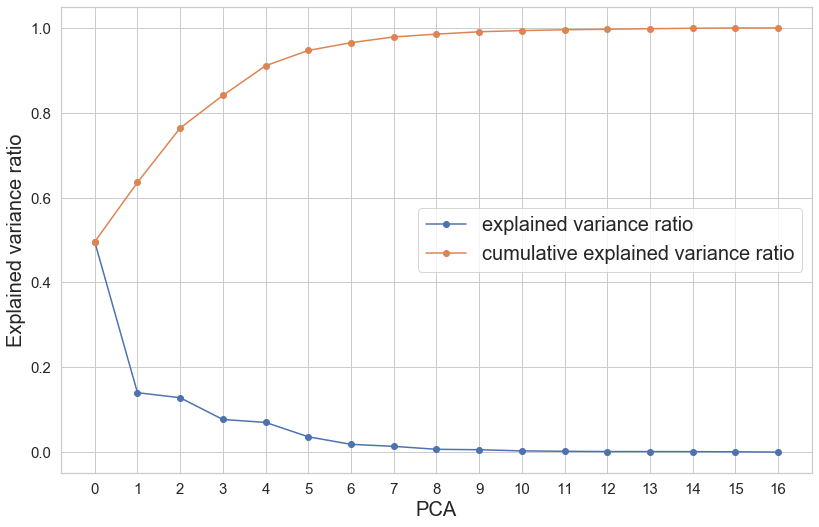

In [591]:
ex_var_df = pd.DataFrame(
    {"pca": [f'{x}' for x in range(len(data_imp_scaled.columns))], "exp_var_ratio": expl_var_ratio})
sns.set(style="whitegrid")
plt.figure(figsize=(12, 8))
plt.plot(ex_var_df.pca, ex_var_df.exp_var_ratio, marker="o", label='explained variance ratio')
plt.plot(ex_var_df.pca, expl_var_ratio_sum, marker="o", label='cumulative explained variance ratio')
plt.tick_params(labelsize=15)
plt.xlabel("PCA", fontsize=20)
plt.ylabel("Explained variance ratio", fontsize=20)
plt.legend(loc='best', fontsize=20)
plt.savefig('./figures/explained_variance_ratio.png', bbox_inches="tight")
plt.show()

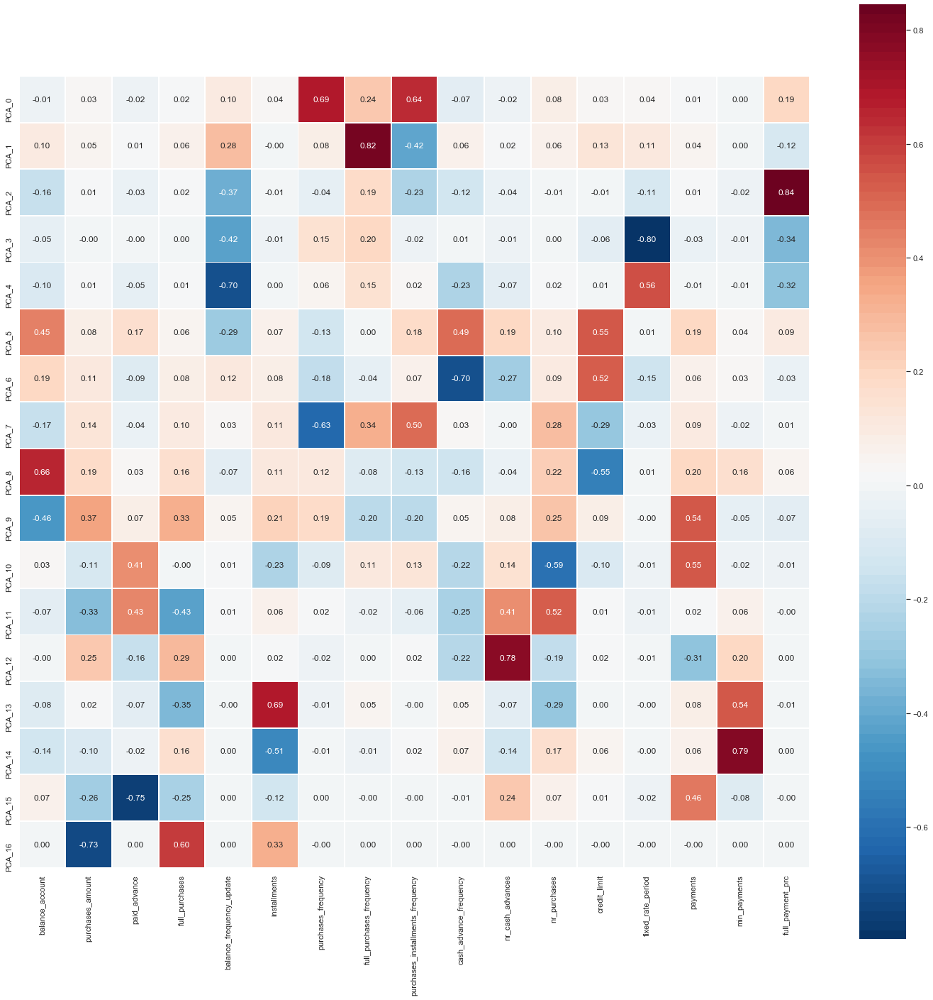

In [592]:
# Dump components relations with features:
df_pca_features = pd.DataFrame(pca.components_,columns=data_imp_scaled.columns,index = pca_df.columns)
#print(df_pca_features.head(10))
fig, ax = plt.subplots(figsize=(20, 20))
sns.heatmap(df_pca_features, annot=True, fmt='.2f', linewidths=.9, square=True, ax=ax, cmap=sns.color_palette("RdBu_r", 100))#sns.diverging_palette(220,
fig.tight_layout()

In [593]:
df_pca_features

,balance_account,purchases_amount,paid_advance,full_purchases,balance_frequency_update,installments,purchases_frequency,full_purchases_frequency,purchases_installments_frequency,cash_advance_frequency,nr_cash_advances,nr_purchases,credit_limit,fixed_rate_period,payments,min_payments,full_payment_prc
PCA_0,-0.014440,0.032907,-0.016668,0.019976,0.102947,0.035545,0.685539,0.243035,0.637472,-0.074152,-0.020272,0.075064,0.029123,0.035647,0.013708,0.000214,0.192144
PCA_1,0.102758,0.047476,0.013756,0.058062,0.276588,-0.001745,0.079457,0.818268,-0.419487,0.058929,0.020210,0.063797,0.131149,0.113735,0.042544,0.004277,-0.123946
PCA_2,-0.161346,0.010959,-0.026839,0.016102,-0.372770,-0.005288,-0.043460,0.185206,-0.231871,-0.124361,-0.040009,-0.007788,-0.008178,-0.111338,0.009528,-0.022308,0.844837
PCA_3,-0.052849,-0.000876,-0.004602,0.004984,-0.422182,-0.010946,0.148463,0.196798,-0.016126,0.005729,-0.009322,0.002618,-0.064204,-0.797405,-0.026526,-0.010104,-0.341853
PCA_4,-0.097324,0.008993,-0.048669,0.009757,-0.701076,0.001936,0.056424,0.146214,0.024312,-0.232826,-0.068436,0.023019,0.006564,0.558468,-0.005115,-0.008052,-0.316033
PCA_5,0.447358,0.076186,0.168896,0.055413,-0.286255,0.065661,-0.125372,0.001791,0.179640,0.485831,0.192344,0.098078,0.547669,0.005123,0.188843,0.039164,0.091733
PCA_6,0.191698,0.106531,-0.091079,0.082774,0.118452,0.082258,-0.176446,-0.042902,0.066945,-0.704334,-0.265519,0.092834,0.523993,-0.154382,0.057204,0.028677,-0.028320
PCA_7,-0.172218,0.137126,-0.039521,0.102205,0.033939,0.113733,-0.625513,0.335621,0.499037,0.029950,-0.000973,0.279495,-0.288424,-0.032723,0.093562,-0.020377,0.007267
PCA_8,0.659604,0.185646,0.032027,0.160752,-0.066824,0.113421,0.119476,-0.084087,-0.133180,-0.156139,-0.039339,0.224388,-0.547116,0.006355,0.203461,0.164441,0.055579
PCA_9,-0.461746,0.367772,0.074864,0.325038,0.046496,0.212884,0.187689,-0.200638,-0.198668,0.050427,0.081927,0.254399,0.088379,-0.000908,0.537389,-0.050393,-0.068817


In [594]:
df_pca_features_t=df_pca_features.T
df_pca_features_t['sum'] = df_pca_features_t.sum(axis=1)

In [595]:
df_pca_features_t.head()

,PCA_0,PCA_1,PCA_2,PCA_3,PCA_4,PCA_5,PCA_6,PCA_7,PCA_8,PCA_9,PCA_10,PCA_11,PCA_12,PCA_13,PCA_14,PCA_15,PCA_16,sum
balance_account,-0.014440,0.102758,-0.161346,-0.052849,-0.097324,0.447358,0.191698,-0.172218,0.659604,-0.461746,0.026538,-0.073013,-0.003921,-0.079287,-0.138570,0.067624,0.000018,0.240882
purchases_amount,0.032907,0.047476,0.010959,-0.000876,0.008993,0.076186,0.106531,0.137126,0.185646,0.367772,-0.110798,-0.331509,0.249840,0.022767,-0.101241,-0.263597,-0.725216,-0.287034
paid_advance,-0.016668,0.013756,-0.026839,-0.004602,-0.048669,0.168896,-0.091079,-0.039521,0.032027,0.074864,0.407695,0.433388,-0.161557,-0.073107,-0.020365,-0.752004,0.000023,-0.103761
full_purchases,0.019976,0.058062,0.016102,0.004984,0.009757,0.055413,0.082774,0.102205,0.160752,0.325038,-0.004990,-0.431519,0.289429,-0.351171,0.160097,-0.248115,0.602890,0.851684
balance_frequency_update,0.102947,0.276588,-0.372770,-0.422182,-0.701076,-0.286255,0.118452,0.033939,-0.066824,0.046496,0.014591,0.014641,0.002152,-0.001877,0.003123,0.001383,0.000002,-1.236670


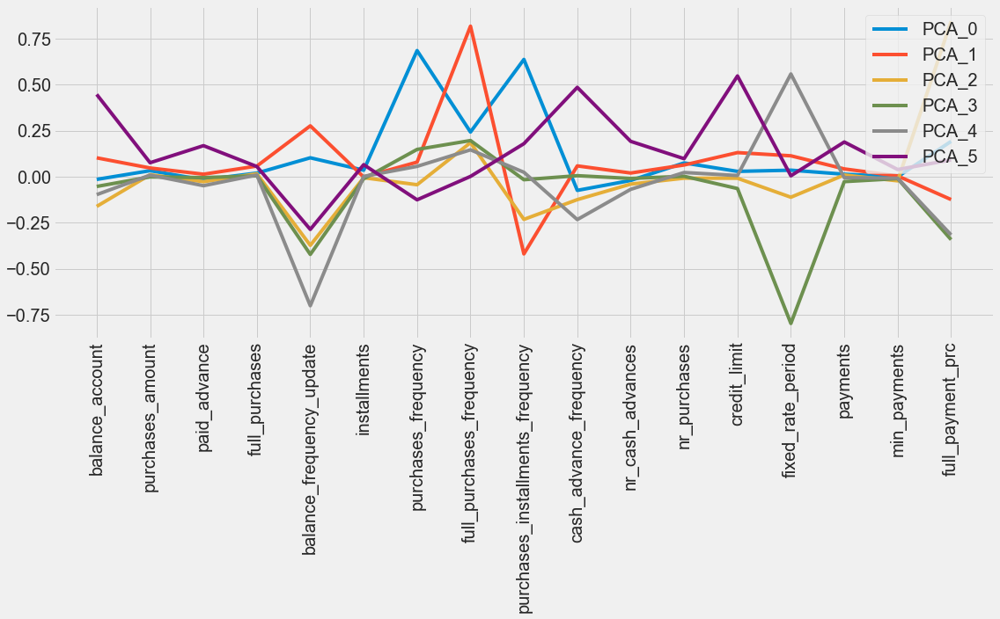

In [596]:
plt.style.use('fivethirtyeight')
plt.rc('legend', fontsize=20)
fig, ax = plt.subplots()
ax.plot(df_pca_features_t['PCA_0'], label='PCA_0')
ax.plot(df_pca_features_t['PCA_1'], label='PCA_1')
ax.plot(df_pca_features_t['PCA_2'], label='PCA_2')
ax.plot(df_pca_features_t['PCA_3'], label='PCA_3')
ax.plot(df_pca_features_t['PCA_4'], label='PCA_4')
ax.plot(df_pca_features_t['PCA_5'], label='PCA_5')
ax.legend(loc='best')
plt.xticks(rotation=90)
#ax.set_title("'fivethirtyeight' style sheet")
for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] +
             ax.get_xticklabels() + ax.get_yticklabels()):
    item.set_fontsize(20)

fig.tight_layout()
plt.show()


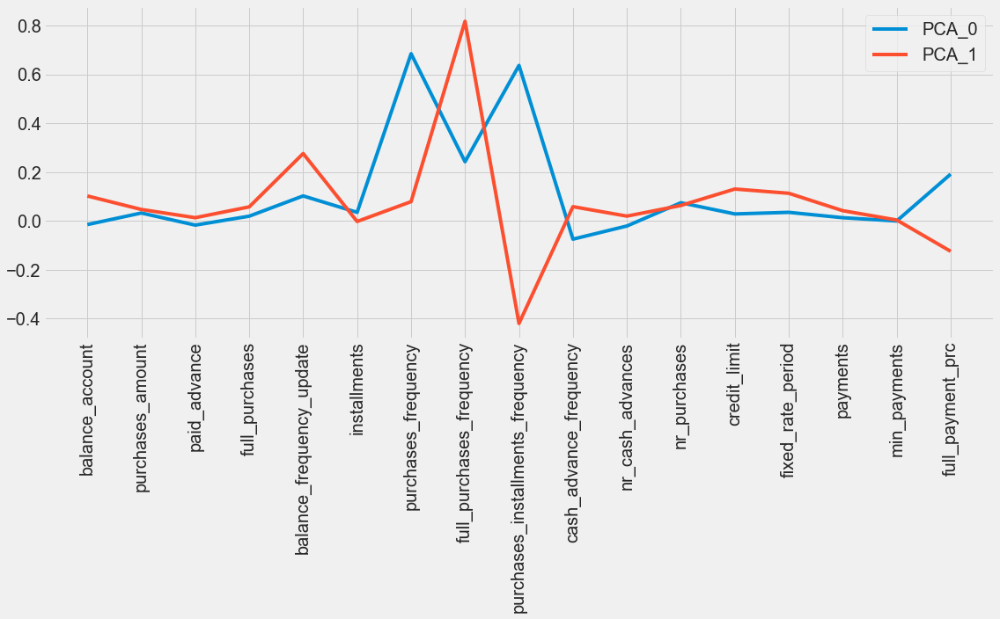

In [597]:
plt.style.use('fivethirtyeight')
plt.rc('legend', fontsize=20)
fig, ax = plt.subplots()
ax.plot(df_pca_features_t['PCA_0'], label='PCA_0')
ax.plot(df_pca_features_t['PCA_1'], label='PCA_1')
ax.legend(loc='best')
plt.xticks(rotation=90)
#ax.set_title("'fivethirtyeight' style sheet")
for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] +
             ax.get_xticklabels() + ax.get_yticklabels()):
    item.set_fontsize(20)

fig.tight_layout()
plt.show()

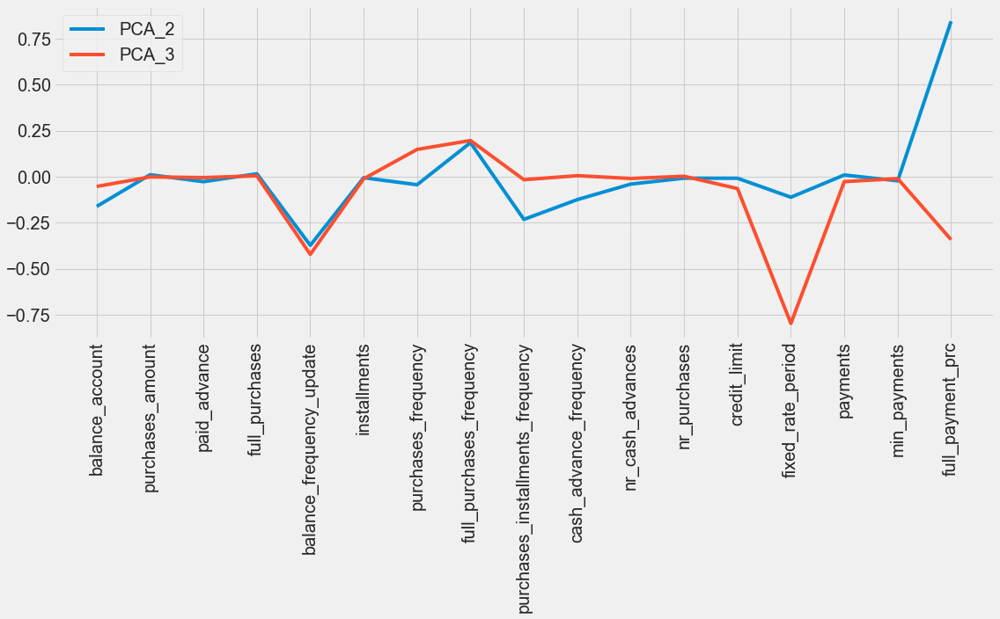

In [598]:
plt.style.use('fivethirtyeight')
plt.rc('legend', fontsize=20)
fig, ax = plt.subplots()
ax.plot(df_pca_features_t['PCA_2'], label='PCA_2')
ax.plot(df_pca_features_t['PCA_3'], label='PCA_3')
ax.legend(loc='best')
plt.xticks(rotation=90)
#ax.set_title("'fivethirtyeight' style sheet")
for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] +
             ax.get_xticklabels() + ax.get_yticklabels()):
    item.set_fontsize(20)
fig.tight_layout()
plt.show()

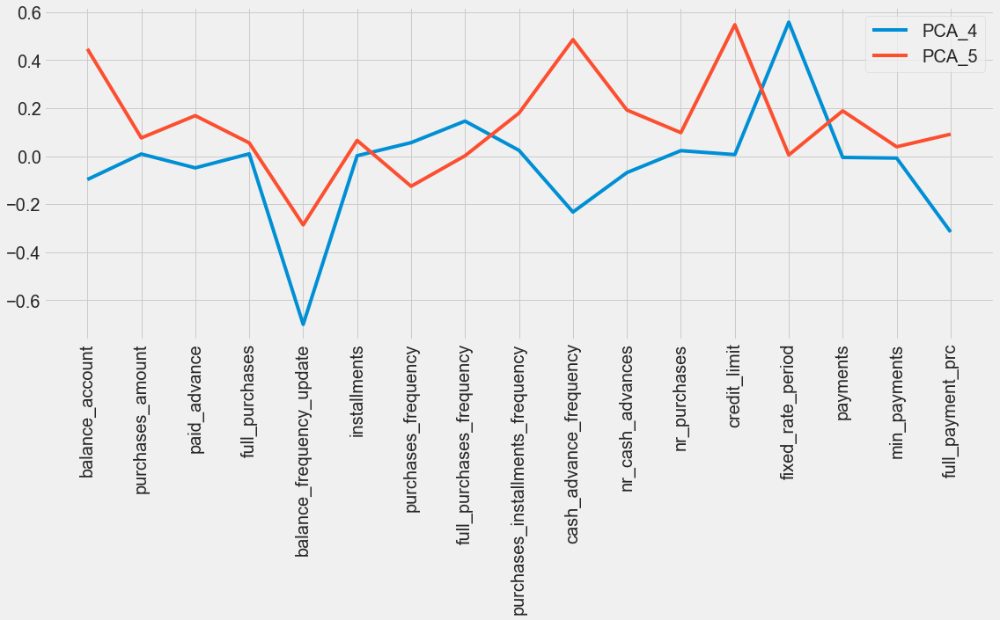

In [599]:
plt.style.use('fivethirtyeight')
plt.rc('legend', fontsize=20)
fig, ax = plt.subplots()
ax.plot(df_pca_features_t['PCA_4'], label='PCA_4')
ax.plot(df_pca_features_t['PCA_5'], label='PCA_5')
ax.legend(loc='best')
plt.xticks(rotation=90)
#ax.set_title("'fivethirtyeight' style sheet")
for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] +
             ax.get_xticklabels() + ax.get_yticklabels()):
    item.set_fontsize(20)
fig.tight_layout()
plt.show()

## K-means PCA first 4

In [600]:
scaler = StandardScaler()
pca_df_scaled = pd.DataFrame(scaler.fit_transform(pca_df), columns=pca_df.columns)

For n_clusters = 2 the average silhouette_score is : 0.2826571762561798
For n_clusters = 3 the average silhouette_score is : 0.3401064872741699
For n_clusters = 4 the average silhouette_score is : 0.3754035532474518
For n_clusters = 5 the average silhouette_score is : 0.41534745693206787
For n_clusters = 6 the average silhouette_score is : 0.43214428424835205
For n_clusters = 7 the average silhouette_score is : 0.4236224293708801
For n_clusters = 8 the average silhouette_score is : 0.4260137975215912
For n_clusters = 9 the average silhouette_score is : 0.4200075566768646


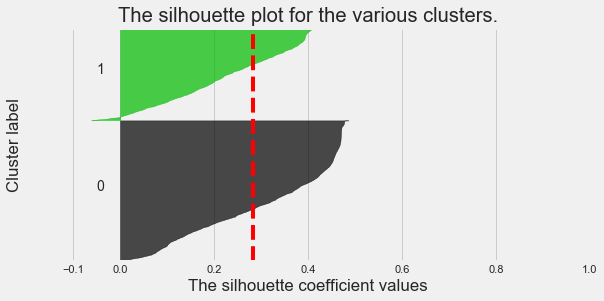

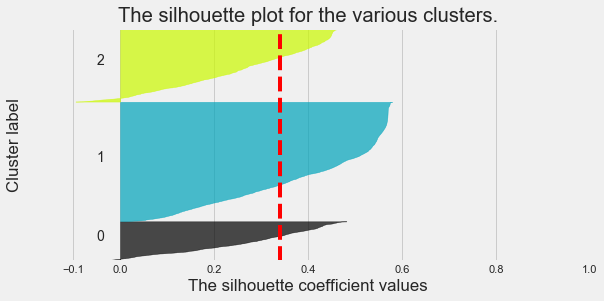

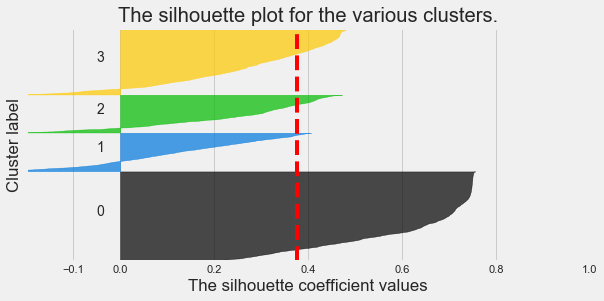

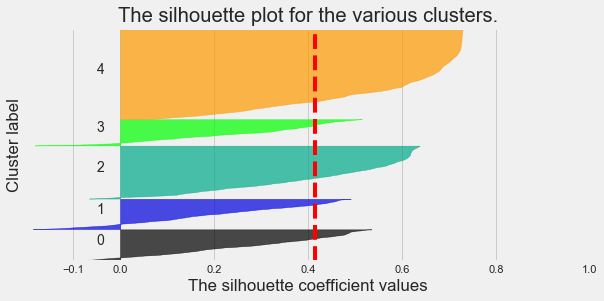

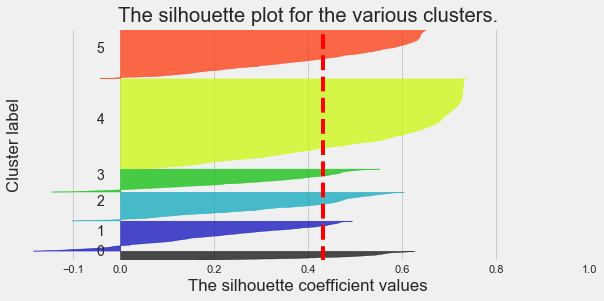

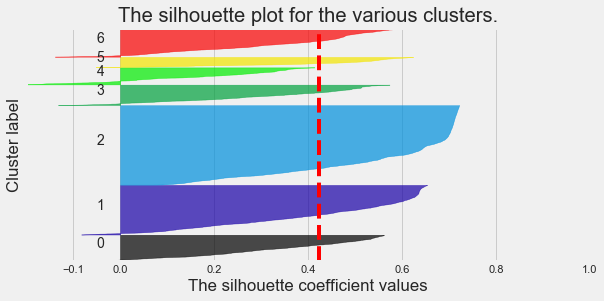

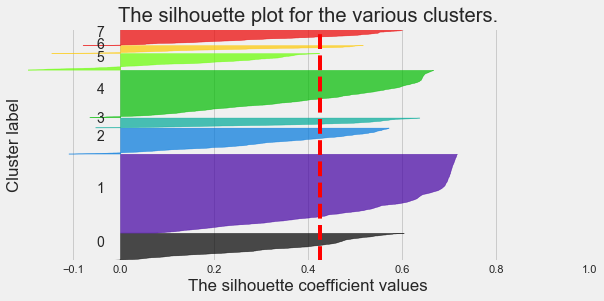

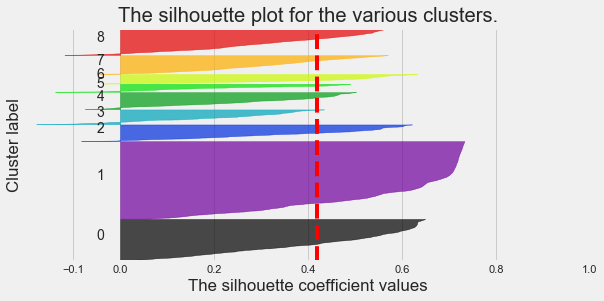

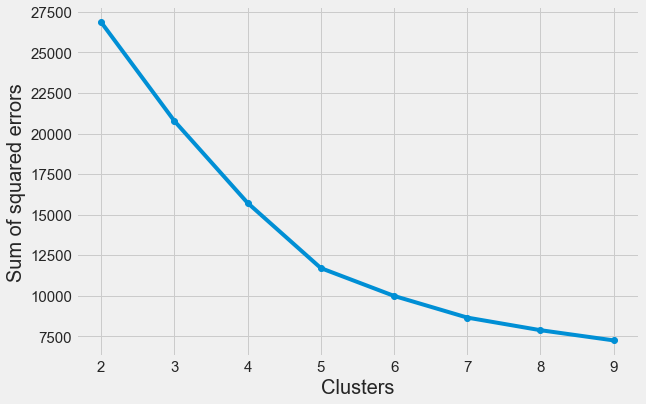

In [601]:
pca_sel = ['PCA_0','PCA_1','PCA_2','PCA_3']
pca_df_80 = pca_df_scaled[pca_sel]
make_silhouette_plot(cluster_range, pca_df_80,'kmeans_std_scaled_pca')

### 4 clusters

In [602]:
clusterer_pca_4 = KMeans(n_clusters=4, random_state=10)
cluster_labels_pca_4 = clusterer_pca_4.fit_predict(pca_df_80)

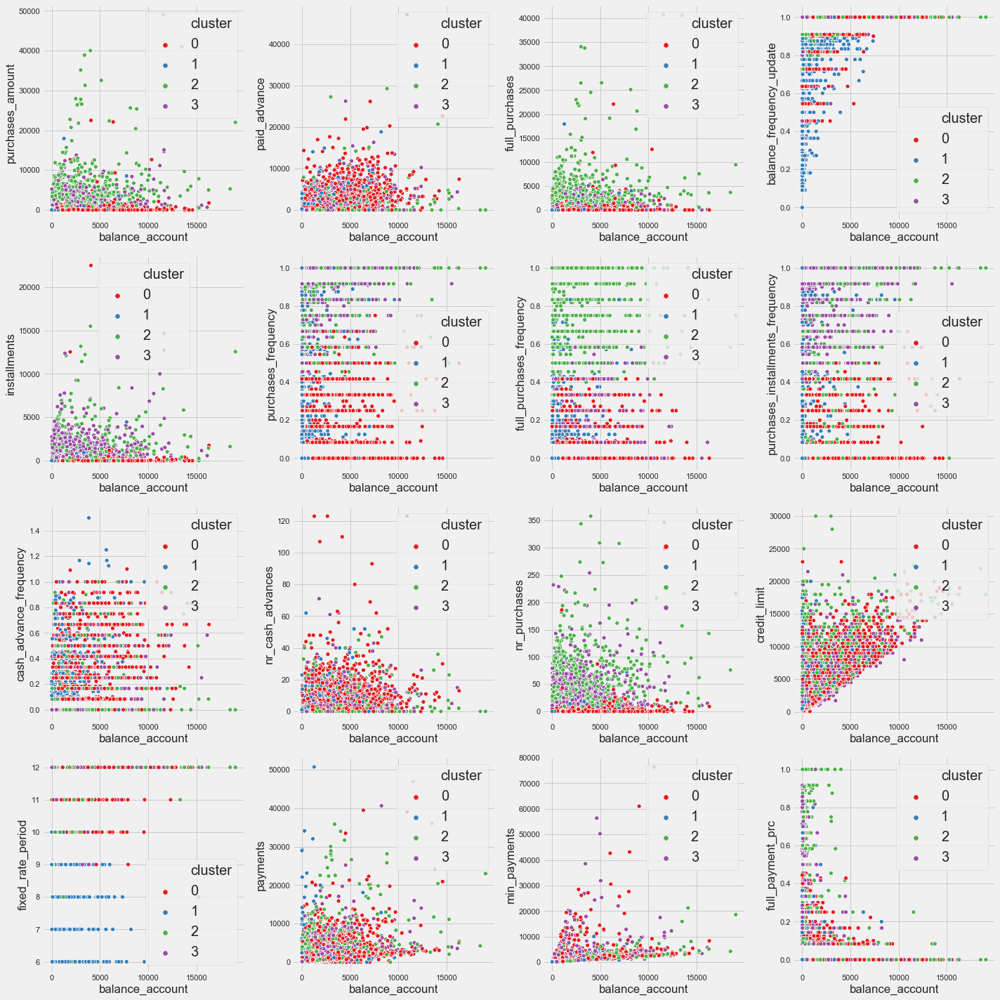

In [603]:
data_pca_4 = data_imp.copy()
plot_2d_corr_features_nocenters(data_pca_4, cluster_labels_pca_4, var_x, var_y, (20, 20), '_pca_4feat_kmeans4')

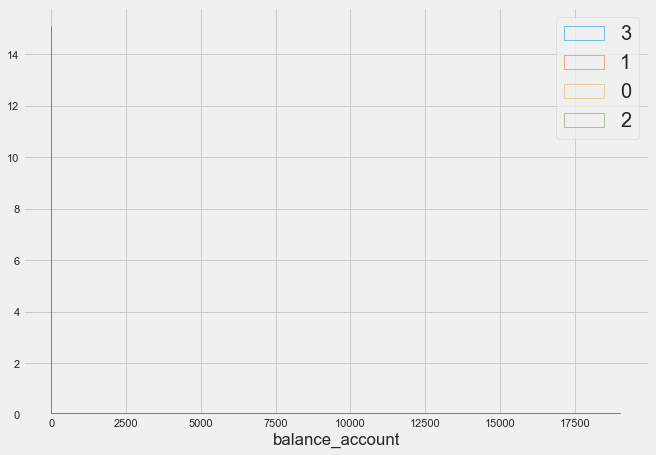

/Users/andrea/anaconda3/envs/propy_env/lib/python3.7/site-packages/numpy/lib/histograms.py:908: RuntimeWarning: invalid value encountered in true_divide
  return n/db/n.sum(), bin_edges
/Users/andrea/anaconda3/envs/propy_env/lib/python3.7/site-packages/numpy/lib/histograms.py:908: RuntimeWarning: invalid value encountered in true_divide
  return n/db/n.sum(), bin_edges


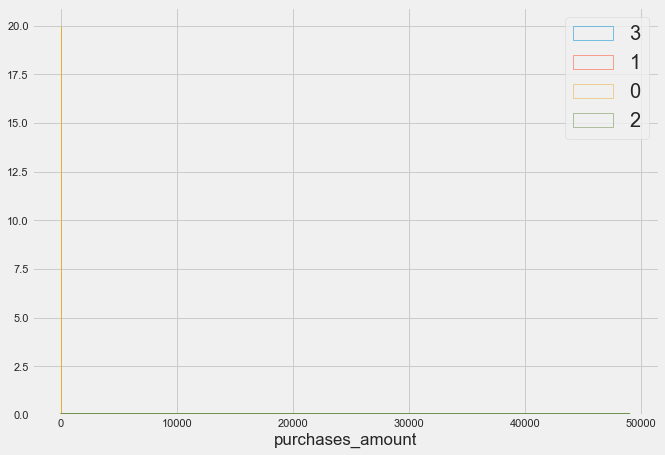

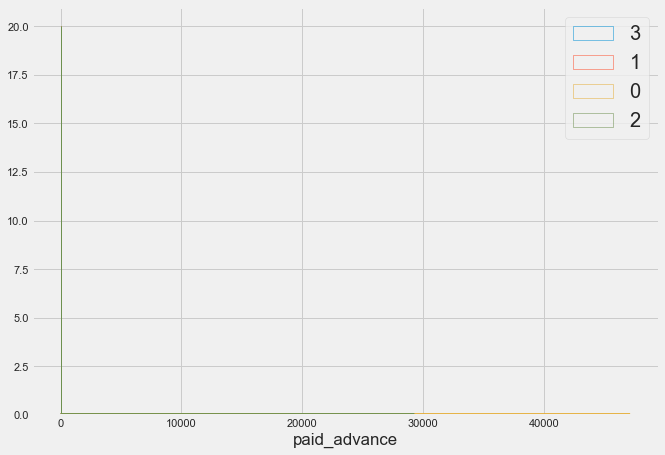

/Users/andrea/anaconda3/envs/propy_env/lib/python3.7/site-packages/numpy/lib/histograms.py:908: RuntimeWarning: invalid value encountered in true_divide
  return n/db/n.sum(), bin_edges


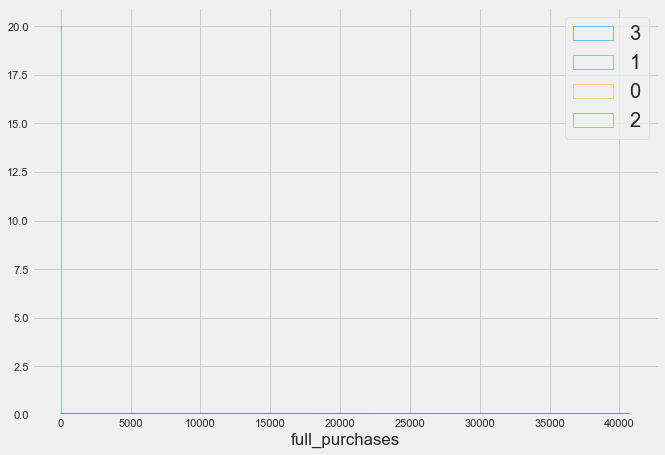

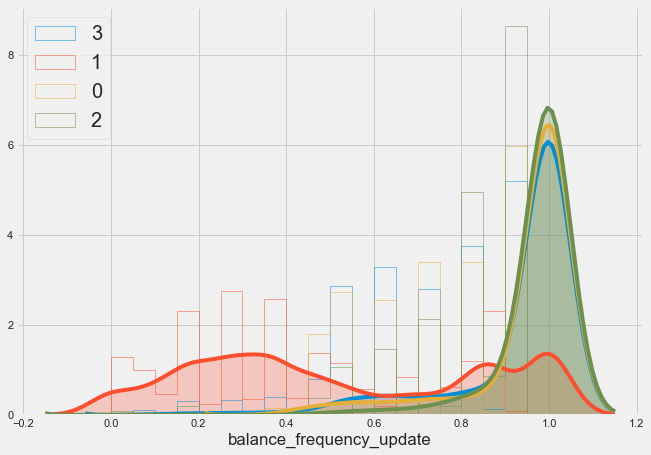

/Users/andrea/anaconda3/envs/propy_env/lib/python3.7/site-packages/numpy/lib/histograms.py:908: RuntimeWarning: invalid value encountered in true_divide
  return n/db/n.sum(), bin_edges


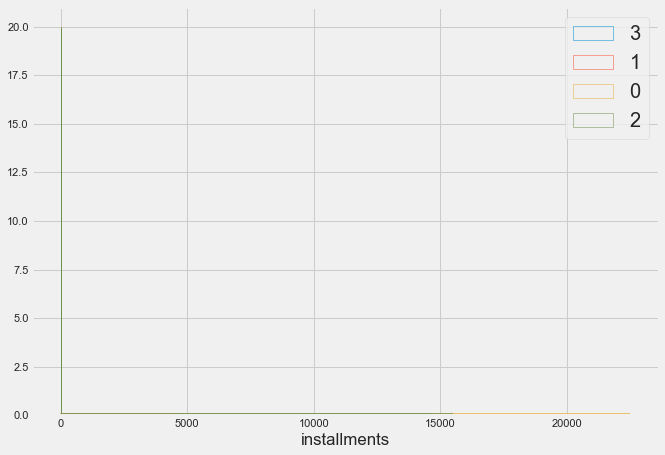

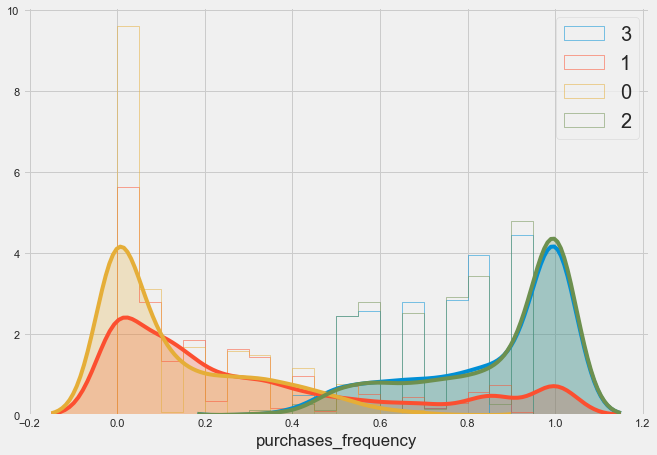

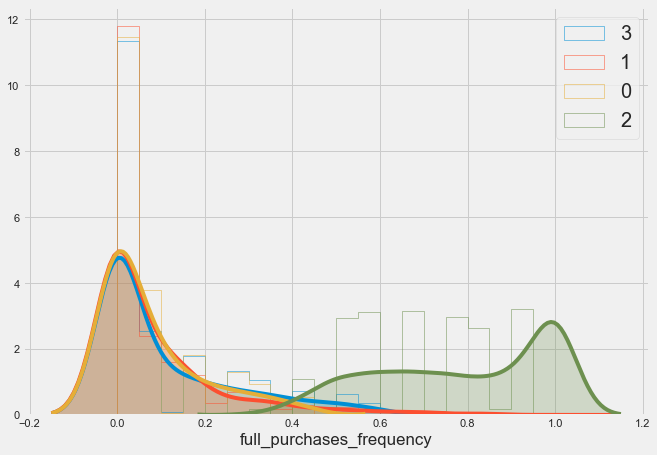

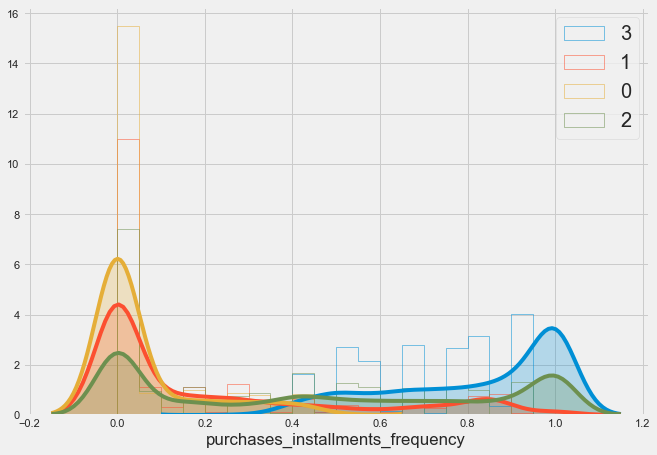

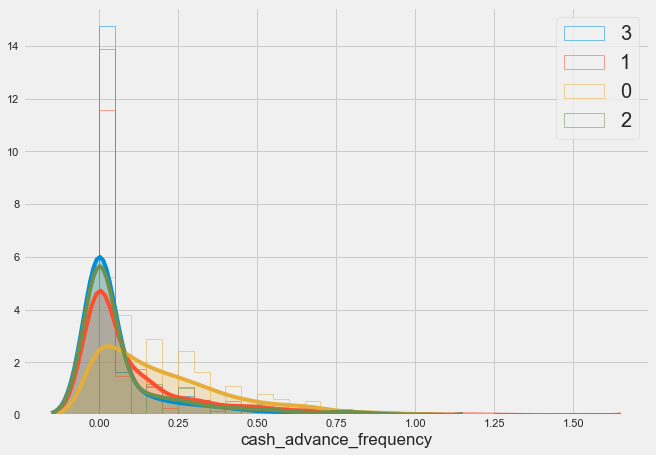

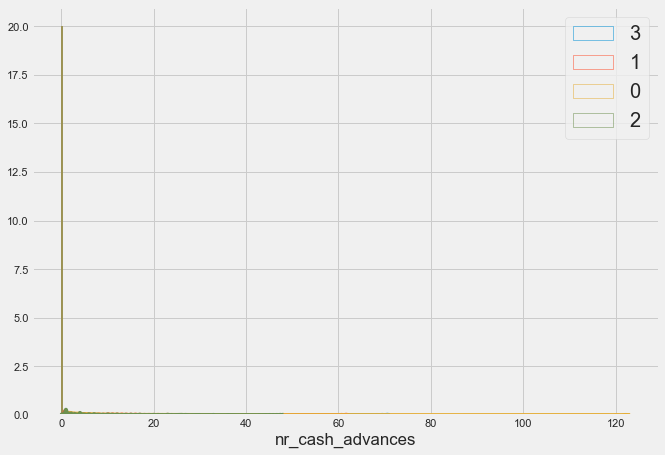

/Users/andrea/anaconda3/envs/propy_env/lib/python3.7/site-packages/numpy/lib/histograms.py:908: RuntimeWarning: invalid value encountered in true_divide
  return n/db/n.sum(), bin_edges


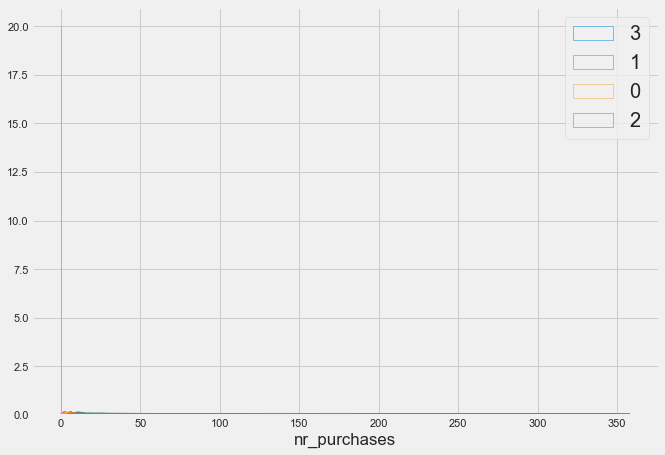

/Users/andrea/anaconda3/envs/propy_env/lib/python3.7/site-packages/numpy/lib/histograms.py:908: RuntimeWarning: invalid value encountered in true_divide
  return n/db/n.sum(), bin_edges
/Users/andrea/anaconda3/envs/propy_env/lib/python3.7/site-packages/numpy/lib/histograms.py:908: RuntimeWarning: invalid value encountered in true_divide
  return n/db/n.sum(), bin_edges
/Users/andrea/anaconda3/envs/propy_env/lib/python3.7/site-packages/numpy/lib/histograms.py:908: RuntimeWarning: invalid value encountered in true_divide
  return n/db/n.sum(), bin_edges
/Users/andrea/anaconda3/envs/propy_env/lib/python3.7/site-packages/numpy/lib/histograms.py:908: RuntimeWarning: invalid value encountered in true_divide
  return n/db/n.sum(), bin_edges


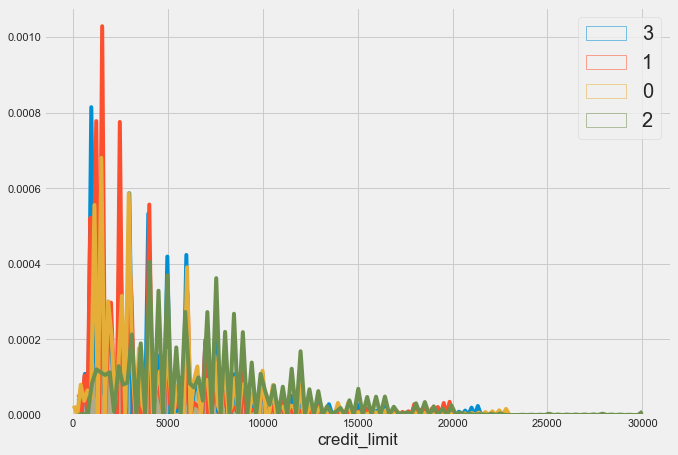

/Users/andrea/anaconda3/envs/propy_env/lib/python3.7/site-packages/numpy/lib/histograms.py:908: RuntimeWarning: invalid value encountered in true_divide
  return n/db/n.sum(), bin_edges
/Users/andrea/anaconda3/envs/propy_env/lib/python3.7/site-packages/numpy/lib/histograms.py:908: RuntimeWarning: invalid value encountered in true_divide
  return n/db/n.sum(), bin_edges
/Users/andrea/anaconda3/envs/propy_env/lib/python3.7/site-packages/numpy/lib/histograms.py:908: RuntimeWarning: invalid value encountered in true_divide
  return n/db/n.sum(), bin_edges
/Users/andrea/anaconda3/envs/propy_env/lib/python3.7/site-packages/numpy/lib/histograms.py:908: RuntimeWarning: invalid value encountered in true_divide
  return n/db/n.sum(), bin_edges


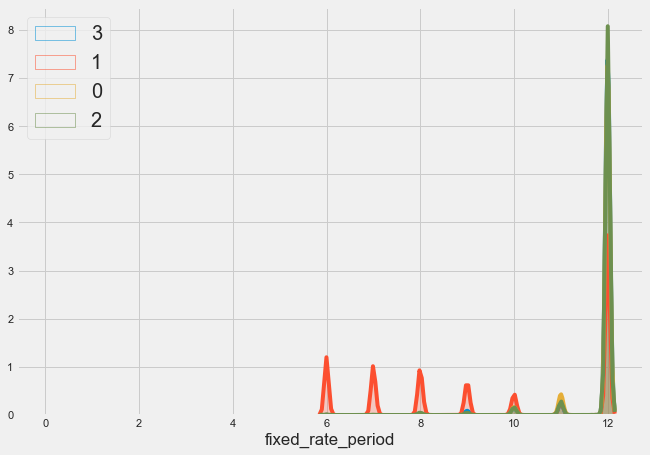

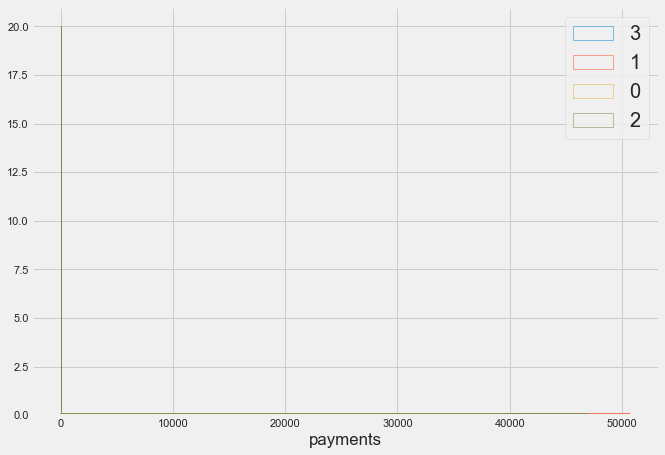

/Users/andrea/anaconda3/envs/propy_env/lib/python3.7/site-packages/numpy/lib/histograms.py:908: RuntimeWarning: invalid value encountered in true_divide
  return n/db/n.sum(), bin_edges


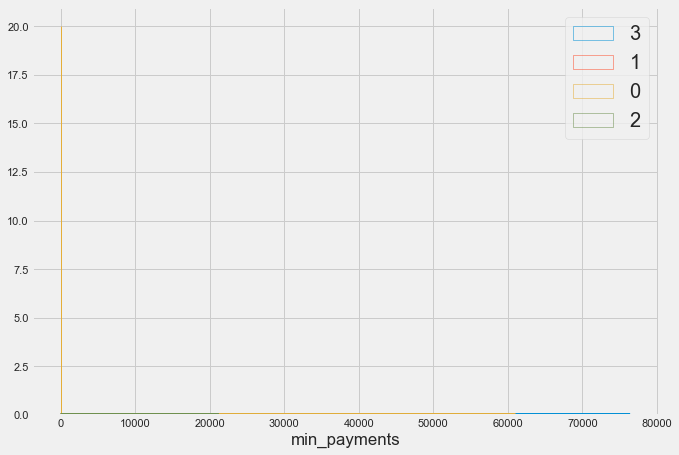

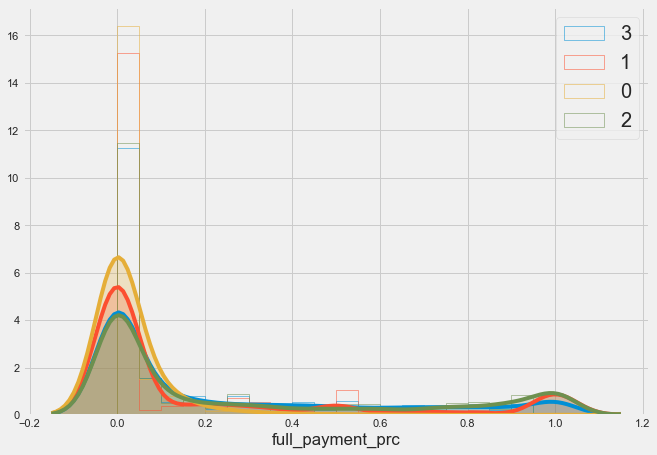

In [604]:
variables=data_pca_4.columns
data_pca_4['cluster'] = cluster_labels_pca_4
plot_numeric_distrib_sns(data_pca_4, variables, 'cluster', (10,7), '4clusters_pca_kmeans')

In [605]:
data_pca_4.columns

Index(['balance_account', 'purchases_amount', 'paid_advance', 'full_purchases',
       'balance_frequency_update', 'installments', 'purchases_frequency',
       'full_purchases_frequency', 'purchases_installments_frequency',
       'cash_advance_frequency', 'nr_cash_advances', 'nr_purchases',
       'credit_limit', 'fixed_rate_period', 'payments', 'min_payments',
       'full_payment_prc', 'cluster'],
      dtype='object')

### 3 clusters

In [627]:
clusterer_pca_3 = KMeans(n_clusters=3, random_state=10)
cluster_labels_pca_3 = clusterer_pca_3.fit_predict(pca_df_80)

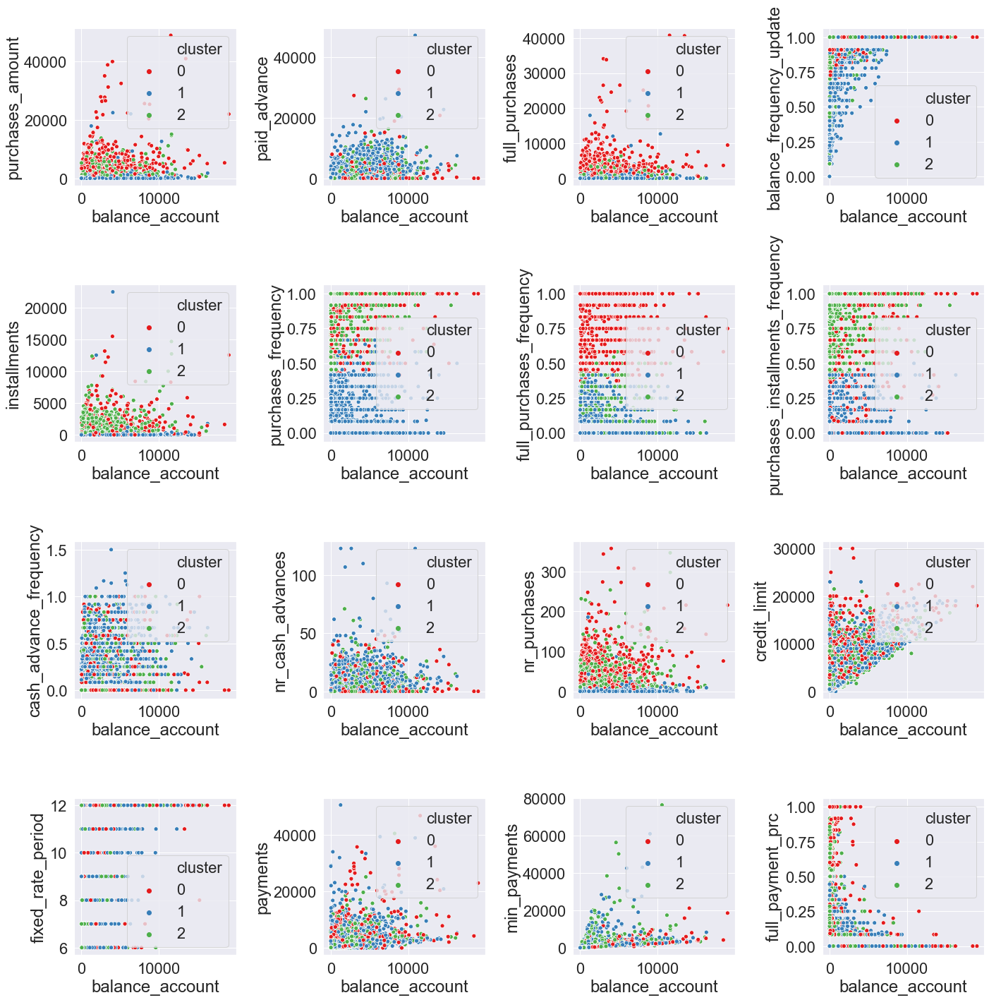

In [628]:
data_pca_4_3cls = data_imp.copy()
plot_2d_corr_features_nocenters(data_pca_4_3cls, cluster_labels_pca_3, var_x, var_y, (20, 20), '_pca_4feat_kmeans3')


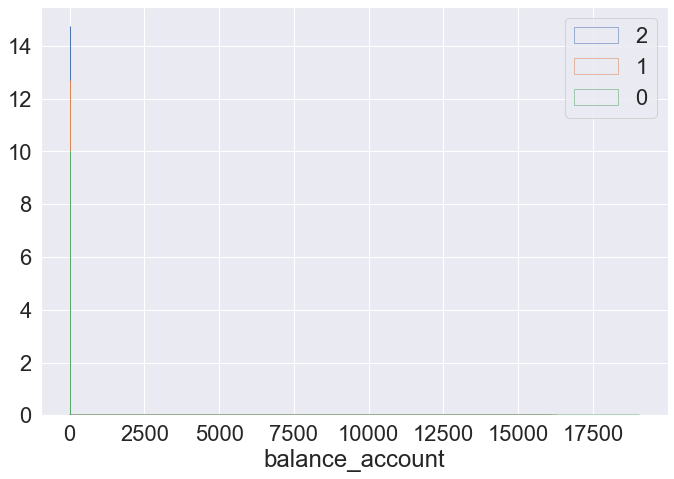

/Users/andrea/anaconda3/envs/propy_env/lib/python3.7/site-packages/numpy/lib/histograms.py:908: RuntimeWarning: invalid value encountered in true_divide
  return n/db/n.sum(), bin_edges
/Users/andrea/anaconda3/envs/propy_env/lib/python3.7/site-packages/numpy/lib/histograms.py:908: RuntimeWarning: invalid value encountered in true_divide
  return n/db/n.sum(), bin_edges


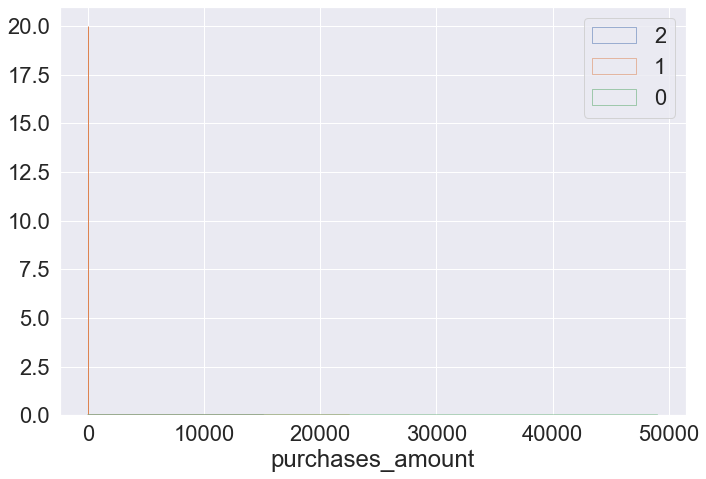

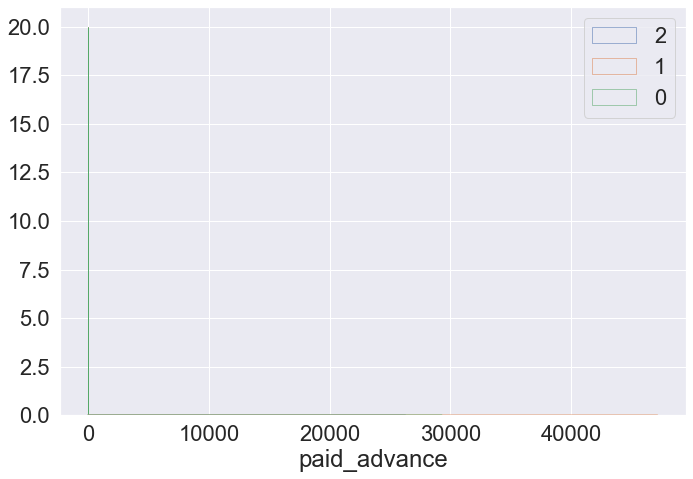

/Users/andrea/anaconda3/envs/propy_env/lib/python3.7/site-packages/numpy/lib/histograms.py:908: RuntimeWarning: invalid value encountered in true_divide
  return n/db/n.sum(), bin_edges


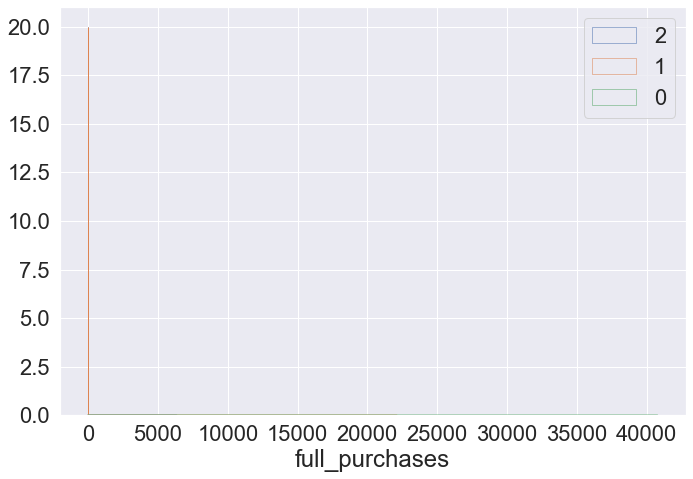

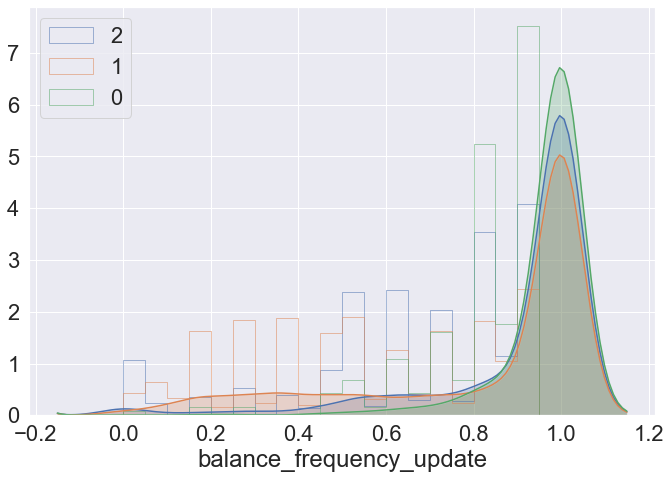

/Users/andrea/anaconda3/envs/propy_env/lib/python3.7/site-packages/numpy/lib/histograms.py:908: RuntimeWarning: invalid value encountered in true_divide
  return n/db/n.sum(), bin_edges


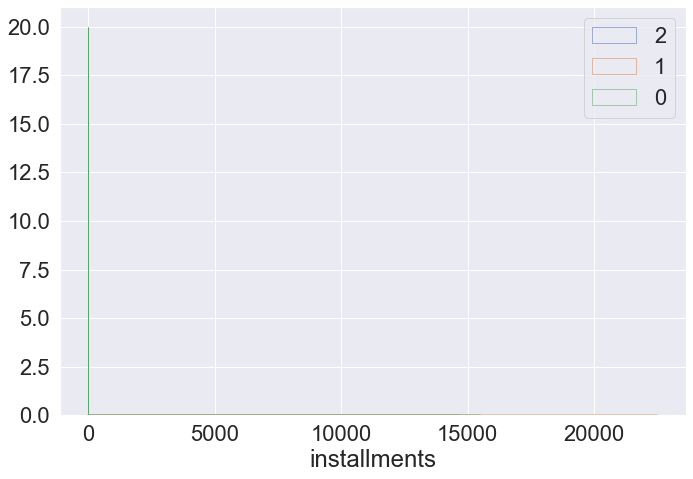

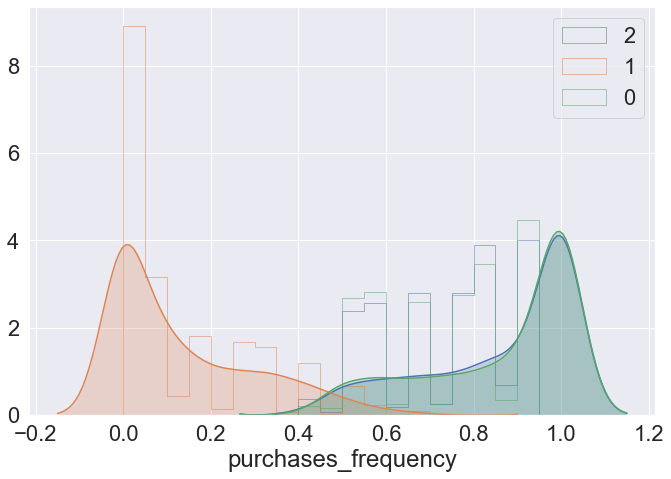

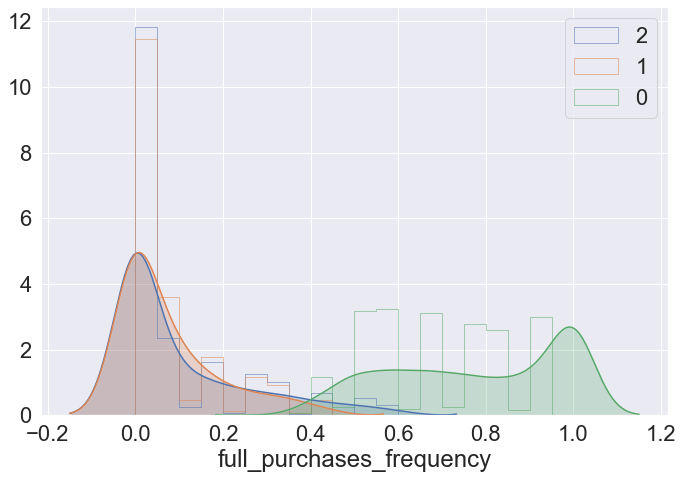

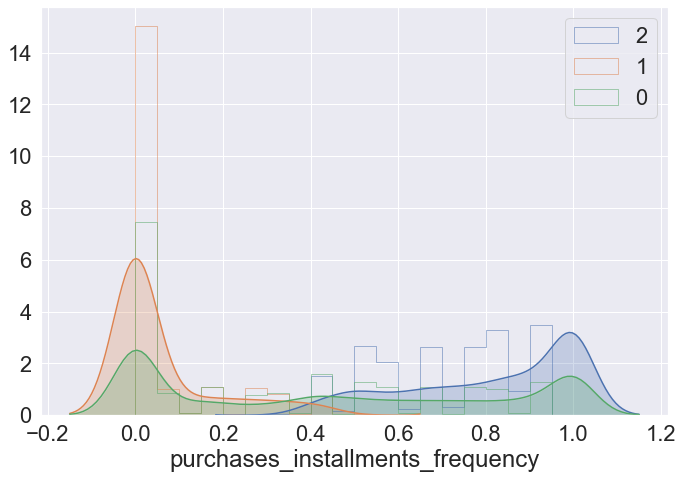

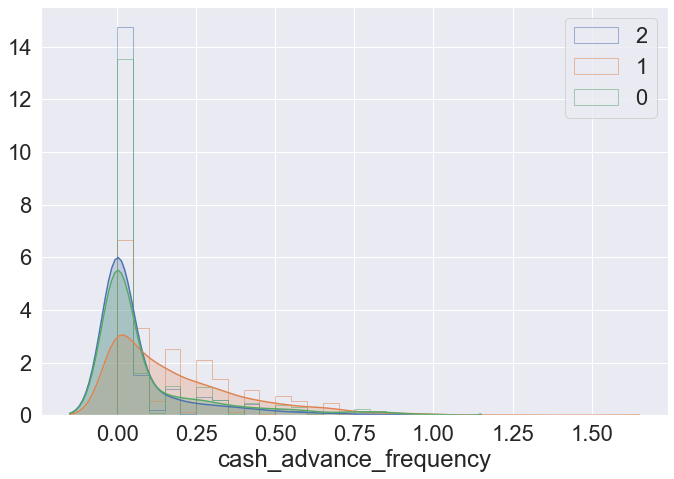

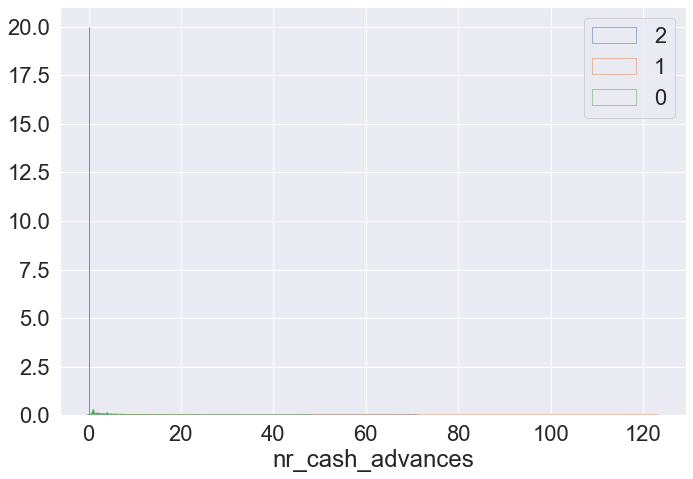

/Users/andrea/anaconda3/envs/propy_env/lib/python3.7/site-packages/numpy/lib/histograms.py:908: RuntimeWarning: invalid value encountered in true_divide
  return n/db/n.sum(), bin_edges


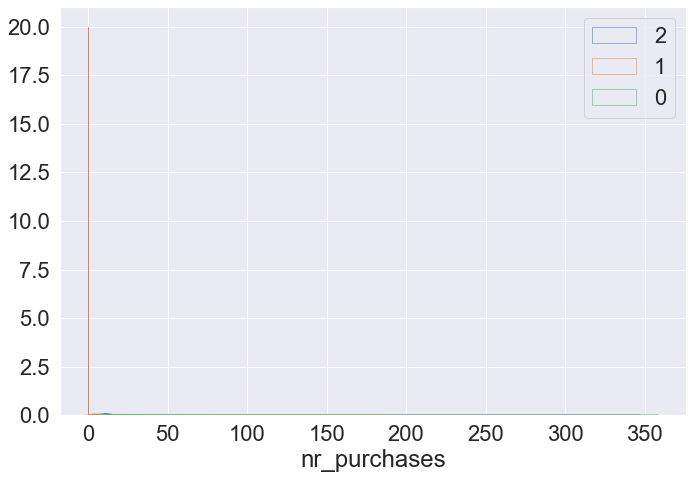

/Users/andrea/anaconda3/envs/propy_env/lib/python3.7/site-packages/numpy/lib/histograms.py:908: RuntimeWarning: invalid value encountered in true_divide
  return n/db/n.sum(), bin_edges
/Users/andrea/anaconda3/envs/propy_env/lib/python3.7/site-packages/numpy/lib/histograms.py:908: RuntimeWarning: invalid value encountered in true_divide
  return n/db/n.sum(), bin_edges
/Users/andrea/anaconda3/envs/propy_env/lib/python3.7/site-packages/numpy/lib/histograms.py:908: RuntimeWarning: invalid value encountered in true_divide
  return n/db/n.sum(), bin_edges


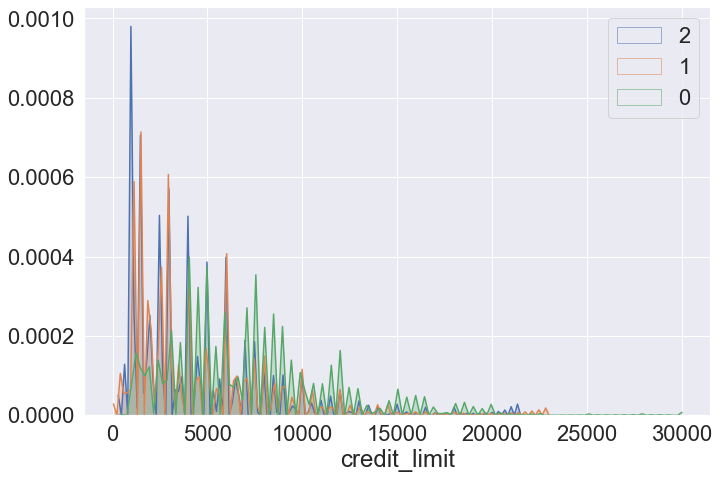

/Users/andrea/anaconda3/envs/propy_env/lib/python3.7/site-packages/numpy/lib/histograms.py:908: RuntimeWarning: invalid value encountered in true_divide
  return n/db/n.sum(), bin_edges
/Users/andrea/anaconda3/envs/propy_env/lib/python3.7/site-packages/numpy/lib/histograms.py:908: RuntimeWarning: invalid value encountered in true_divide
  return n/db/n.sum(), bin_edges
/Users/andrea/anaconda3/envs/propy_env/lib/python3.7/site-packages/numpy/lib/histograms.py:908: RuntimeWarning: invalid value encountered in true_divide
  return n/db/n.sum(), bin_edges


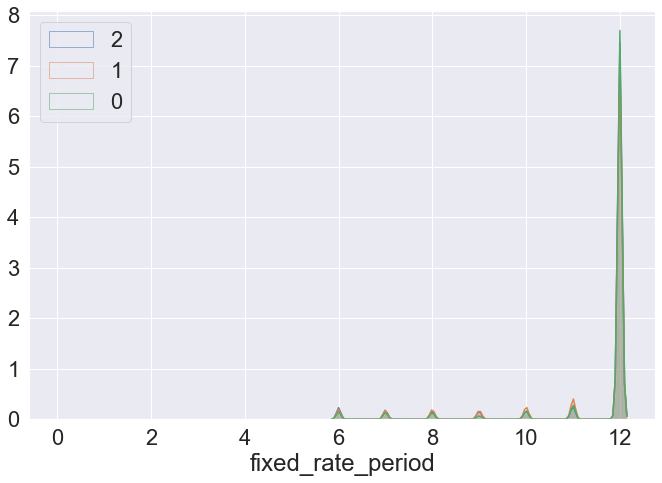

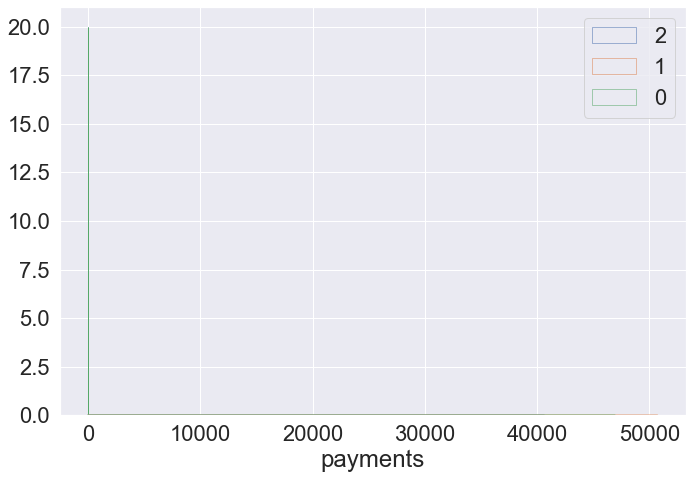

/Users/andrea/anaconda3/envs/propy_env/lib/python3.7/site-packages/numpy/lib/histograms.py:908: RuntimeWarning: invalid value encountered in true_divide
  return n/db/n.sum(), bin_edges


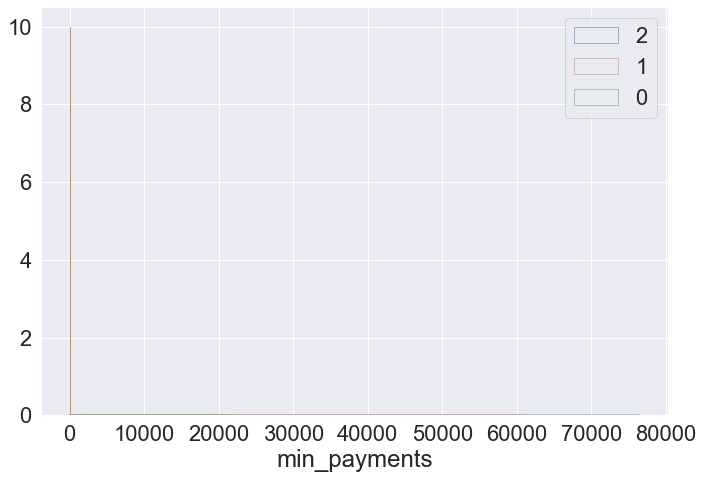

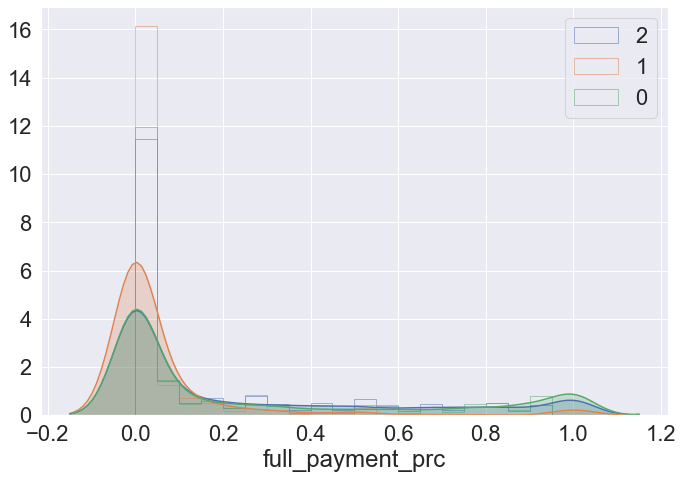

In [630]:
variables=data_pca_4_3cls.columns
data_pca_4_3cls['cluster'] = cluster_labels_pca_3
plot_numeric_distrib_sns(data_pca_4_3cls, variables, 'cluster', (10,7), '3clusters_pca_kmeans')

In [631]:
data_pca_4_3cls.head()

,balance_account,purchases_amount,paid_advance,full_purchases,balance_frequency_update,installments,purchases_frequency,full_purchases_frequency,purchases_installments_frequency,cash_advance_frequency,nr_cash_advances,nr_purchases,credit_limit,fixed_rate_period,payments,min_payments,full_payment_prc,cluster
0,9.298409,107.60,0.000000,0.00,0.909091,107.6,0.909091,0.000000,0.818182,0.000000,0.0,10.0,1000.0,11.0,89.868853,89.711672,0.428571,2
1,52.666422,150.30,0.000000,0.00,1.000000,150.3,1.000000,0.000000,0.833333,0.000000,0.0,6.0,1000.0,6.0,54.722514,82.955180,0.000000,2
2,1360.795674,0.00,462.861443,0.00,1.000000,0.0,0.000000,0.000000,0.000000,0.272727,6.0,0.0,1500.0,11.0,303.031979,443.781316,0.000000,1
3,2021.641161,363.18,0.000000,363.18,1.000000,0.0,1.000000,1.000000,0.000000,0.000000,0.0,13.0,2000.0,12.0,704.240770,795.859808,0.000000,0
4,22.322374,95.00,1162.045833,95.00,0.363636,0.0,0.083333,0.083333,0.000000,0.166667,3.0,1.0,2500.0,12.0,4094.261427,40.142262,0.000000,1
